In [60]:
import csv
import numpy as np
import pandas as pd
import os
import re
from dotenv import load_dotenv
from openai import OpenAI
from datasets import load_dataset
import openai
import matplotlib.pyplot as plt

load_dotenv()
openai.api_key = os.environ.get("REASONING_API_KEY")
if not openai.api_key:
    raise ValueError("API Key for OpenAI not set!")
client = OpenAI(api_key=os.environ.get("REASONING_API_KEY"))

Sandbox

In [2]:
def query_gpt(prompt, temp):
    message = [
    {"role": "system", "content": "You are a helpful assistant."},
    {"role": "user", "content": f"{prompt}"}

]
    response = client.chat.completions.create(
        model="gpt-3.5-turbo-0613",
        messages = message,
        max_tokens=1024,
        temperature=temp,
        n=1,
        stop=None,
    )

    return response.choices[0].message.content

In [3]:
import ast
df = pd.read_csv('data/112_gsm8k_gpt35_cot_responses_autograded.csv')
df['CoT Steps'] = df['CoT Steps'].apply(ast.literal_eval)
df['Paraphrased CoT Steps'] = df['Paraphrased CoT Steps'].apply(ast.literal_eval)
df.head(3)

,Problem Number,Question,Answer,CoT Response,CoT Sentences,CoT Steps,split,Paraphrased Question,Paraphrased CoT Steps,True Answer,Final Score
0,0,Natalia sold clips to 48 of her friends in Apr...,Natalia sold 48/2 = <<48/2=24>>24 clips in May...,"First, let's find out how many clips Natalia s...","**\nFirst, let's find out how many clips Natal...","[First, let's find out how many clips Natalia ...",train,Derek collected seashells from 48 of his frien...,"[First, we need to figure out the number of se...",72,1
1,1,Weng earns $12 an hour for babysitting. Yester...,Weng earns 12/60 = $<<12/60=0.2>>0.2 per minut...,"To find out how much Weng earned, we need to c...","**\nTo find out how much Weng earned, we need ...","[To find out how much Weng earned, we need to ...",train,Liam makes $12 per hour tutoring. He tutored f...,"[First, we need to figure out Liam's earnings ...",10,1
2,2,Betty is saving money for a new wallet which c...,"In the beginning, Betty has only 100 / 2 = $<<...","First, let's calculate how much money Betty ha...","**\nFirst, let's calculate how much money Bett...","[First, let's calculate how much money Betty h...",train,Oliver is collecting stickers for his album wh...,"[First, we need to figure out how many sticker...",5,1


In [8]:
prompt = f"Q: {df.Question.tolist()[0]}\nLet's think step by step.\nA:"
prompt 

"Q:Natalia sold clips to 48 of her friends in April, and then she sold half as many clips in May. How many clips did Natalia sell altogether in April and May?\nLet's think step by step.\nA:"

In [11]:
message = [
    {"role": "system", "content": "You are a helpful assistant."},
    {"role": "user", "content": f"{prompt}"}
]

In [12]:
response = client.chat.completions.create(
        model="gpt-3.5-turbo-0613",
        messages = message,
        max_tokens=1024,
        temperature=0.0,
        n=1,
        stop=None,
        logprobs=True,
        top_logprobs=5
    )

In [20]:
response.choices[0].message.content == df['CoT Response'].tolist()[0]

True

In [40]:
# response.choices[0].logprobs.content
len(response.choices[0].logprobs.content)

116

In [101]:
response.choices[0].logprobs.content[100].token

'Therefore'

In [37]:
import tiktoken

In [38]:
# gpt_enc = tiktoken.get_encoding("cl100k_base")
gpt_enc = tiktoken.encoding_for_model("gpt-3.5-turbo-0613")

In [41]:
gpt_output = df['CoT Response'].tolist()[0]
encoded_output = gpt_enc.encode(gpt_output)

In [42]:
len(encoded_output)

116

In [44]:
steps = df['CoT Steps'].tolist()[0]

In [50]:
total_tokens = 0
for i, step in enumerate(steps):
    encoded_step = gpt_enc.encode(step)
    print(f"step {i}: ", len(encoded_step), total_tokens)
    print("step: ", step)
    total_tokens += len(encoded_step)
print("total tokens: ", total_tokens)

step 0:  56 0
step:  First, let's find out how many clips Natalia sold in May. We know that she sold half as many clips in May as she did in April. So, if she sold 48 clips in April, she sold 48/2 = 24 clips in May.
step 1:  44 56
step:  To find out how many clips Natalia sold altogether in April and May, we add the number of clips she sold in April to the number of clips she sold in May.   48 + 24 = 72
step 2:  16 100
step:  Therefore, Natalia sold a total of 72 clips in April and May.
total tokens:  116


In [51]:
response.choices[0].logprobs.content[100].token

'Therefore'

In [69]:
from collections import namedtuple
TokenLogProb = namedtuple('TokenLogProb', ['token', 'logprob'])

tokens_and_logprobs = [TokenLogProb(entry.token, entry.logprob) for entry in response.choices[0].logprobs.content]


In [60]:
len(tokens_and_logprobs)

116

In [61]:
row = df.iloc[0]

In [70]:
split_indices = []
total_tokens = 0
for i, step in enumerate(row['CoT Steps']):
    print("cumulative tokens: ", total_tokens)
    encoded_step = gpt_enc.encode(step)


    print(f"step {i}: ", len(encoded_step))
    print("step: ", step)
    start_index = total_tokens
    print("step starting token: ", tokens_and_logprobs[start_index].token)
    
    total_tokens += len(encoded_step)
    end_index = total_tokens - 1
    split_indices.append((start_index, end_index))

    print("step ending token: ", tokens_and_logprobs[end_index].token)
print("total tokens: ", total_tokens)

cumulative tokens:  0
step 0:  56
step:  First, let's find out how many clips Natalia sold in May. We know that she sold half as many clips in May as she did in April. So, if she sold 48 clips in April, she sold 48/2 = 24 clips in May.
step starting token:  First
step ending token:  .


cumulative tokens:  56
step 1:  44
step:  To find out how many clips Natalia sold altogether in April and May, we add the number of clips she sold in April to the number of clips she sold in May.   48 + 24 = 72
step starting token:  To
step ending token:  


cumulative tokens:  100
step 2:  16
step:  Therefore, Natalia sold a total of 72 clips in April and May.
step starting token:  Therefore
step ending token:  .
total tokens:  116


In [71]:
split_indices

[(0, 55), (56, 99), (100, 115)]

In [72]:
def get_split_indices(cot_tokens_and_logprobs, cot_steps, tokenizer):
    split_indices = []
    token_sum = 0
    
    for step in cot_steps:
        start_index = token_sum
        encoded_step = tokenizer.encode(step)
        token_sum += len(encoded_step)
        end_index = token_sum - 1
        split_indices.append((start_index, end_index))
    return split_indices 

In [73]:
split_indices = get_split_indices(tokens_and_logprobs, row['CoT Steps'], gpt_enc)

[(0, 55), (56, 99), (100, 115)]

In [76]:
start_index, end_index = split_indices[1]
start_index, end_index

(56, 99)

In [80]:
cur_logprobs = np.array([tokens_and_logprobs[i].logprob for i in range(start_index, end_index + 1)])
cur_logprobs.mean()

-0.15604184993850906

In [81]:
log_probs_arr = [entry.logprob for entry in response.choices[0].logprobs.content]
len(log_probs_arr)

116

Michael Method

In [92]:
def get_segment_ends(cot_steps, tokenizer, expected_total):
    segment_ends = []
    token_sum = 0
    
    for step in cot_steps:
        encoded_step = tokenizer.encode(step)
        token_sum += len(encoded_step)
        segment_ends.append(token_sum)
    assert token_sum == expected_total, f"Wrong number of tokens in CoT Steps: expected {expected_total}, got {token_sum}"
    return segment_ends

In [98]:
log_probs_arr = np.array([entry.logprob for entry in response.choices[0].logprobs.content]) # length 116
segment_ends = get_segment_ends(row['CoT Steps'], gpt_enc, len(tokens_and_logprobs)) # [56, 100, 116]
start = 0
segment_means = []

for end in segment_ends:
    segment_log_probs = log_probs_arr[start : end]
    segment_means.append(segment_log_probs.mean())
    print(f'Mean log prob for segment from {start} to {end}: {segment_log_probs.mean()}')
    start = end

Mean log prob for segment from 0 to 56: -0.12730754615481965
Mean log prob for segment from 56 to 100: -0.15604184993850906
Mean log prob for segment from 100 to 116: -0.0515566346777875


Applying to Full Dataset

In [ ]:
response = client.chat.completions.create(
        model="gpt-3.5-turbo-0613",
        messages = message,
        max_tokens=1024,
        temperature=0.0,
        n=1,
        stop=None,
        logprobs=True,
        top_logprobs=5
    )

In [2]:
df = pd.read_csv('data/112_gsm8k_gpt35_cot_responses_autograded.csv')
df.head()

,Problem Number,Question,Answer,CoT Response,CoT Sentences,CoT Steps,split,Paraphrased Question,Paraphrased CoT Steps,True Answer,Final Score
0,0,Natalia sold clips to 48 of her friends in Apr...,Natalia sold 48/2 = <<48/2=24>>24 clips in May...,"First, let's find out how many clips Natalia s...","**\nFirst, let's find out how many clips Natal...","[""First, let's find out how many clips Natalia...",train,Derek collected seashells from 48 of his frien...,"['First, we need to figure out the number of s...",72,1
1,1,Weng earns $12 an hour for babysitting. Yester...,Weng earns 12/60 = $<<12/60=0.2>>0.2 per minut...,"To find out how much Weng earned, we need to c...","**\nTo find out how much Weng earned, we need ...","['To find out how much Weng earned, we need to...",train,Liam makes $12 per hour tutoring. He tutored f...,"[""First, we need to figure out Liam's earnings...",10,1
2,2,Betty is saving money for a new wallet which c...,"In the beginning, Betty has only 100 / 2 = $<<...","First, let's calculate how much money Betty ha...","**\nFirst, let's calculate how much money Bett...","[""First, let's calculate how much money Betty ...",train,Oliver is collecting stickers for his album wh...,"['First, we need to figure out how many sticke...",5,1
3,3,"Julie is reading a 120-page book. Yesterday, s...",Maila read 12 x 2 = <<12*2=24>>24 pages today....,"First, let's find out how many pages Julie has...","**\nFirst, let's find out how many pages Julie...","[""First, let's find out how many pages Julie h...",train,Carlos is painting a fence that has 120 panels...,"['First, we need to calculate the number of pa...",42,1
4,4,James writes a 3-page letter to 2 different fr...,He writes each friend 3*2=<<3*2=6>>6 pages a w...,"First, let's calculate how many letters James ...","**\nFirst, let's calculate how many letters Ja...","[""First, let's calculate how many letters Jame...",train,Olivia plants 3 flowers in each of 2 different...,"['First, we need to figure out how many times ...",624,1


In [15]:
df['CoT Response 2'] = None
df['logprobs'] = None

In [30]:
def get_cot_response_info(row):
    prompt = f"Q: {row['Question']}\nA: Let's think step by step."
    message = [
        {"role": "system", "content": "You are a helpful assistant."},
        {"role": "user", "content": f"{prompt}"}
    ]
    response = client.chat.completions.create(
        model="gpt-3.5-turbo-0613",
        messages = message,
        max_tokens=1024,
        temperature=0.0,
        n=1,
        stop=None,
        logprobs=True,
        top_logprobs=5
    )
    logprobs = [entry.logprob for entry in response.choices[0].logprobs.content]
    tokens = [entry.token for entry in response.choices[0].logprobs.content]
    response_text = response.choices[0].message.content
    return response_text, logprobs, tokens, response


In [5]:
test_row = df.iloc[0]

In [12]:
test_text, test_logprobs = get_cot_response_info(test_row)

In [33]:
# df['CoT Response 2'] = None
# df['logprobs'] = None
# df['tokens'] = None
# df['api_response'] = None

# for idx, row in df.iterrows():
#     print(idx)
#     response_text, logprobs, tokens, response = get_cot_response_info(row)
#     df.at[idx, 'CoT Response 2'] = response_text
#     df.at[idx, 'logprobs'] = logprobs
#     df.at[idx, 'tokens'] = tokens
#     df.at[idx, 'api_response'] = response

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112


In [35]:
df

,Problem Number,Question,Answer,CoT Response,CoT Sentences,CoT Steps,split,Paraphrased Question,Paraphrased CoT Steps,True Answer,Final Score,CoT Response 2,logprobs,tokens,api_response
0,0,Natalia sold clips to 48 of her friends in Apr...,Natalia sold 48/2 = <<48/2=24>>24 clips in May...,"First, let's find out how many clips Natalia s...","**\nFirst, let's find out how many clips Natal...","[""First, let's find out how many clips Natalia...",train,Derek collected seashells from 48 of his frien...,"['First, we need to figure out the number of s...",72,1,"In April, Natalia sold clips to 48 friends. \n...","[-0.1291976, -0.00031806578, -0.000602715, -0....","[In, April, ,, Natal, ia, sold, clips, to...",ChatCompletion(id='chatcmpl-91nJqookKzsoRSnZIN...
1,1,Weng earns $12 an hour for babysitting. Yester...,Weng earns 12/60 = $<<12/60=0.2>>0.2 per minut...,"To find out how much Weng earned, we need to c...","**\nTo find out how much Weng earned, we need ...","['To find out how much Weng earned, we need to...",train,Liam makes $12 per hour tutoring. He tutored f...,"[""First, we need to figure out Liam's earnings...",10,1,"First, we need to convert the 50 minutes into ...","[-0.35689792, -0.0009994634, -0.37169525, -0.0...","[First, ,, we, need, to, convert, the, ,...",ChatCompletion(id='chatcmpl-91nJtqHb47BwX4XQfg...
2,2,Betty is saving money for a new wallet which c...,"In the beginning, Betty has only 100 / 2 = $<<...","First, let's calculate how much money Betty ha...","**\nFirst, let's calculate how much money Bett...","[""First, let's calculate how much money Betty ...",train,Oliver is collecting stickers for his album wh...,"['First, we need to figure out how many sticke...",5,1,"First, let's calculate how much money Betty ha...","[-0.53395826, -0.0011852304, -0.3187719, -0.00...","[First, ,, let, 's, calculate, how, much, ...",ChatCompletion(id='chatcmpl-91nJwxRcorbrtebuXS...
3,3,"Julie is reading a 120-page book. Yesterday, s...",Maila read 12 x 2 = <<12*2=24>>24 pages today....,"First, let's find out how many pages Julie has...","**\nFirst, let's find out how many pages Julie...","[""First, let's find out how many pages Julie h...",train,Carlos is painting a fence that has 120 panels...,"['First, we need to calculate the number of pa...",42,1,"Yesterday, Julie read 12 pages. Today, she rea...","[-0.78472316, -0.05665855, -0.0022256682, -0.0...","[Yesterday, ,, Julie, read, , 12, pages, ....",ChatCompletion(id='chatcmpl-91nKKE3xkxJV7T1q7i...
4,4,James writes a 3-page letter to 2 different fr...,He writes each friend 3*2=<<3*2=6>>6 pages a w...,"First, let's calculate how many letters James ...","**\nFirst, let's calculate how many letters Ja...","[""First, let's calculate how many letters Jame...",train,Olivia plants 3 flowers in each of 2 different...,"['First, we need to figure out how many times ...",624,1,"First, let's calculate how many pages James wr...","[-0.63131994, -0.0006122403, -0.16098239, -0.0...","[First, ,, let, 's, calculate, how, many, ...",ChatCompletion(id='chatcmpl-91nKhYEsyVUiDcmUDn...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
108,108,Simon wanted to buy flowers that his mom could...,5 pansies at $2.50 each is 5*2.50 = $<<5*2.5=1...,"First, let's calculate the total cost of the f...","**\nFirst, let's calculate the total cost of t...","[""First, let's calculate the total cost of the...",val,Oliver decided to purchase books for his siste...,"['First, we need to figure out the total price...",23,1,"First, let's calculate the total cost of the f...","[-0.2553568, -0.0006794308, -0.062416997, -0.0...","[First, ,, let, 's, calculate, the, total,...",ChatCompletion(id='chatcmpl-91ny7cAy0cRGjkVyQD...
109,109,Derek has $960 to buy his books for the semest...,Amount spent on textbooks is 960/2 = <<960/2=4...,"First, let's calculate how much Derek spends o...","**\nFirst, let's calculate how much Derek spen...","[""First, let's calculate how much Derek spends...",val,Ava has $960 to spend 

In [36]:
df.to_csv('data/112_gsm8k_gpt35_cot_responses_logprobs.csv', index=False)

In [37]:
import matplotlib.pyplot as plt

def plot_tokenLevelLogProbs(logProbs, tokens, stepIndices = None):
    negativeLogProbs = [-x for x in logProbs]
    plt.figure(figsize=(10, 6))
    plt.plot(negativeLogProbs, marker = 'o', linestyle = '-', color = 'b')
    if stepIndices != None:
        for index in stepIndices:
            plt.axvline(x=index, color='r', linestyle = ':')
    plt.xlabel("Token Timestep")
    plt.ylabel("Surprisal")
    plt.title("Surprisal for Chain-of-Thought Reasoning Trace")
    plt.grid(True)
    plt.show()

In [23]:
i = 2
print(df['CoT Response 2'].tolist()[i])

First, let's calculate how much money Betty has saved so far. We know that she has only half of the money she needs, so half of $100 is $100/2 = $50.

Next, let's calculate how much money Betty's grandparents gave her. We know that her grandparents gave her twice as much as her parents, so $15 x 2 = $30.

Now, let's add up all the money Betty has saved. Betty has $50 + $15 + $30 = $95.

Finally, let's calculate how much more money Betty needs to buy the wallet. The wallet costs $100 and Betty has saved $95, so she still needs $100 - $95 = $5 more.

Therefore, Betty needs $5 more to buy the wallet.


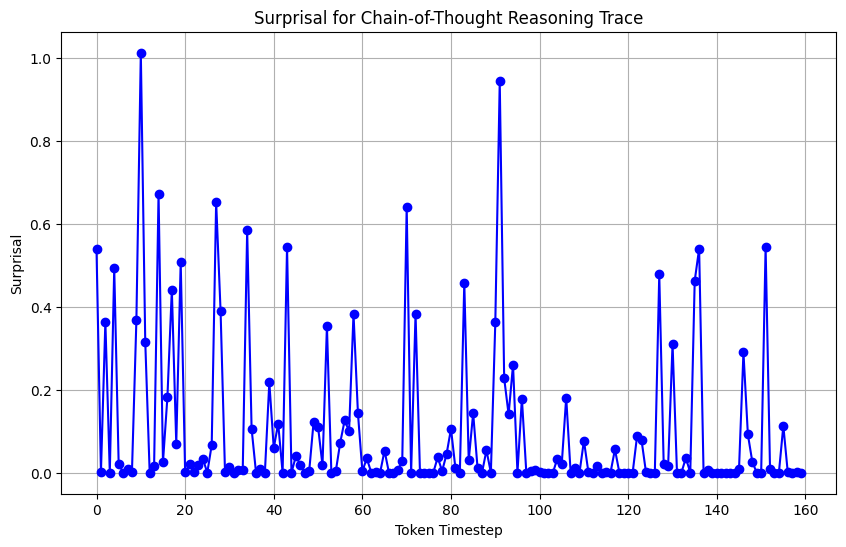

In [24]:
plot_tokenLevelLogProbs(df['logprobs'].tolist()[i])

In [72]:
def plot_tokenLevelLogProbs(logProbs, tokens, stepIndices=None, color='dodgerblue'):
    negativeLogProbs = [-x for x in logProbs]
    # width = len(logProbs) // 3
    width = 20
    plt.figure(figsize=(width, 6))
    plt.plot(negativeLogProbs, marker='o', linestyle='-', color=color)

    # Annotate each data point with its corresponding token name
    for i, token in enumerate(tokens):
        plt.annotate(token, (i, negativeLogProbs[i]), textcoords="offset points", xytext=(0, 10), ha='center')

    if stepIndices is not None:
        for index in stepIndices:
            plt.axvline(x=index, color='r', linestyle=':')

    plt.xlabel("Token Timestep")
    plt.ylabel("Surprisal")
    plt.title("Per-token Surprisal for Chain-of-Thought Reasoning Trace (GPT 3.5 Zero Shot)")
    plt.grid(True)
    plt.show()

# i = 0
# plot_tokenLevelLogProbs(df['logprobs'].tolist()[i], df['tokens'].tolist()[i])

In [57]:
row = df.iloc[18]

In [63]:
print("QUESTION: ", row['Question'])
print("RESPONSE: ")
print(row['CoT Response 2'])

QUESTION:  Ann's favorite store was having a summer clearance. For $75 she bought 5 pairs of shorts for $7 each and 2 pairs of shoes for $10 each. She also bought 4 tops, all at the same price. How much did each top cost?
RESPONSE: 
First, let's calculate the total cost of the shorts. Ann bought 5 pairs of shorts for $7 each, so the total cost of the shorts is 5 * $7 = $<<5*7=35>>35.

Next, let's calculate the total cost of the shoes. Ann bought 2 pairs of shoes for $10 each, so the total cost of the shoes is 2 * $10 = $<<2*10=20>>20.

Now, let's calculate the total cost of the shorts and shoes. The total cost of the shorts and shoes is $35 + $20 = $<<35+20=55>>55.

Since Ann spent a total of $75, we can subtract the cost of the shorts and shoes from $75 to find the cost of the tops. $75 - $55 = $<<75-55=20>>20.

Since Ann bought 4 tops, we can divide the cost of the tops by 4 to find the cost of each top. $20 / 4 = $<<20/4=5>>5.

Therefore, each top cost $5.


In [62]:
p18_response = row['api_response']

In [66]:
p18_response.choices[0].logprobs.content[0].top_logprobs

[TopLogprob(token='First', bytes=[70, 105, 114, 115, 116], logprob=-0.29517615),
 TopLogprob(token='Sure', bytes=[83, 117, 114, 101], logprob=-1.7522532),
 TopLogprob(token='To', bytes=[84, 111], logprob=-3.1056504),
 TopLogprob(token='Ann', bytes=[65, 110, 110], logprob=-4.341515),
 TopLogprob(token='Step', bytes=[83, 116, 101, 112], logprob=-4.7025247)]

In [67]:
p18_response.choices[0].logprobs.content[96].top_logprobs

[TopLogprob(token='Now', bytes=[78, 111, 119], logprob=-0.530998),
 TopLogprob(token='To', bytes=[84, 111], logprob=-1.6802213),
 TopLogprob(token='The', bytes=[84, 104, 101], logprob=-1.8576047),
 TopLogprob(token='We', bytes=[87, 101], logprob=-3.5684507),
 TopLogprob(token='Finally', bytes=[70, 105, 110, 97, 108, 108, 121], logprob=-4.688202)]

In [68]:
p18_response.choices[0].logprobs.content[135].top_logprobs

[TopLogprob(token='Since', bytes=[83, 105, 110, 99, 101], logprob=-0.7098669),
 TopLogprob(token='Finally', bytes=[70, 105, 110, 97, 108, 108, 121], logprob=-1.6613935),
 TopLogprob(token='We', bytes=[87, 101], logprob=-1.7154363),
 TopLogprob(token='Ann', bytes=[65, 110, 110], logprob=-2.6888251),
 TopLogprob(token='Lastly', bytes=[76, 97, 115, 116, 108, 121], logprob=-3.4191184)]

In [73]:
p18_response.choices[0].logprobs.content[57].top_logprobs

[TopLogprob(token=' the', bytes=[32, 116, 104, 101], logprob=-2.0935051e-05),
 TopLogprob(token=' shoes', bytes=[32, 115, 104, 111, 101, 115], logprob=-10.820673),
 TopLogprob(token=' ', bytes=[32], logprob=-14.187624),
 TopLogprob(token=' two', bytes=[32, 116, 119, 111], logprob=-16.044735),
 TopLogprob(token=' her', bytes=[32, 104, 101, 114], logprob=-17.301683)]

In [55]:
for i in range(len(df)):
    print("PROBLEM ", i)
    print(df['CoT Response 2'].tolist()[i])
    print()

PROBLEM  0
In April, Natalia sold clips to 48 friends. 
In May, she sold half as many clips as in April. 
So, in May, she sold 48/2 = 24 clips. 
To find the total number of clips sold in April and May, we add the number of clips sold in each month: 
48 + 24 = 72. 
Therefore, Natalia sold a total of 72 clips in April and May.

PROBLEM  1
First, we need to convert the 50 minutes into hours. Since there are 60 minutes in an hour, we divide 50 by 60 to get 0.83 hours.

Next, we multiply the number of hours (0.83) by the hourly rate ($12) to find the total earnings. 

0.83 hours * $12/hour = $9.96

Therefore, Weng earned $9.96 for 50 minutes of babysitting.

PROBLEM  2
First, let's calculate how much money Betty has saved so far. We know that she has only half of the money she needs, so half of $100 is $50.

Next, let's calculate how much money Betty's grandparents gave her. We know that her grandparents gave her twice as much as her parents, so $15 x 2 = $30.

Now, let's add up all the mon

0


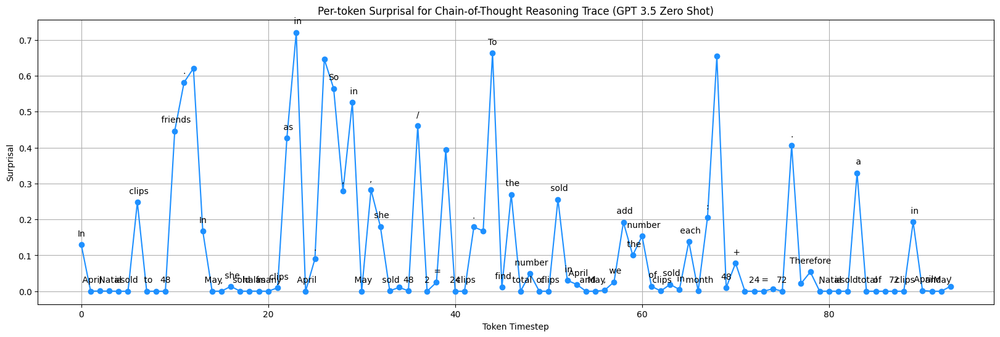

1


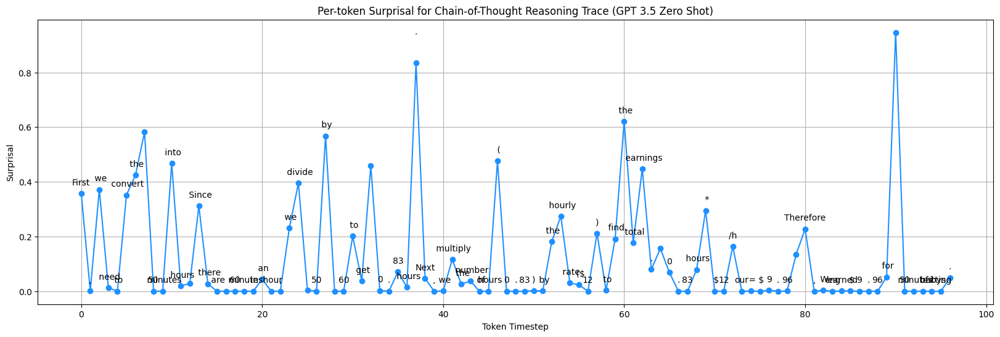

2


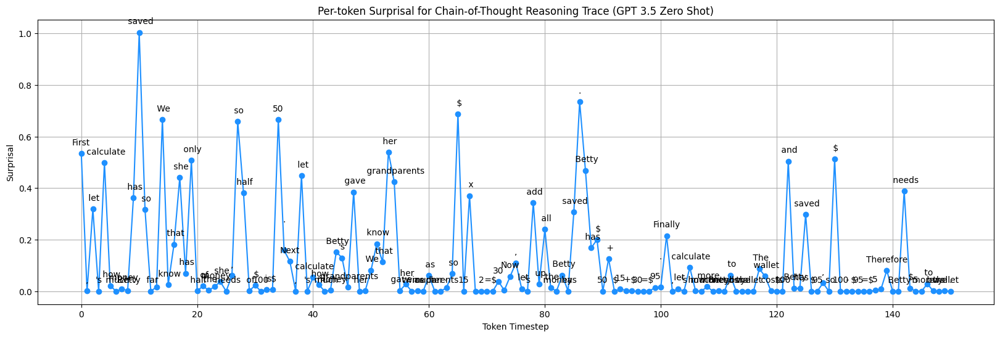

3


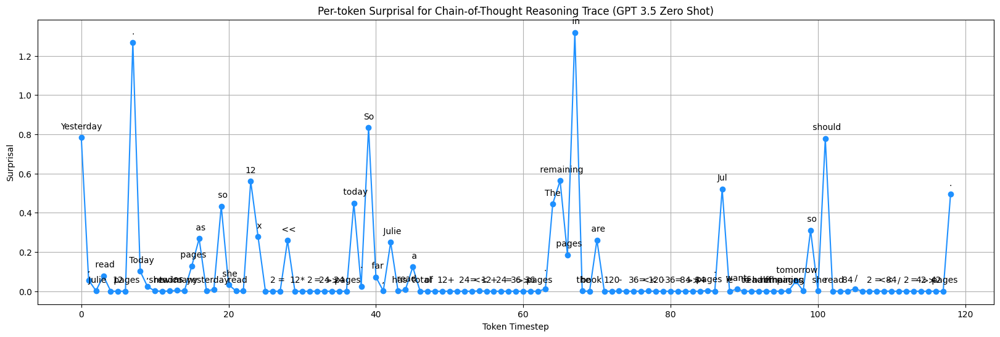

4


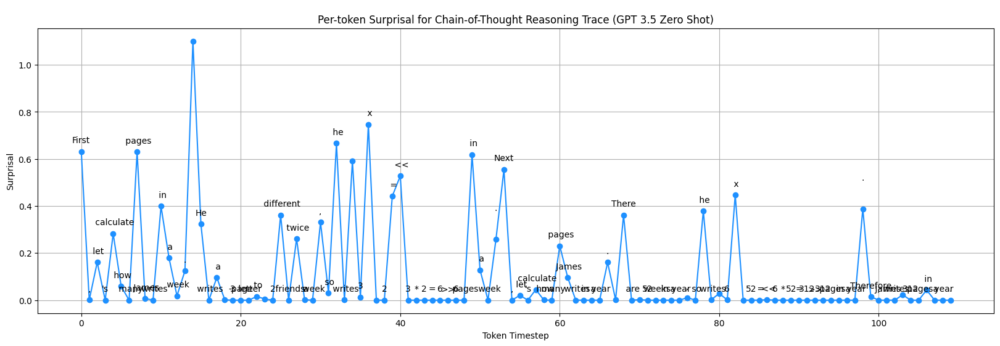

5


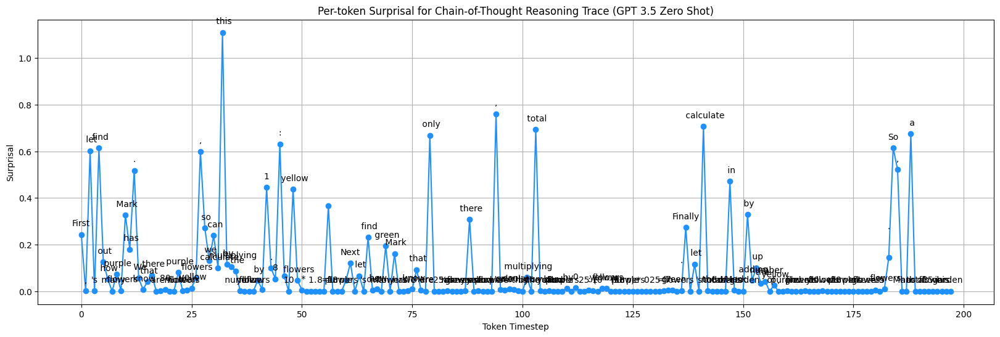

6


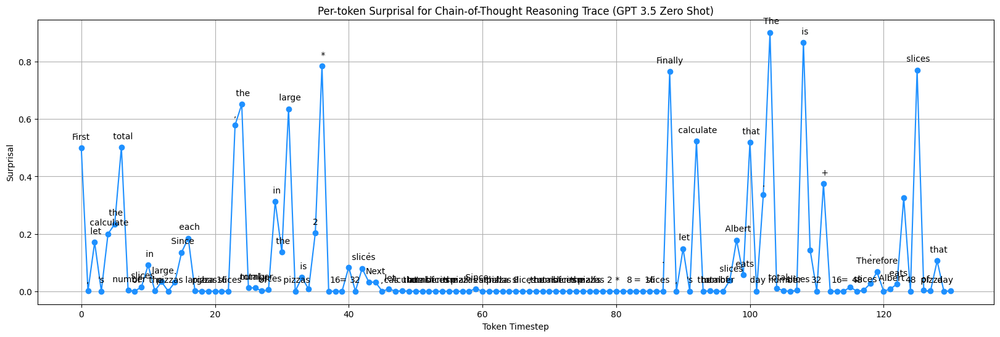

7


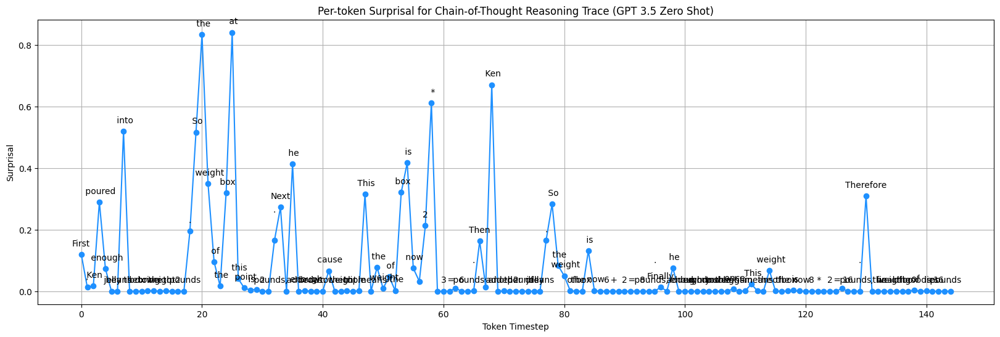

8


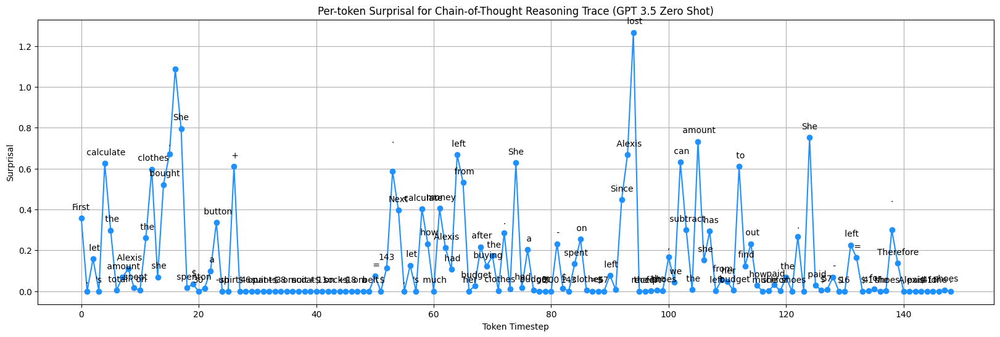

9


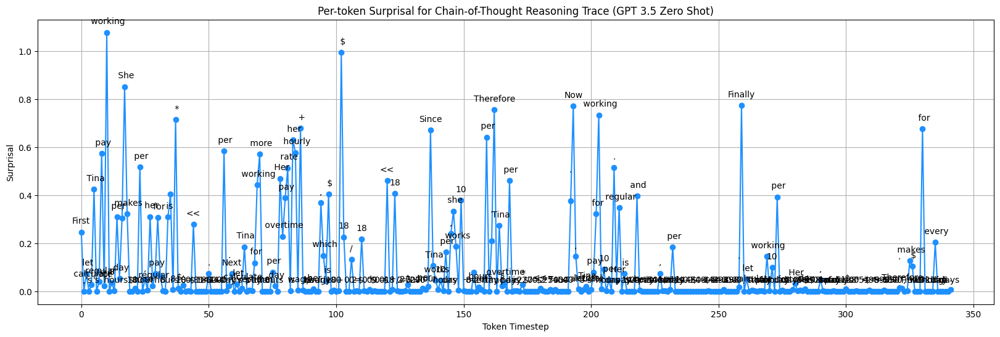

10


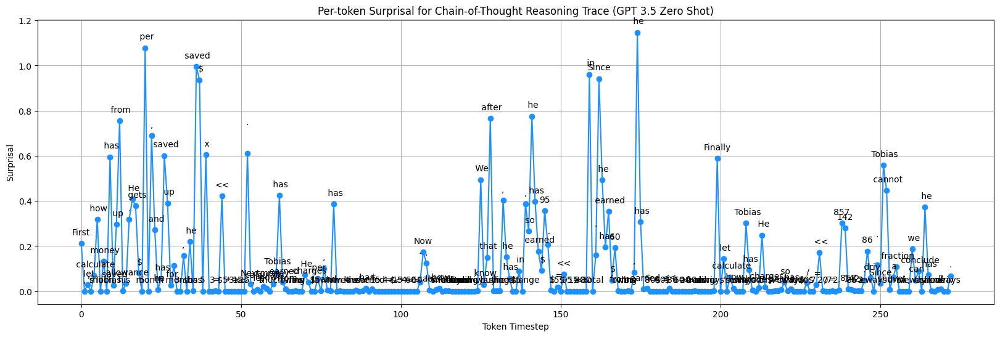

11


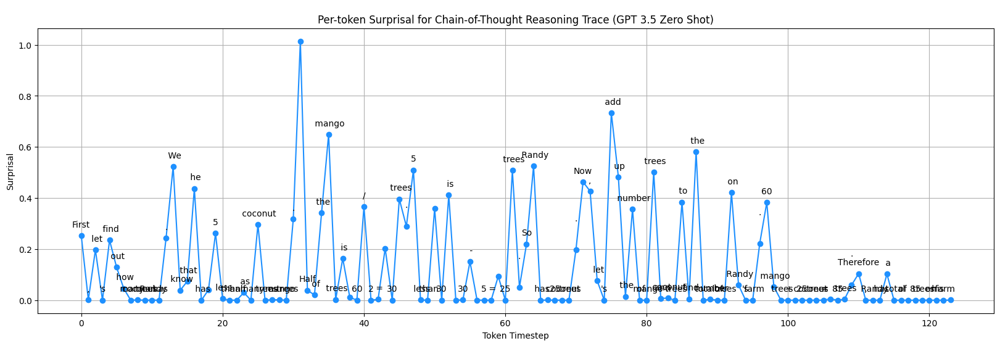

12


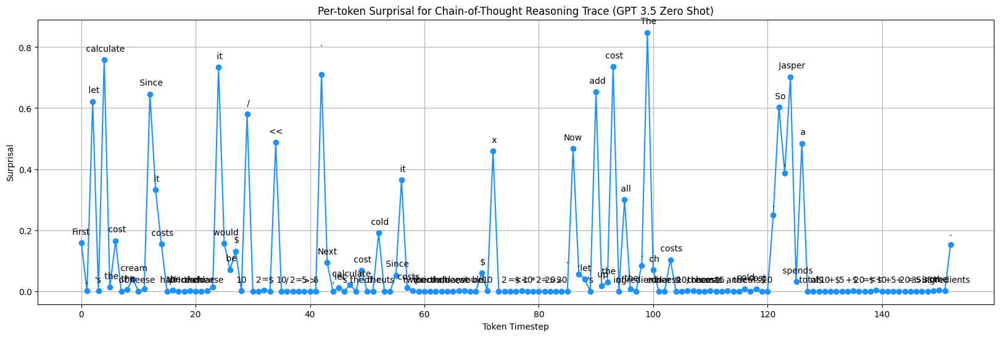

13


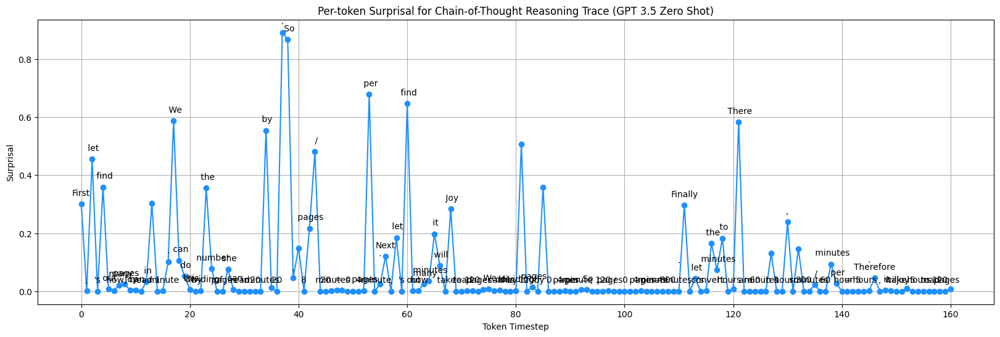

14


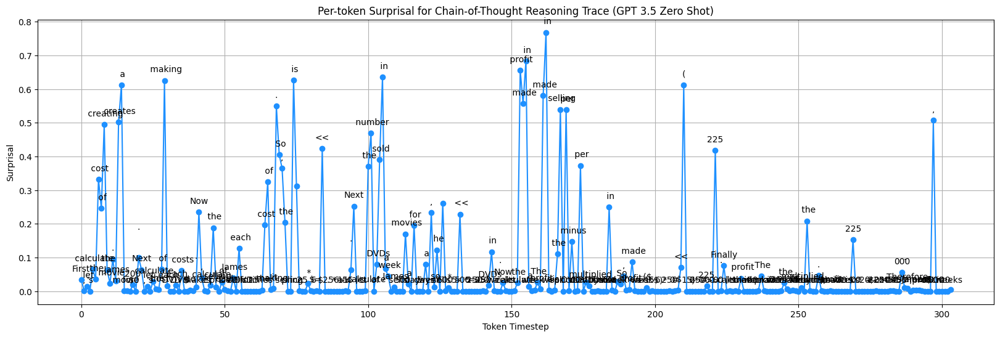

15


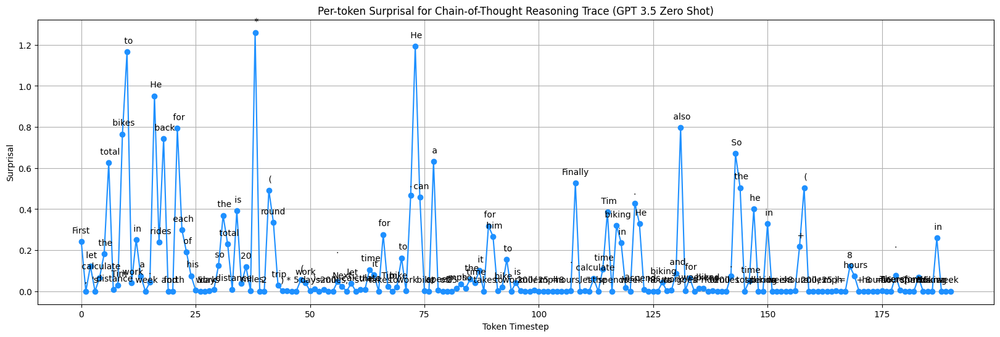

16


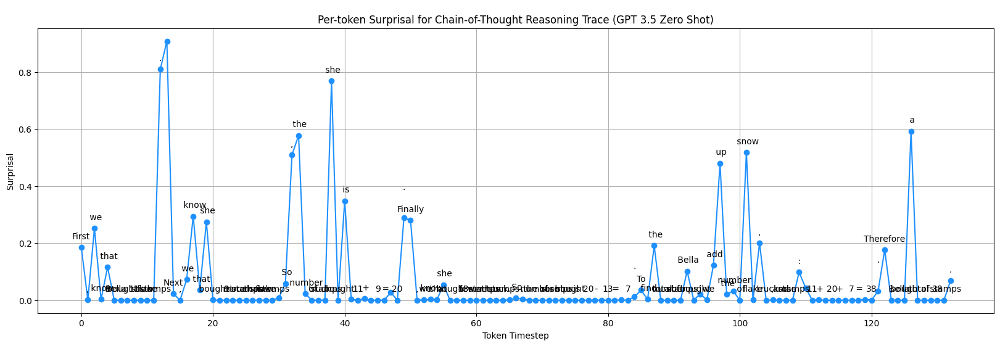

17


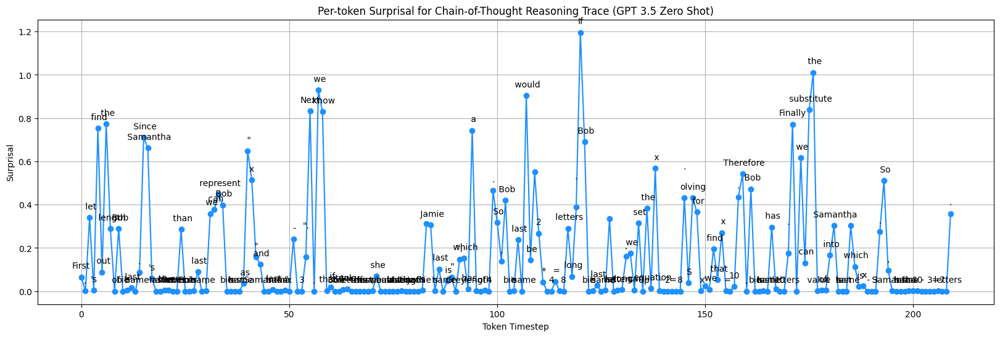

18


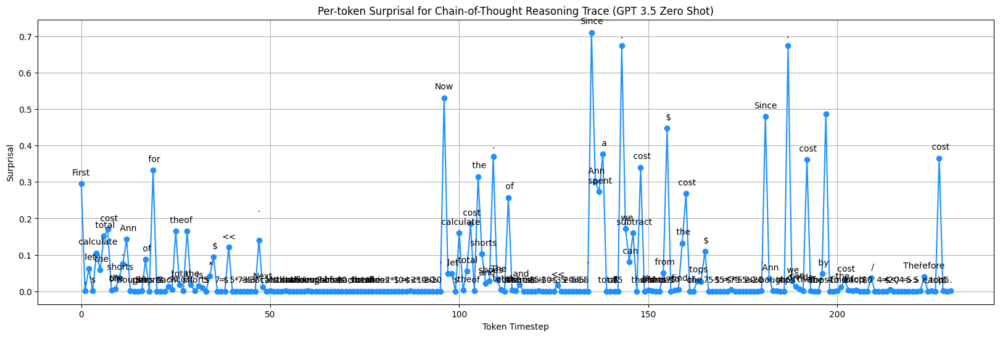

19


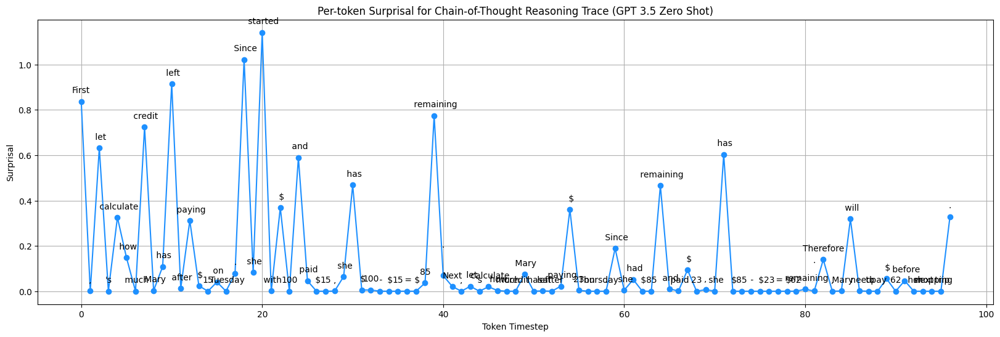

20


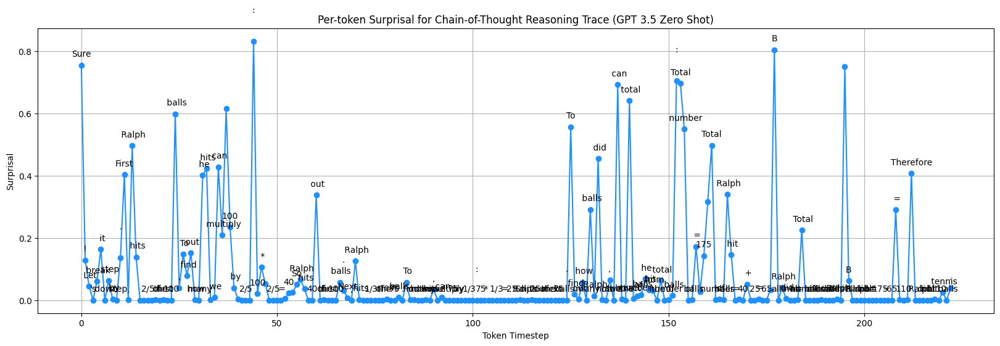

21


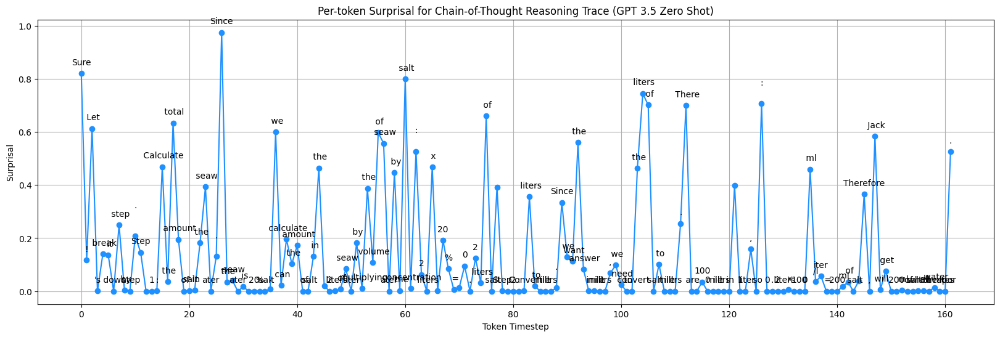

22


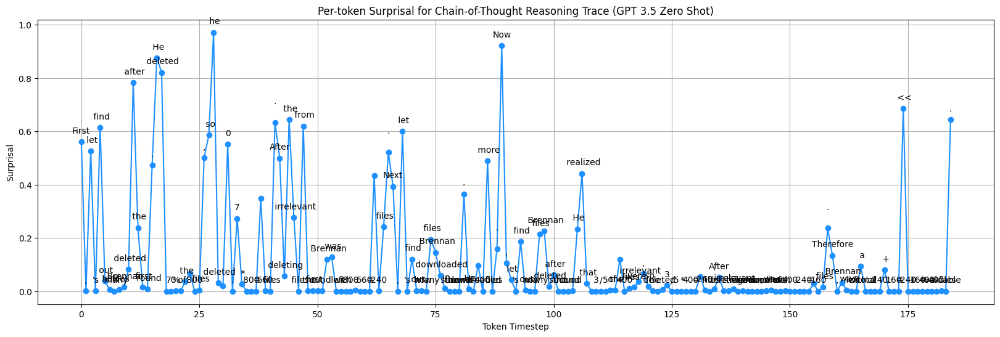

23


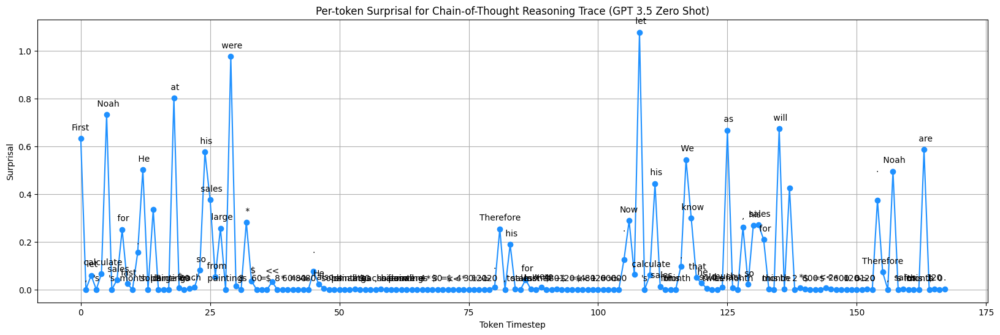

24


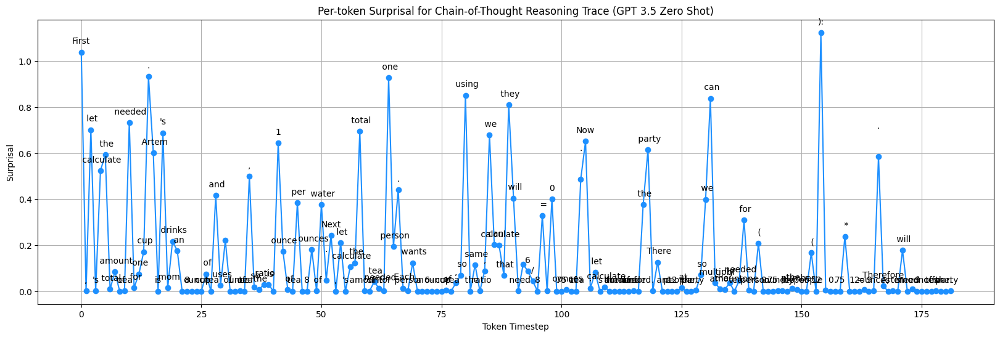

25


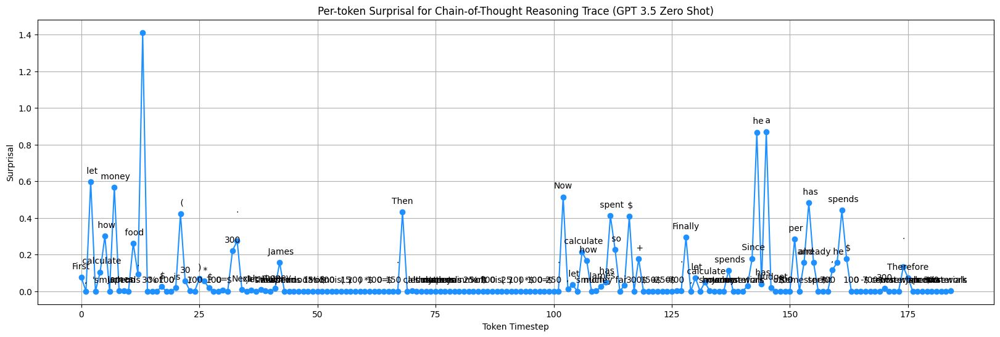

26


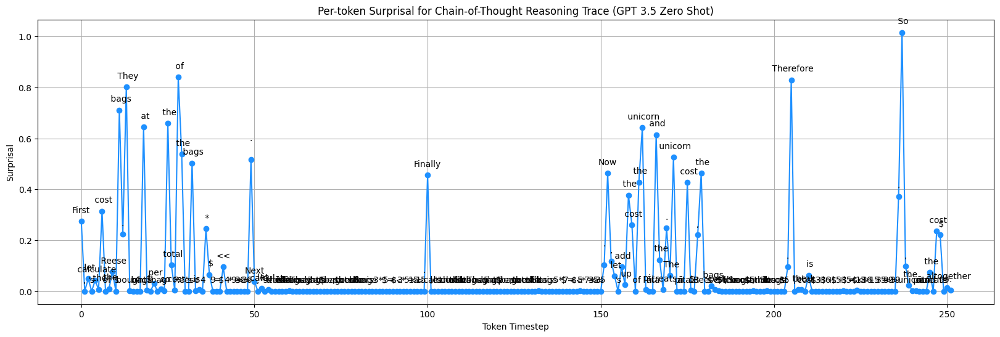

27


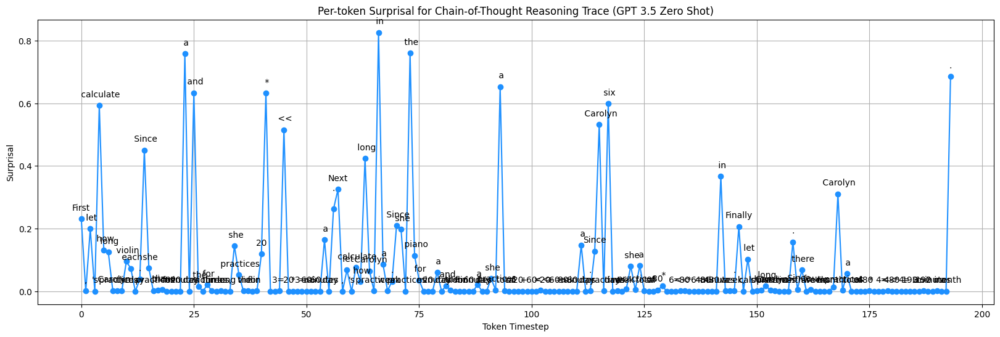

28


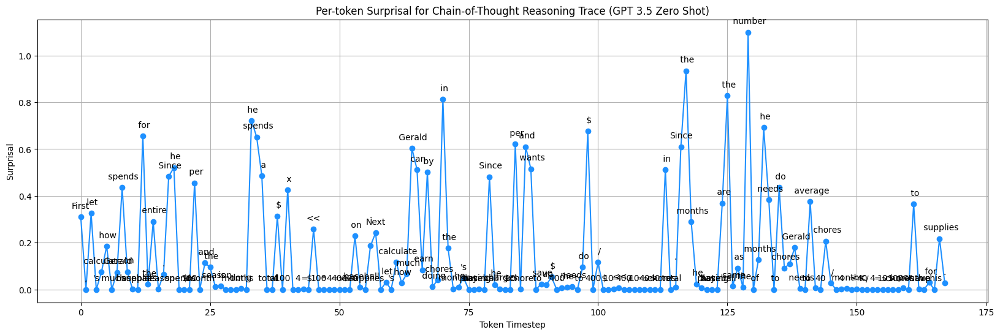

29


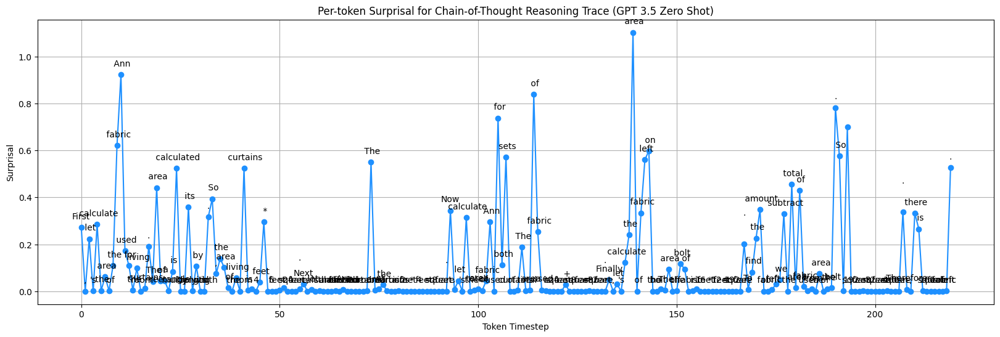

30


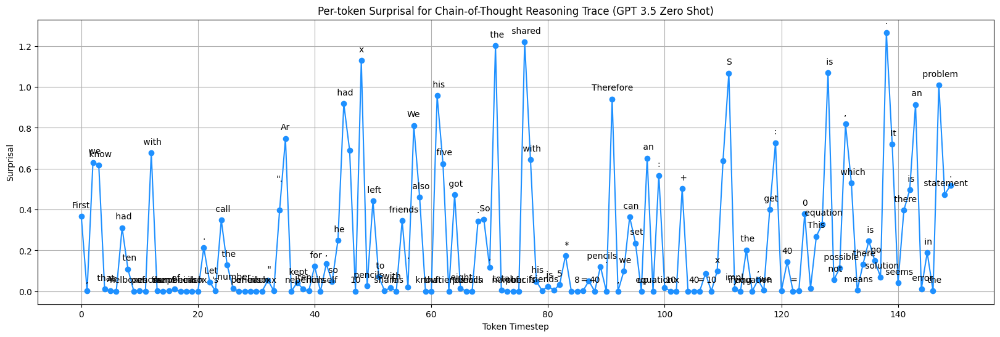

31


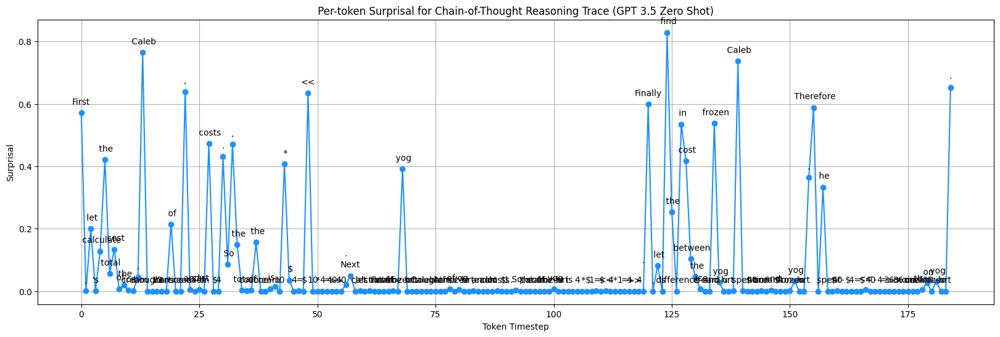

32


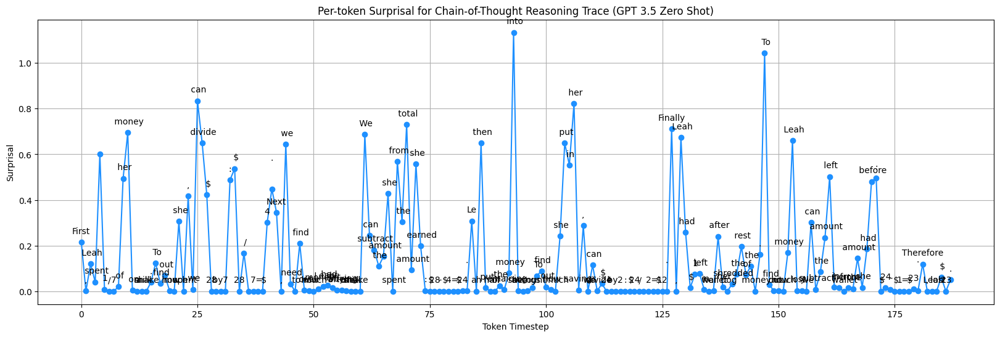

33


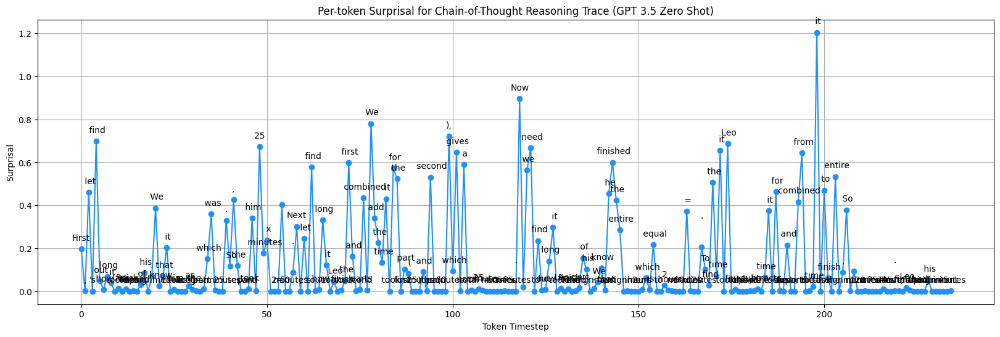

34


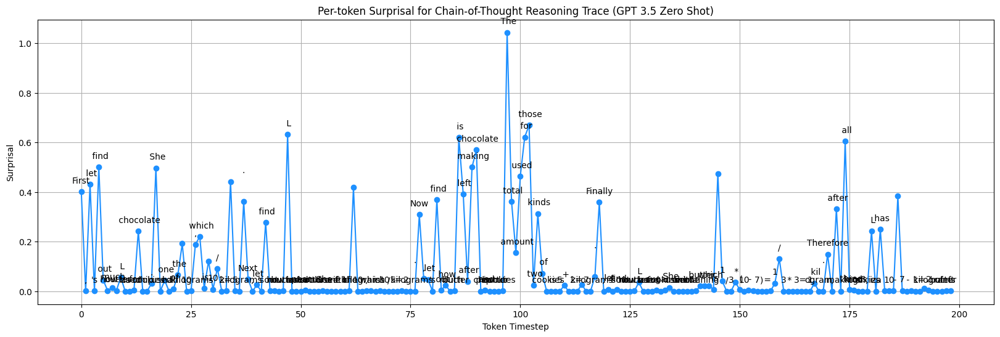

35


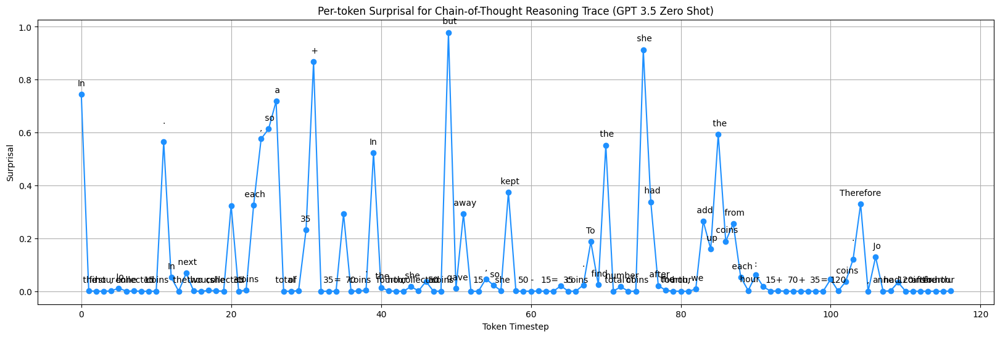

36


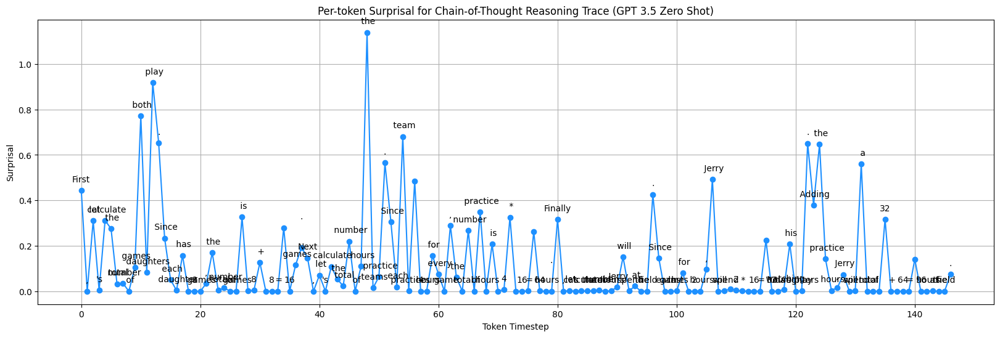

37


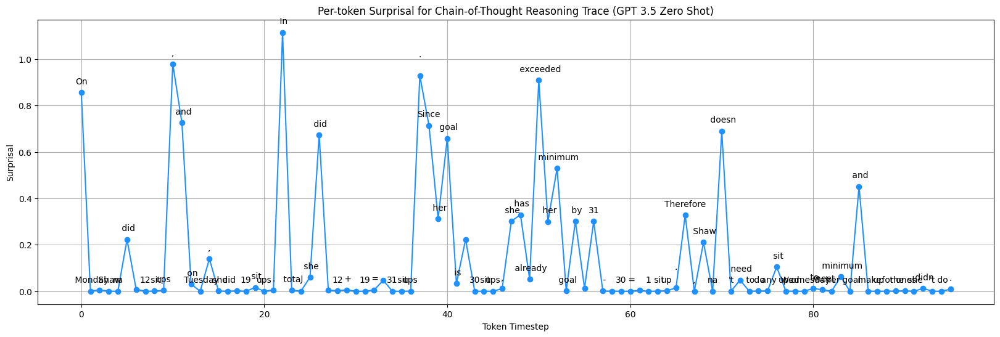

38


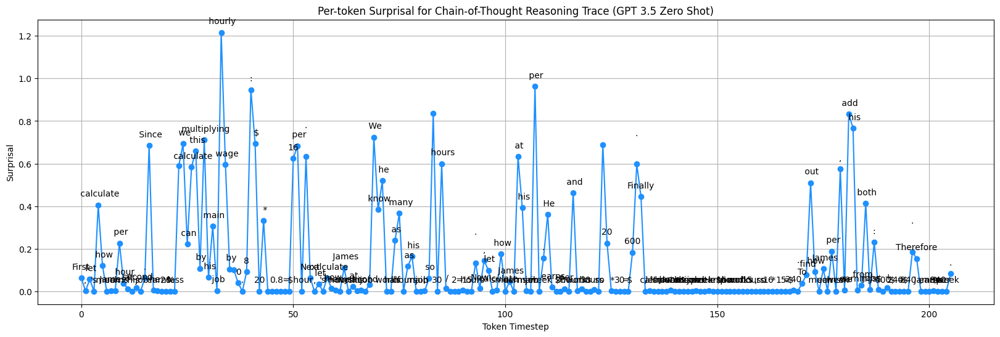

39


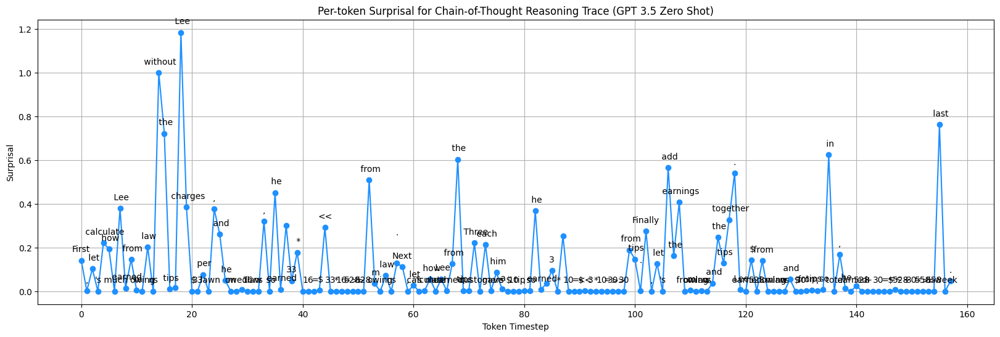

40


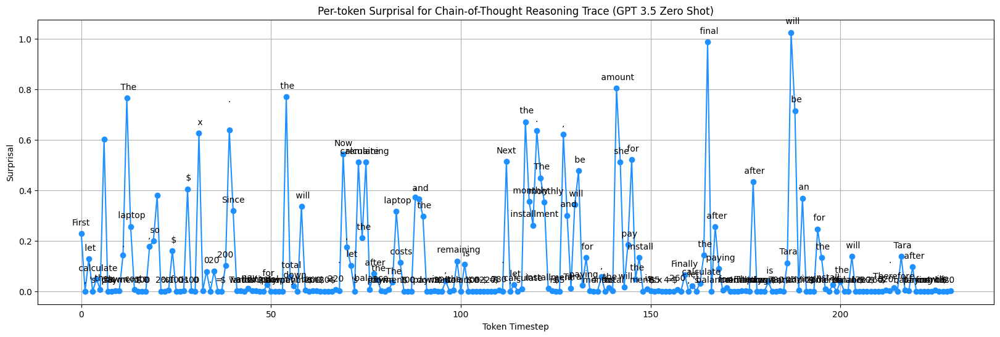

41


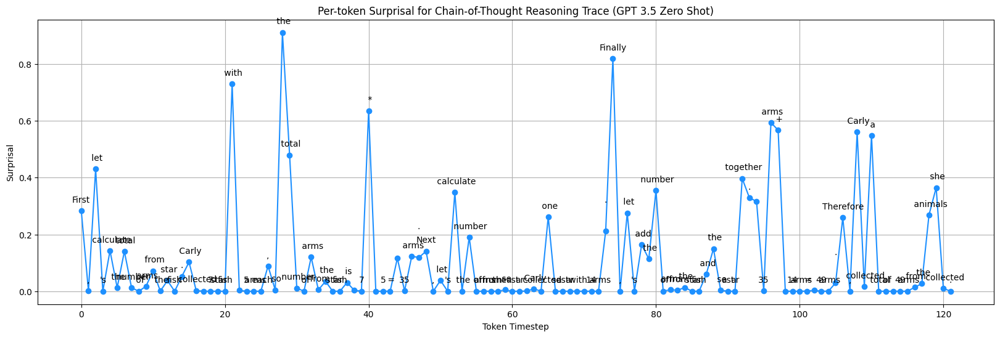

42


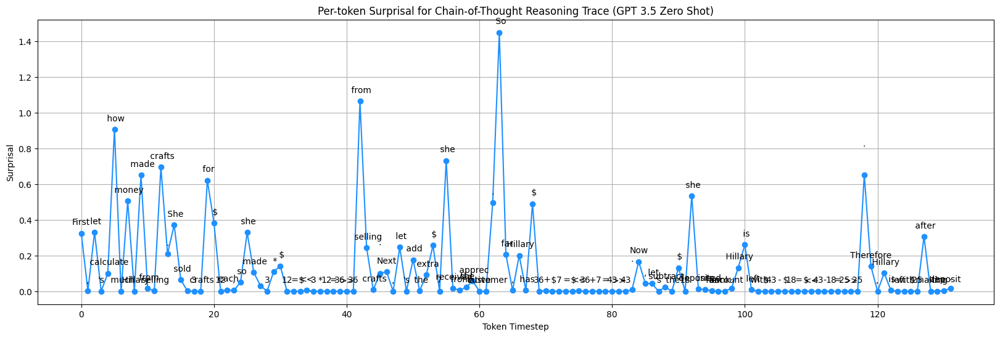

43


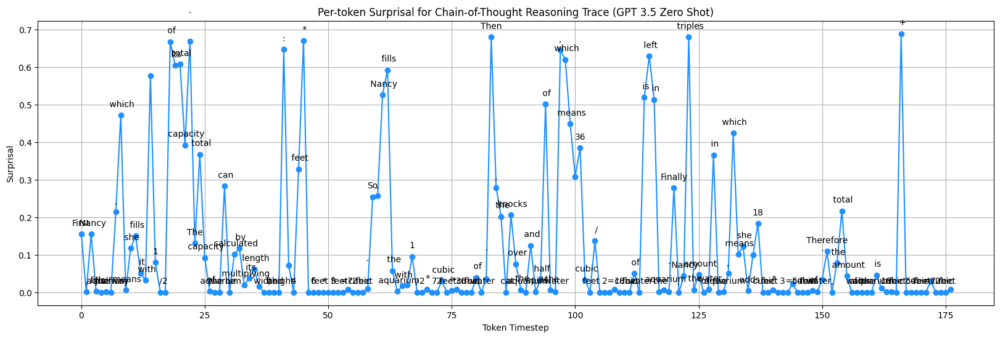

44


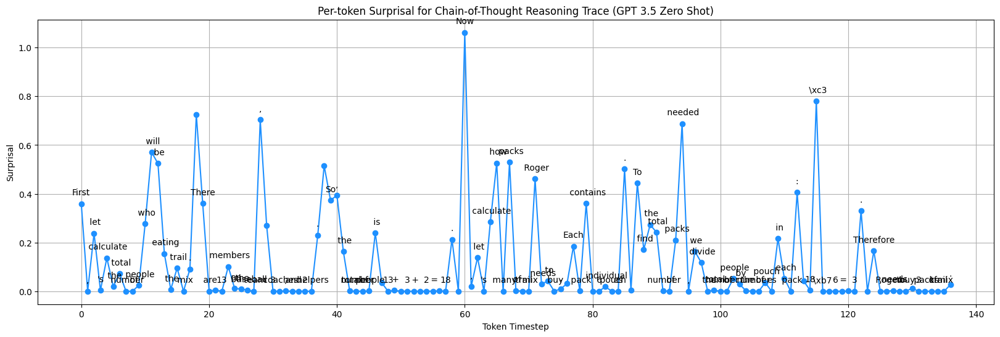

45


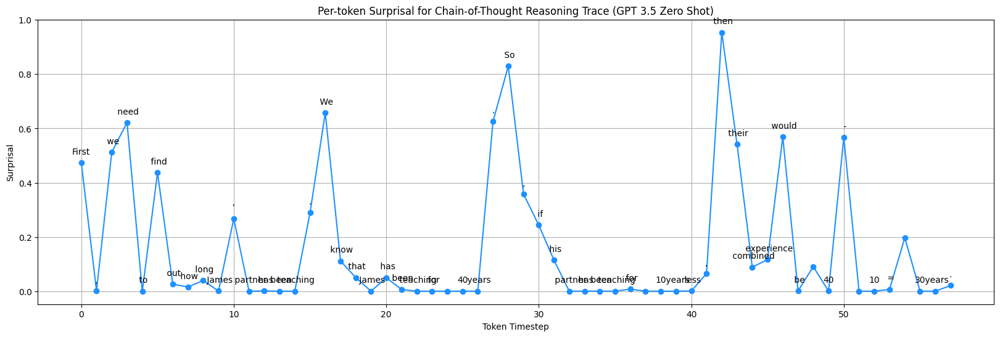

46


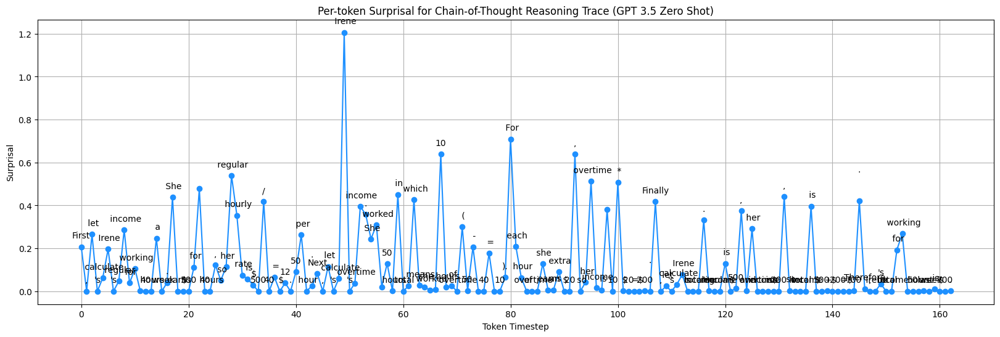

47


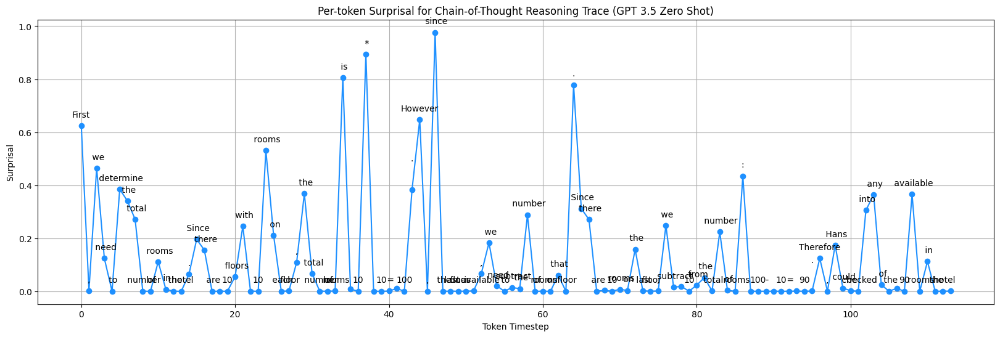

48


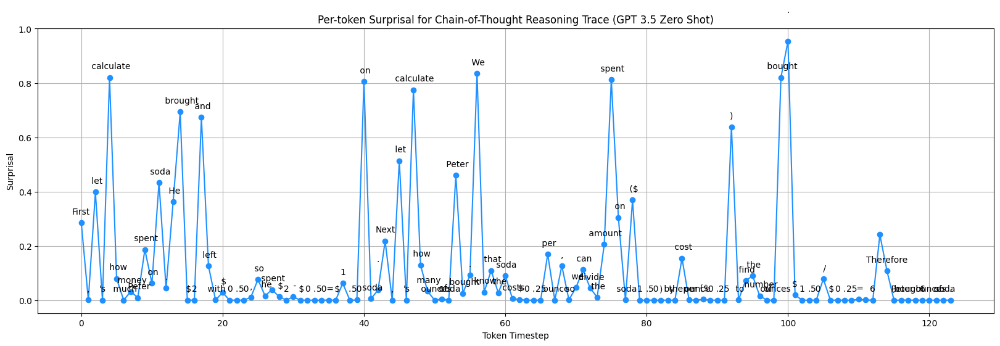

49


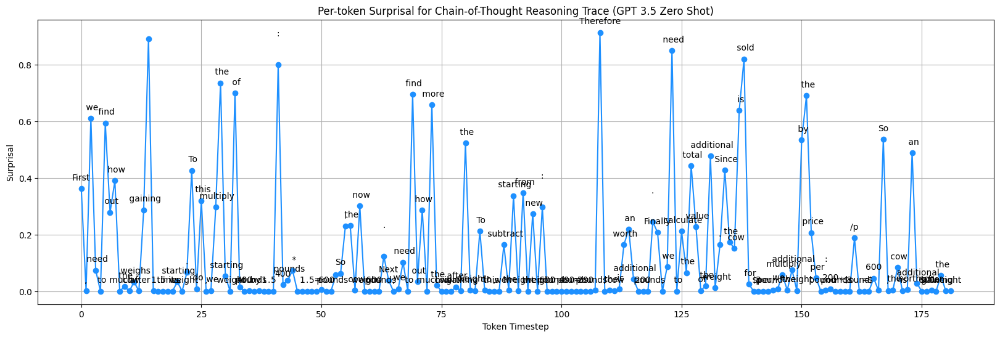

50


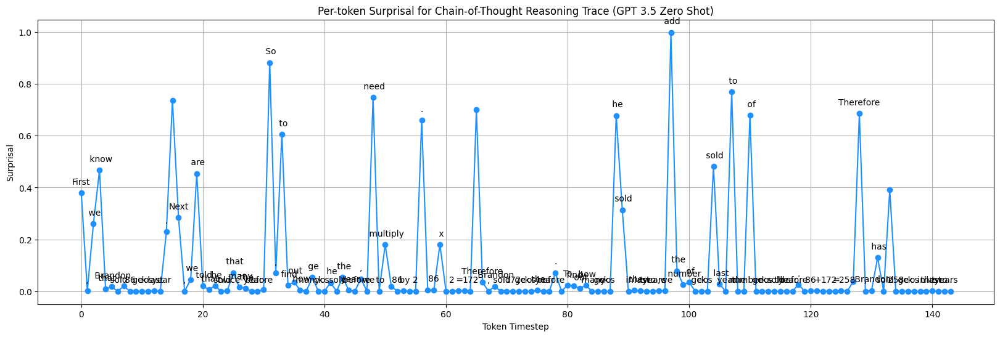

51


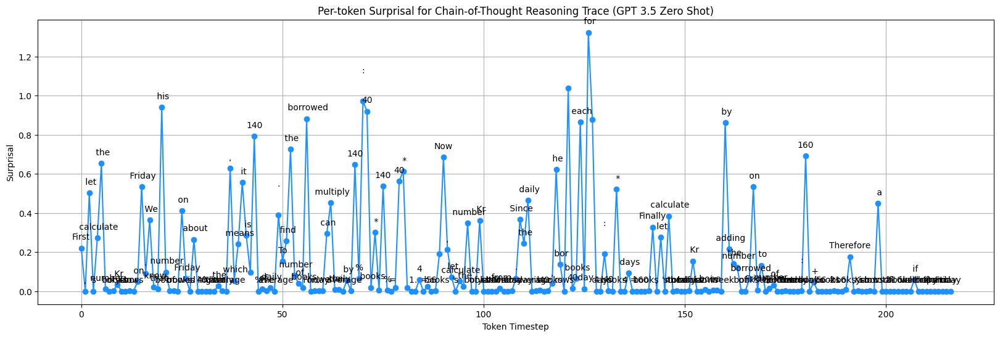

52


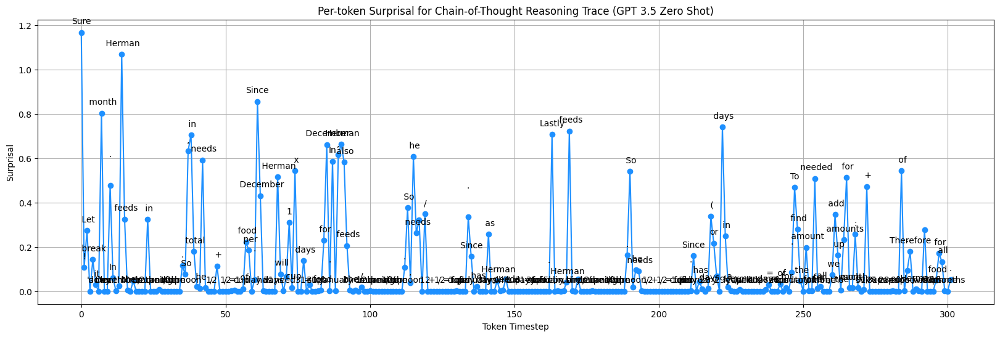

53


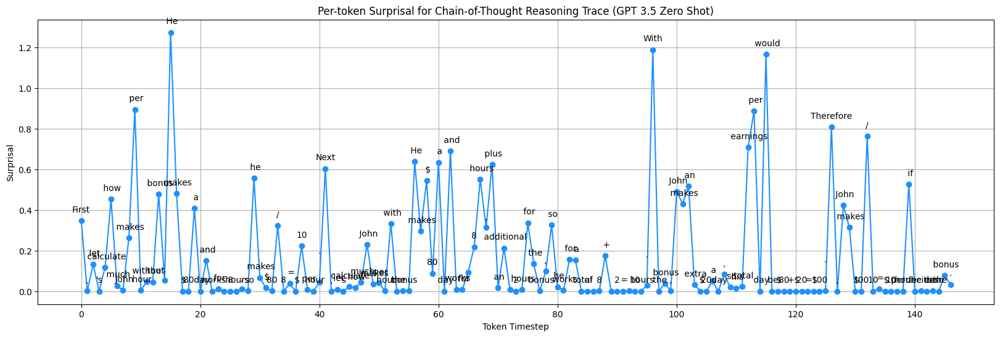

54


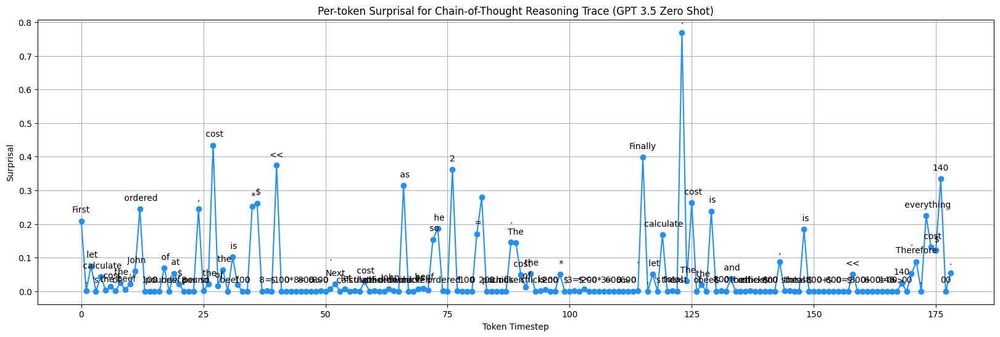

55


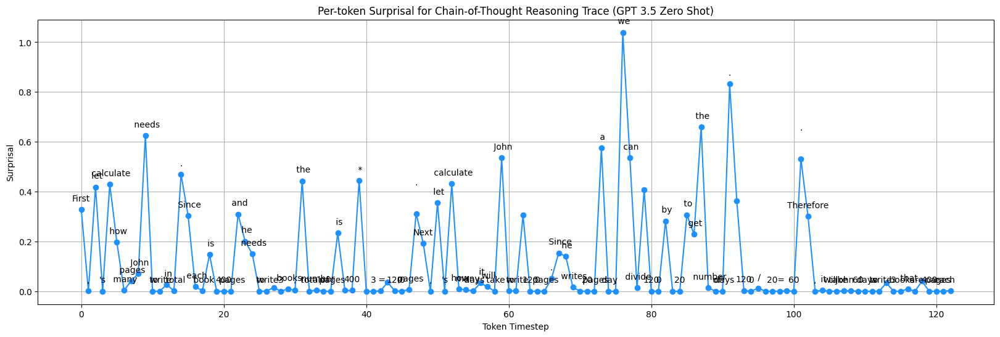

56


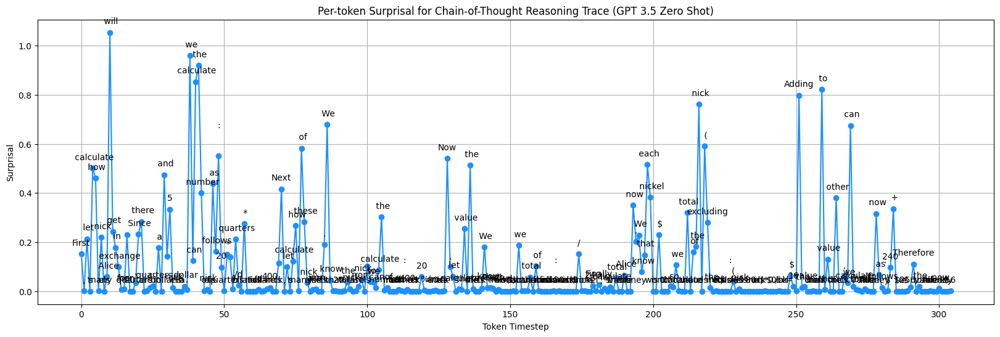

57


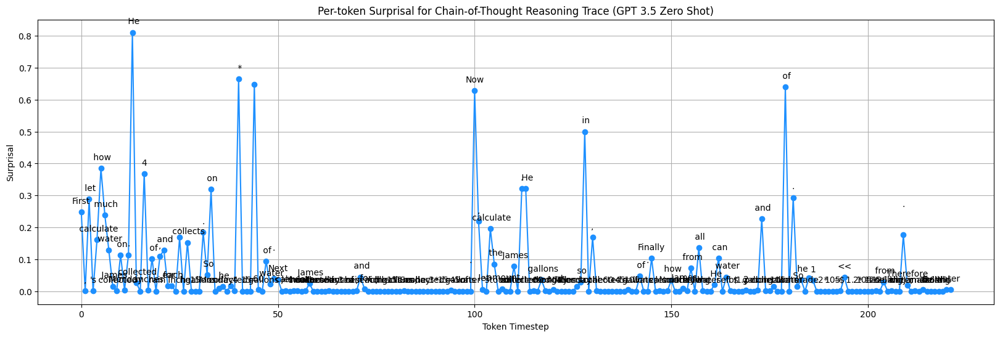

58


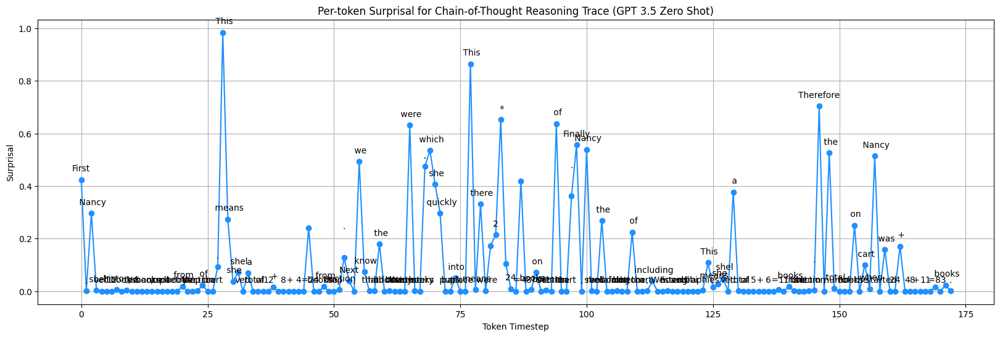

59


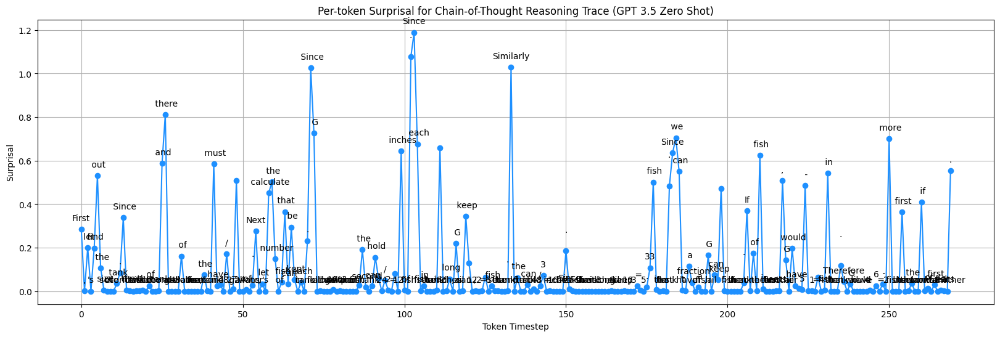

60


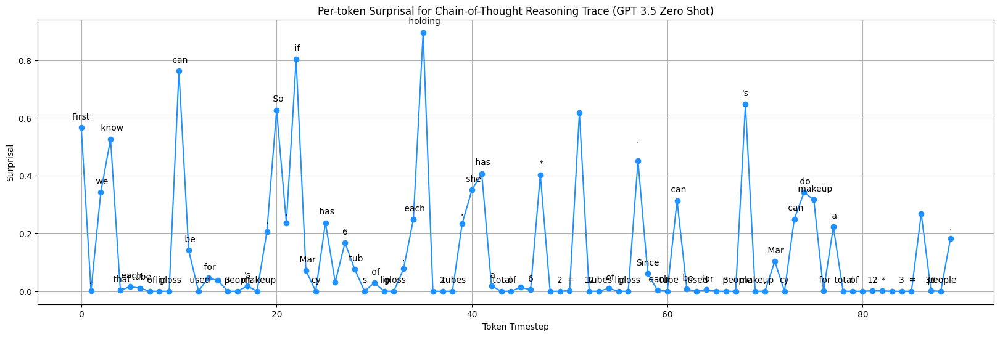

61


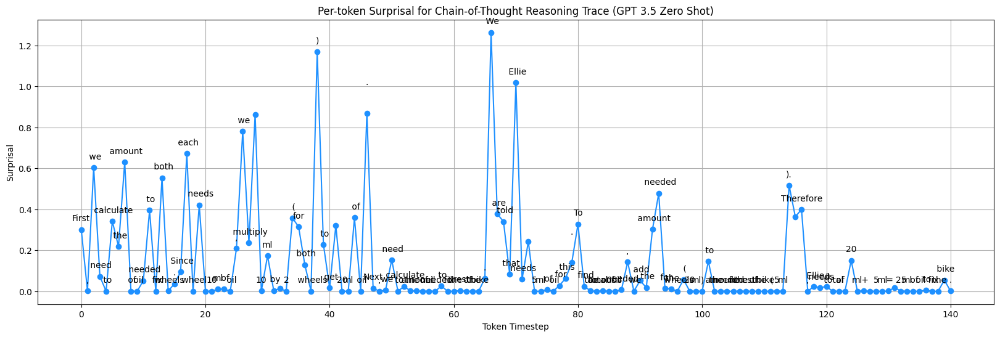

62


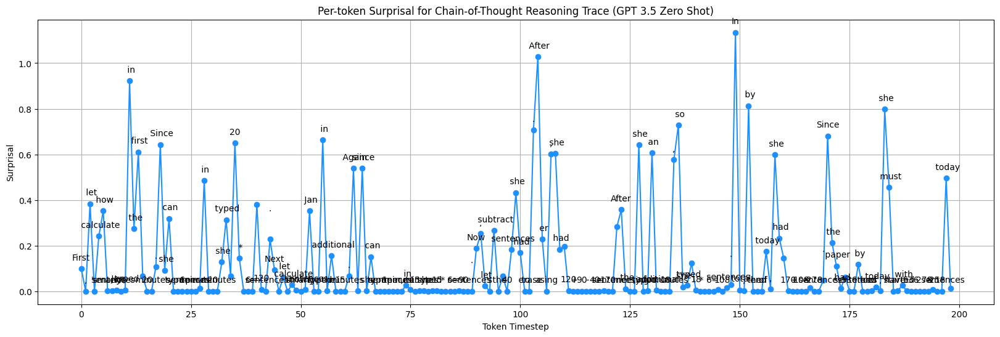

63


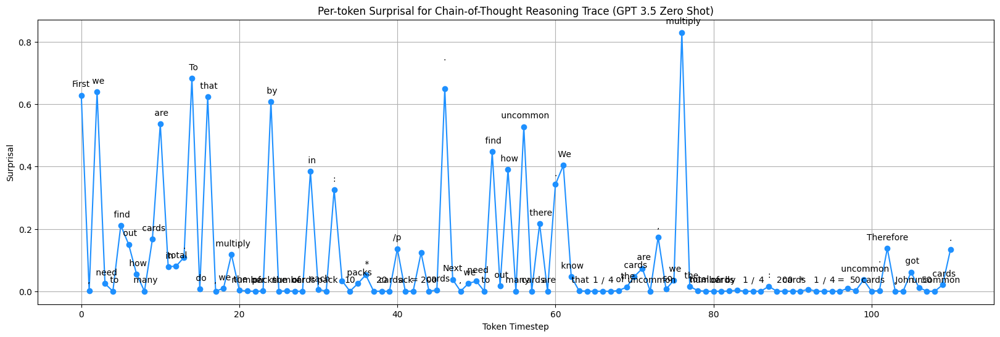

64


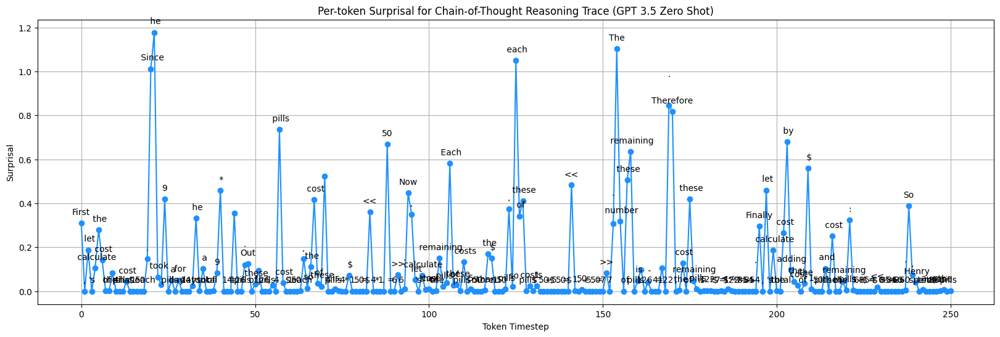

65


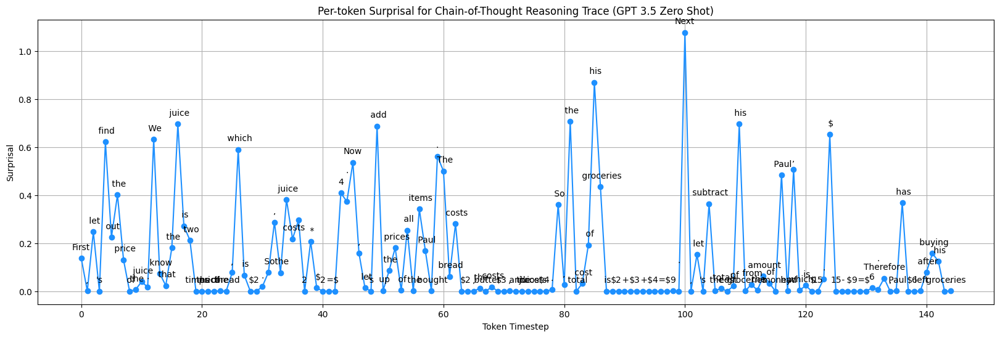

66


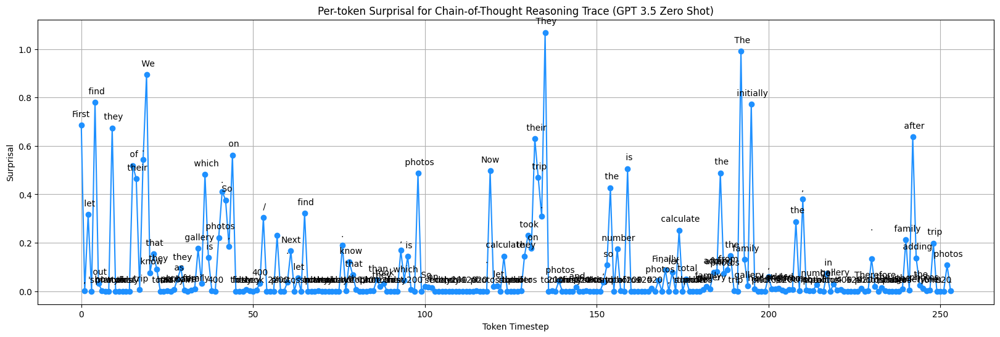

67


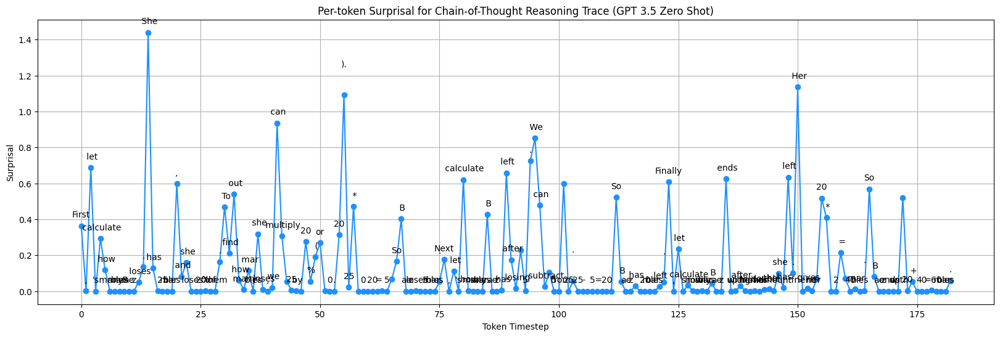

68


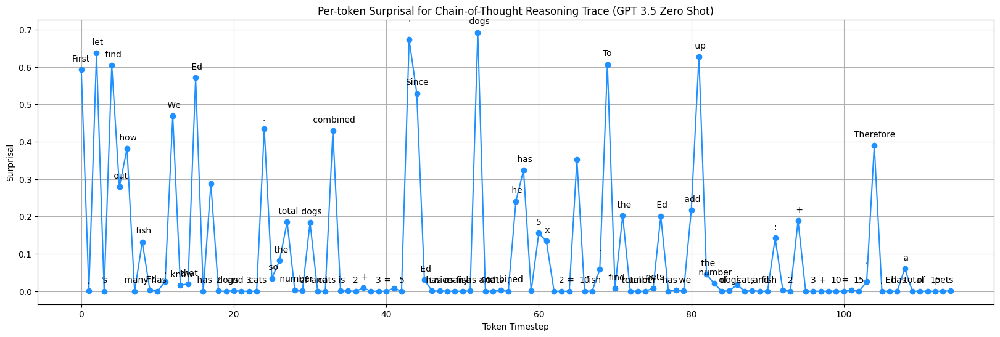

69


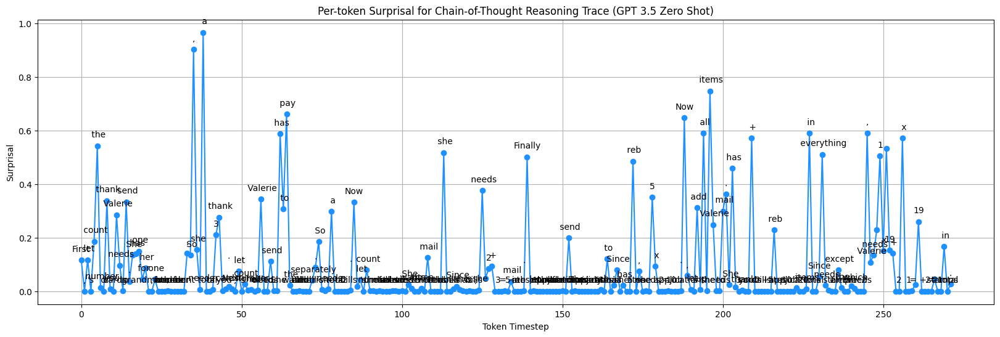

70


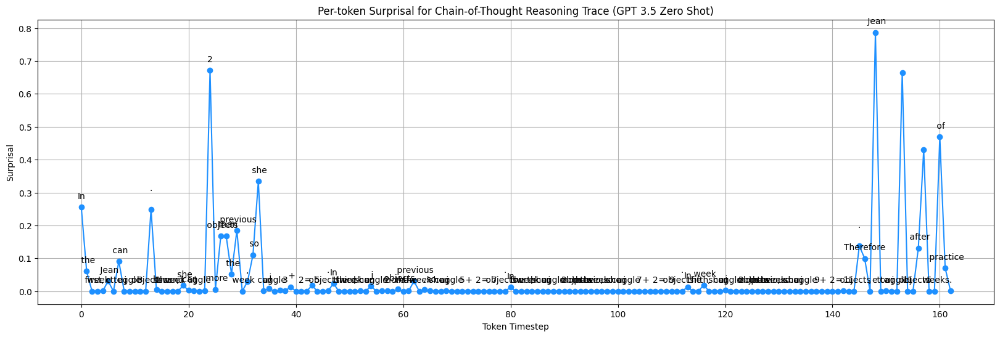

71


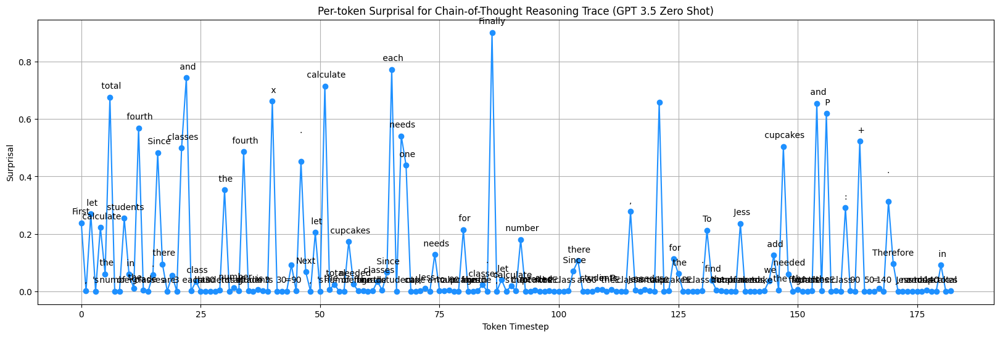

72


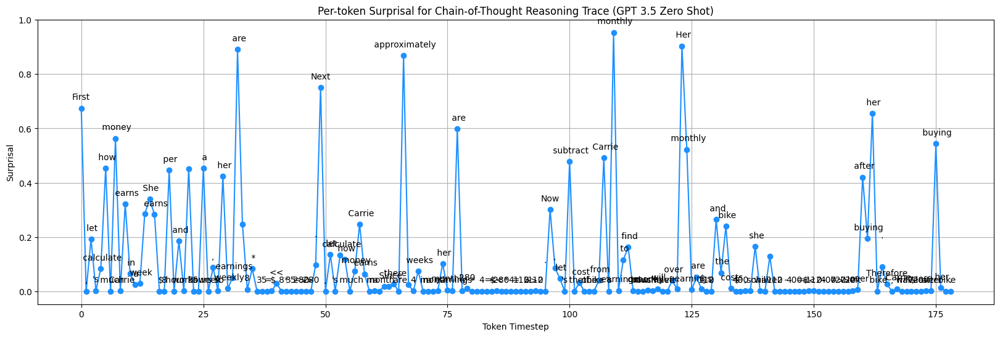

73


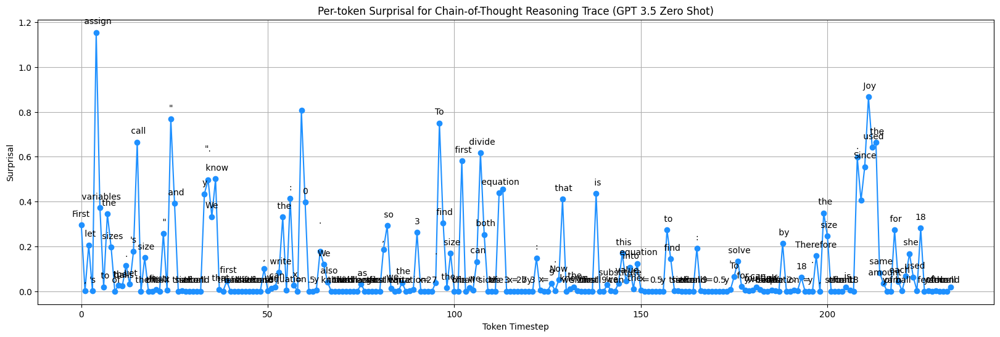

74


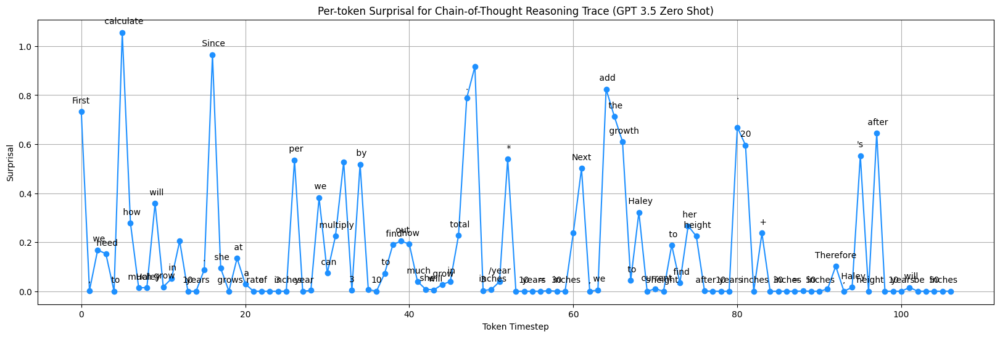

75


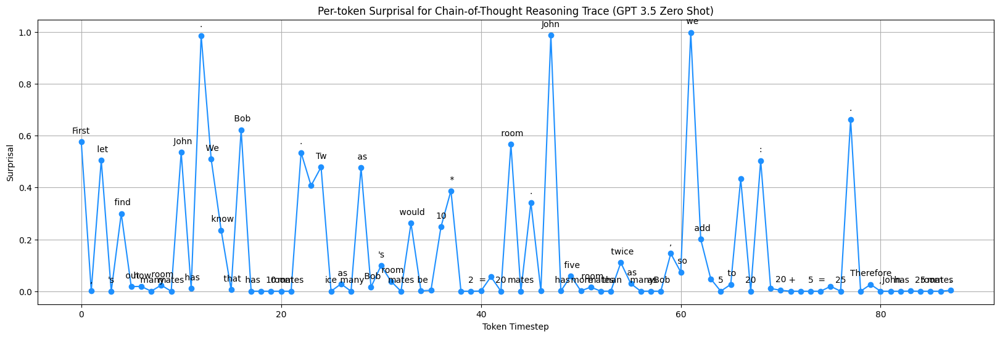

76


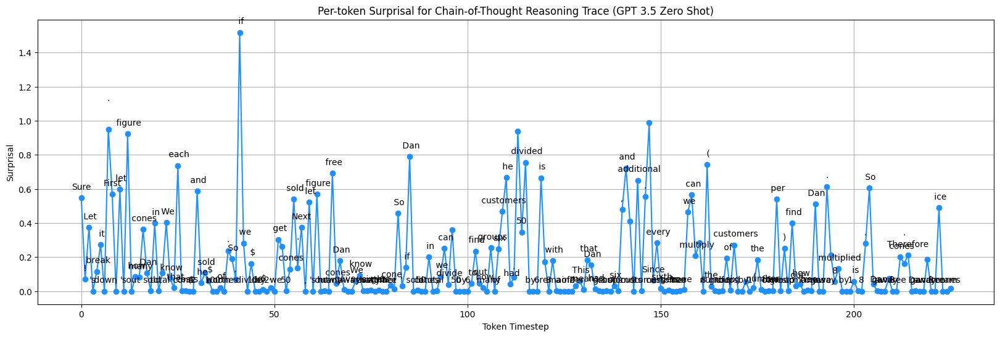

77


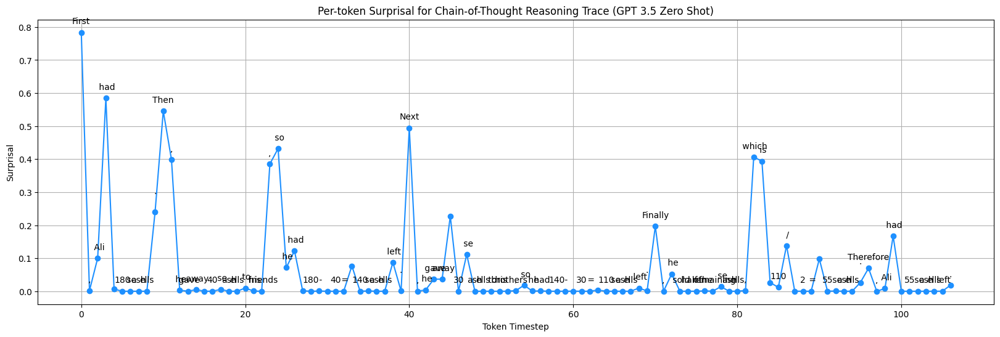

78


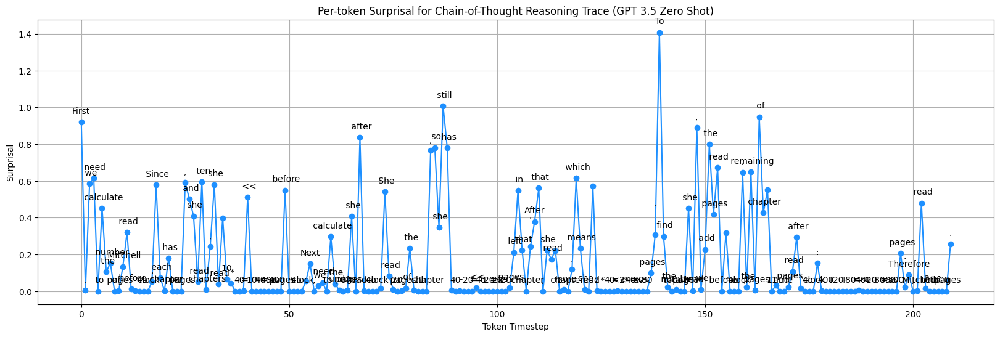

79


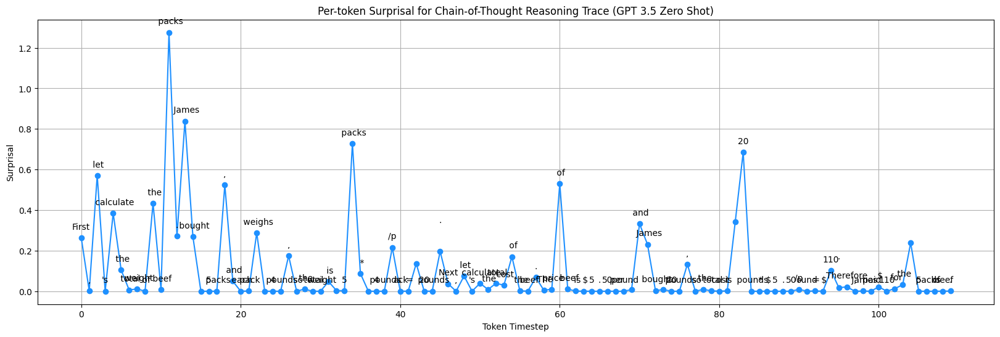

80


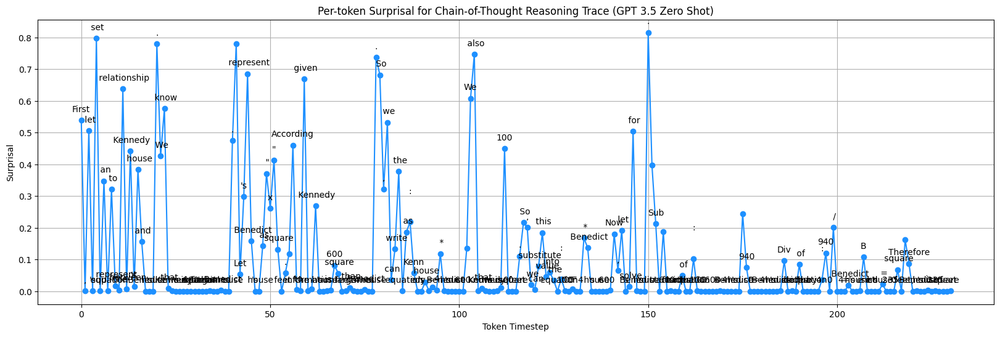

81


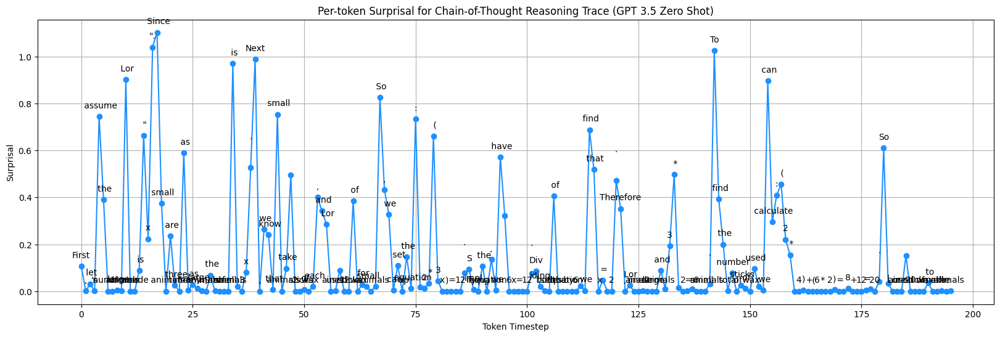

82


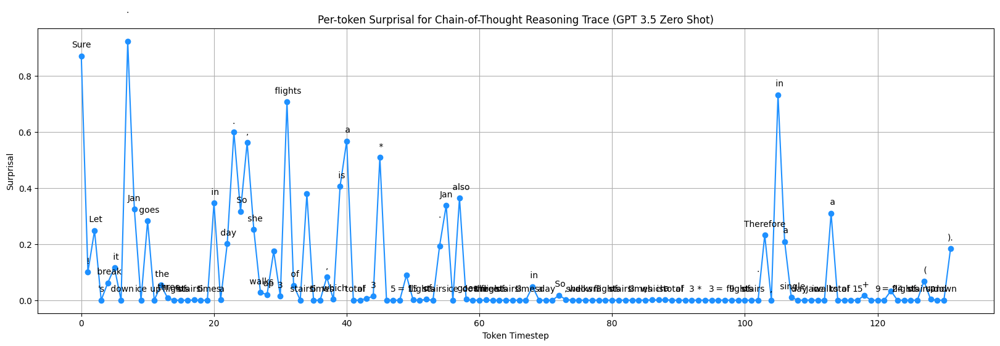

83


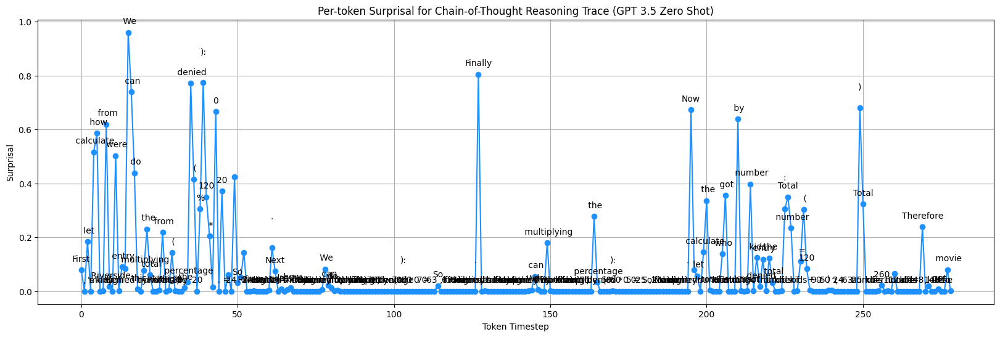

84


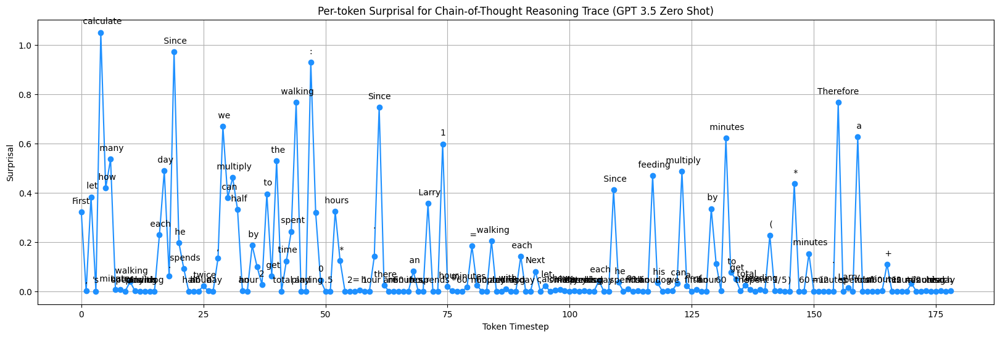

85


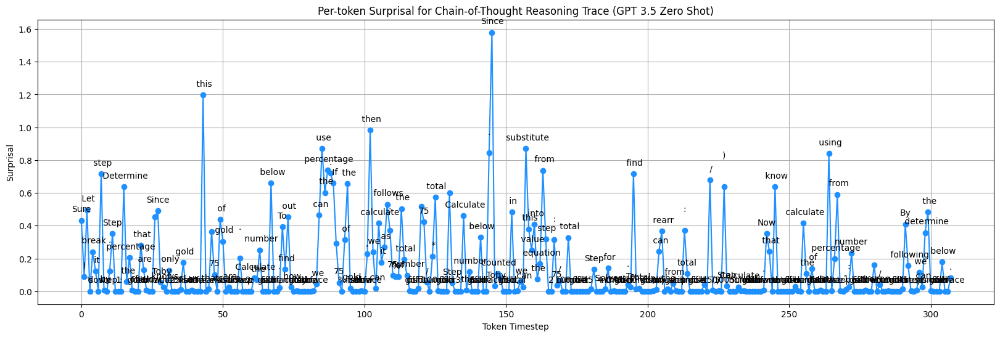

86


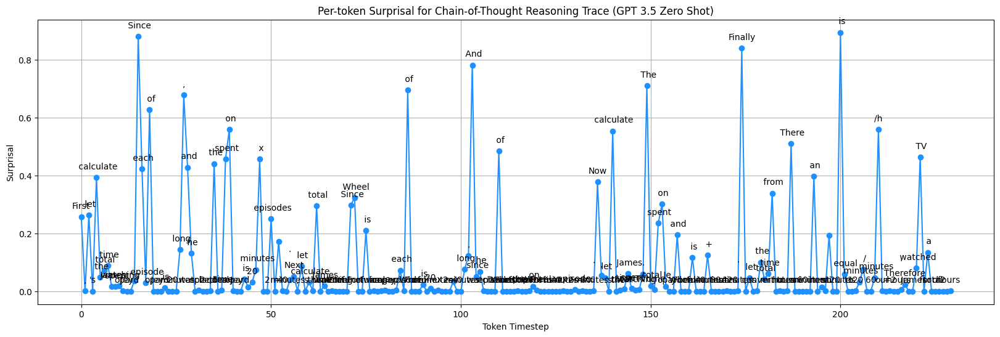

87


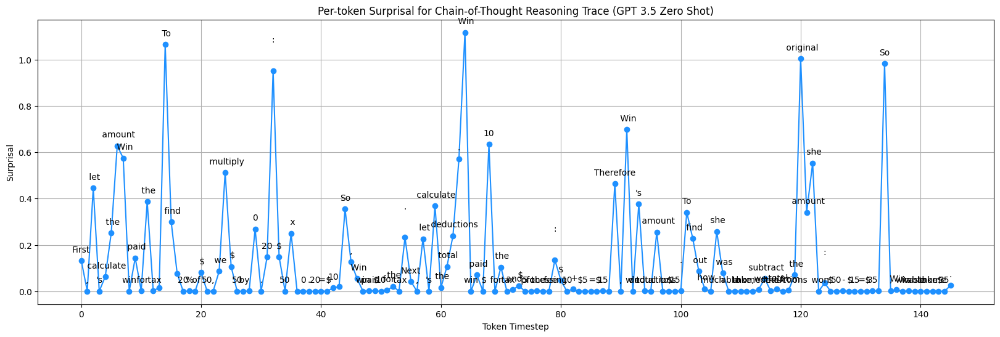

88


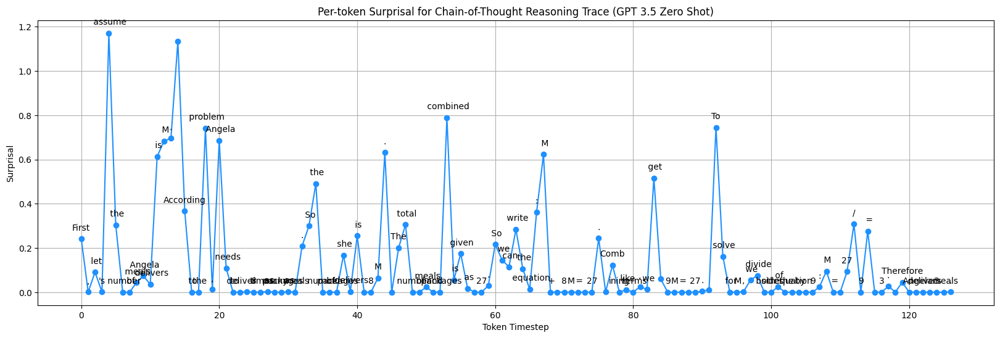

89


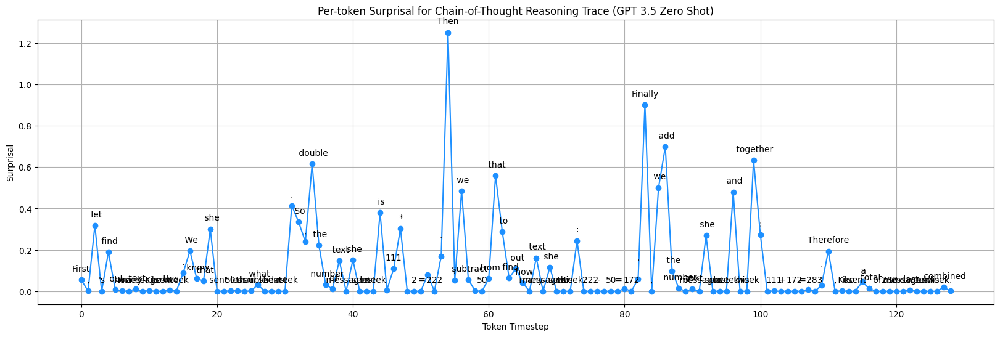

90


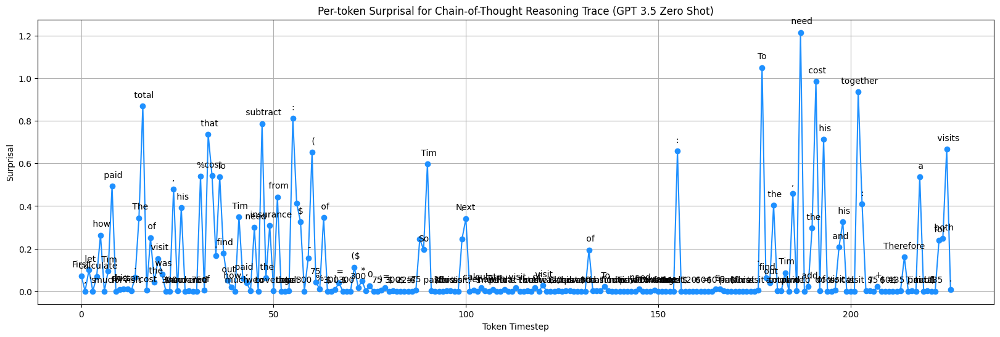

91


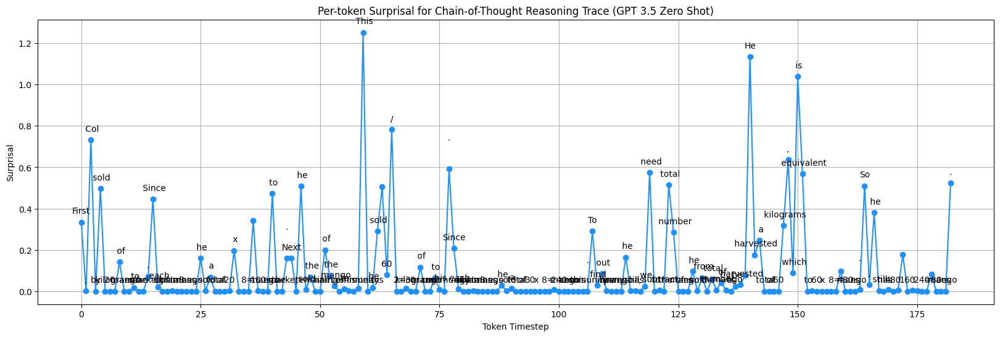

92


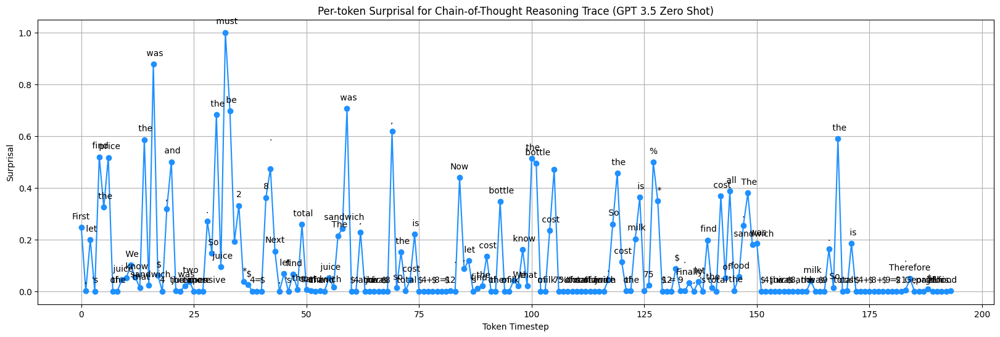

93


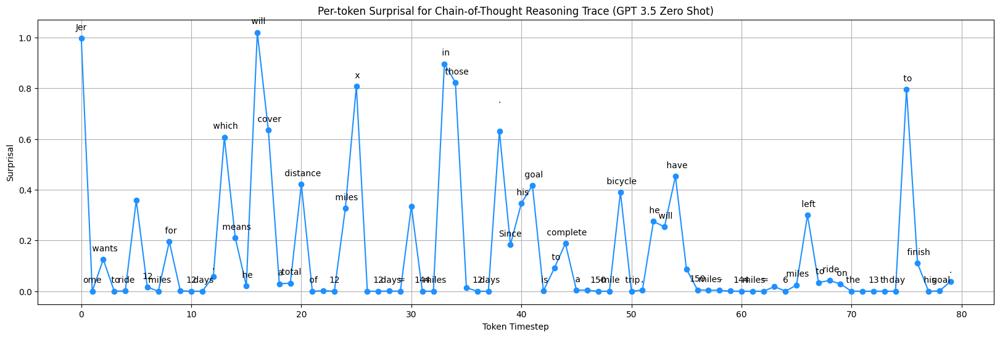

94


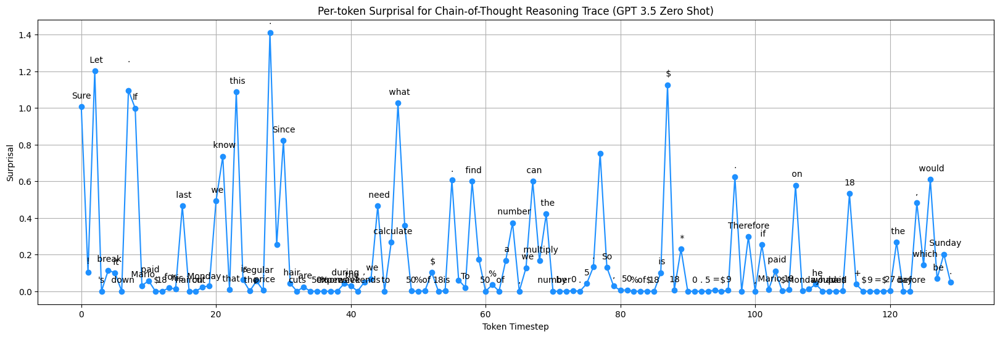

95


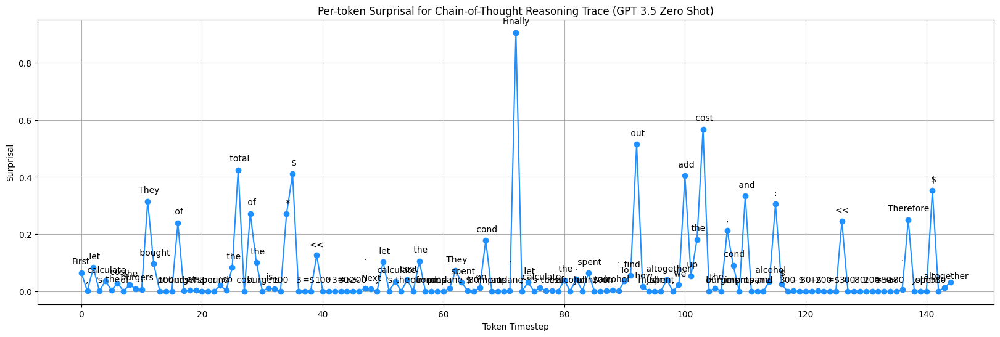

96


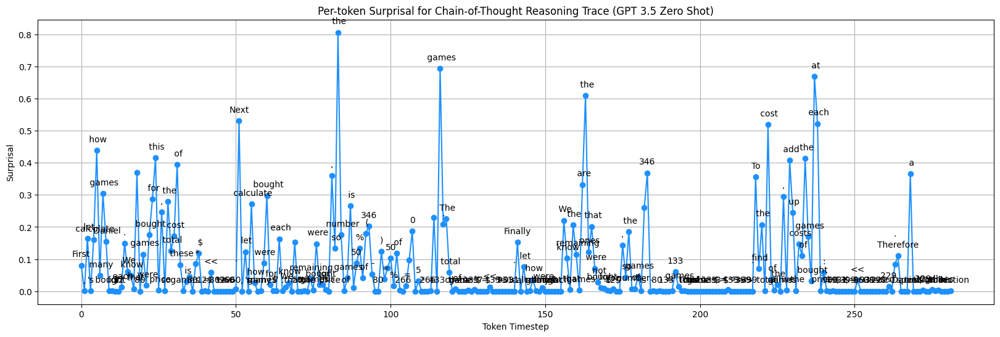

97


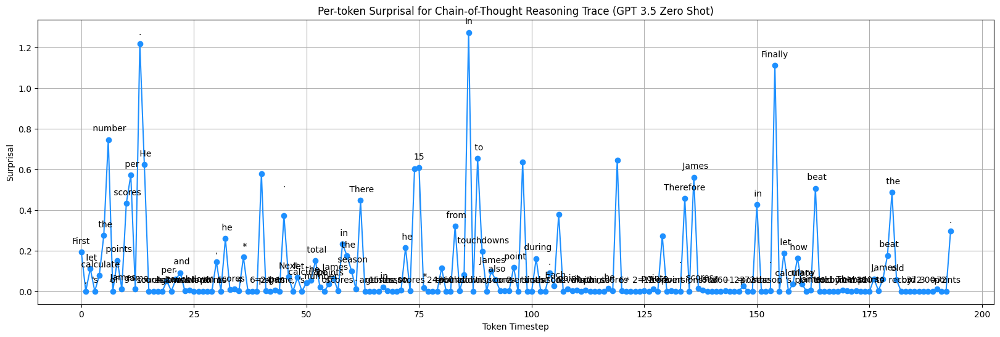

98


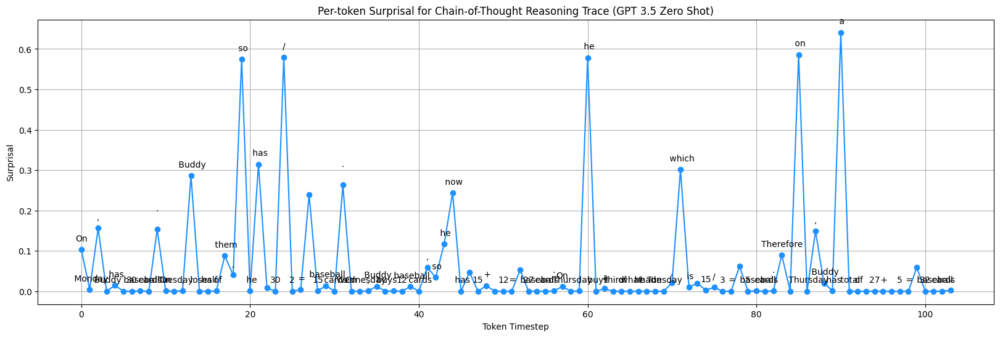

99


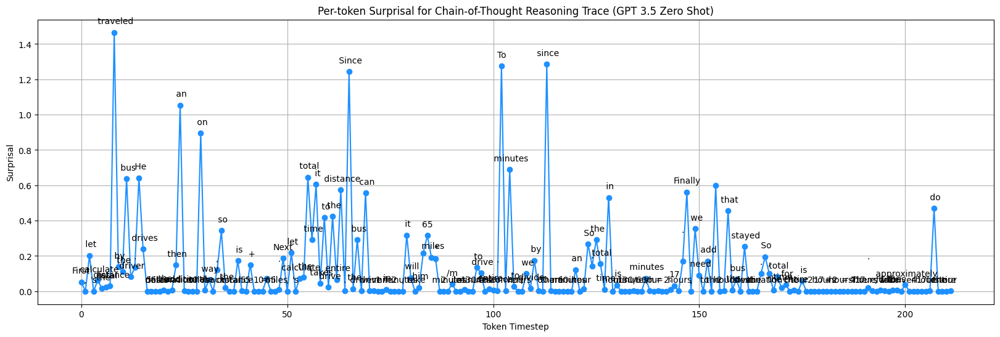

100


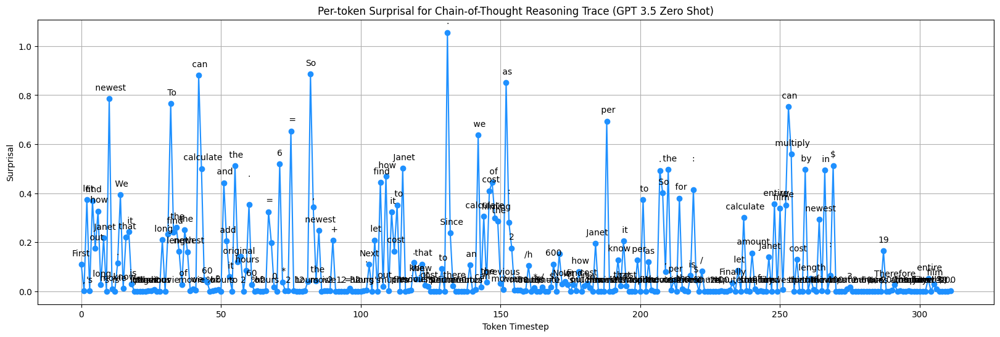

101


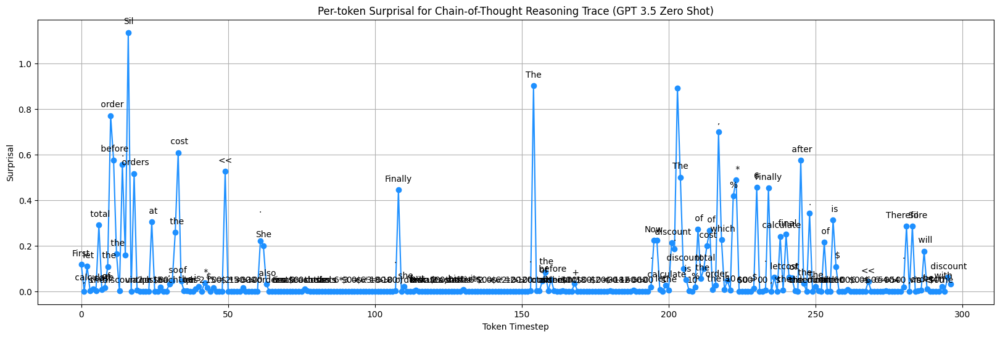

102


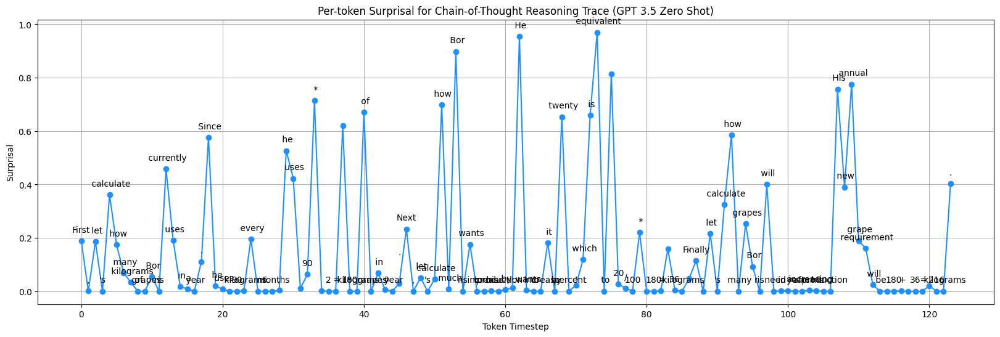

103


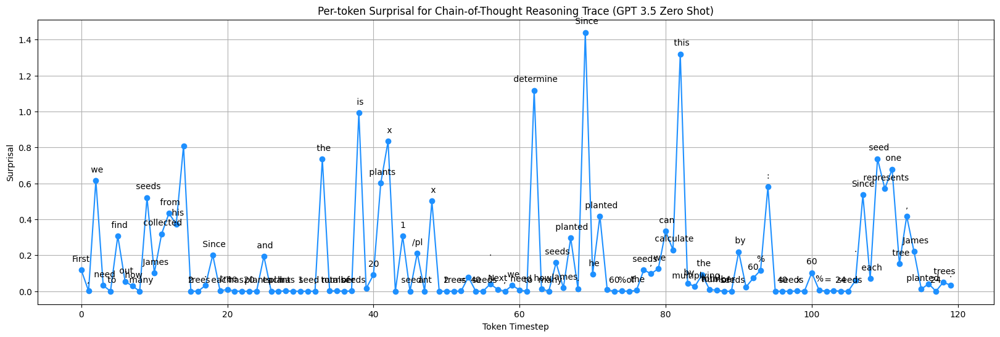

104


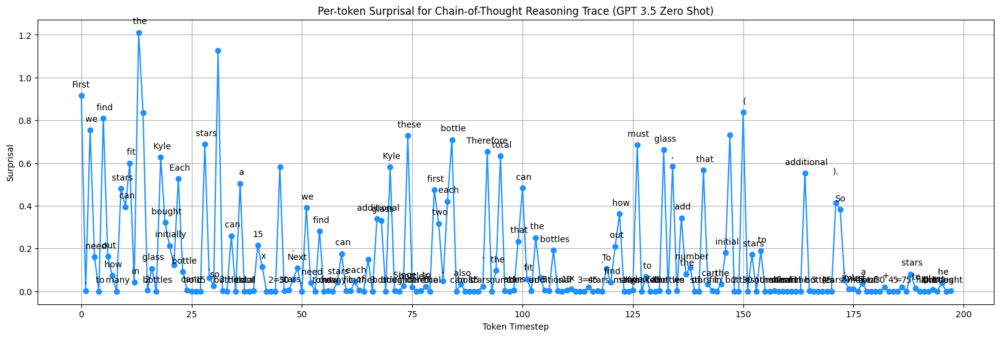

105


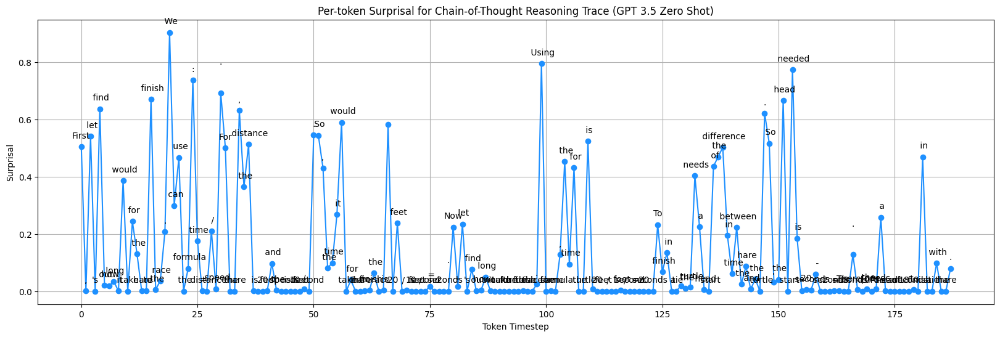

106


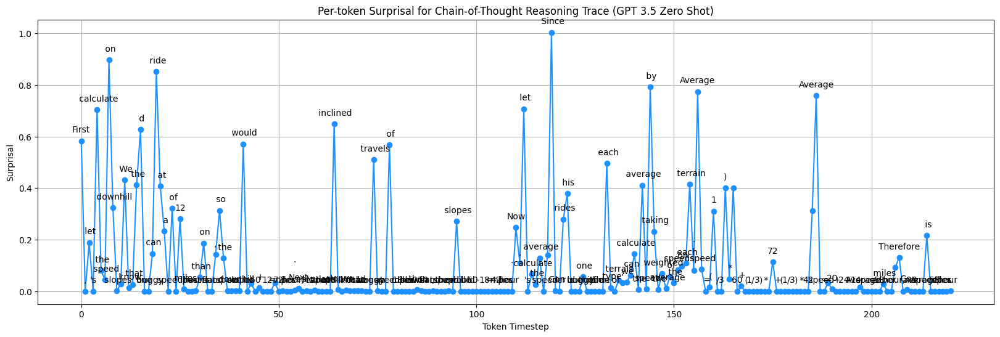

107


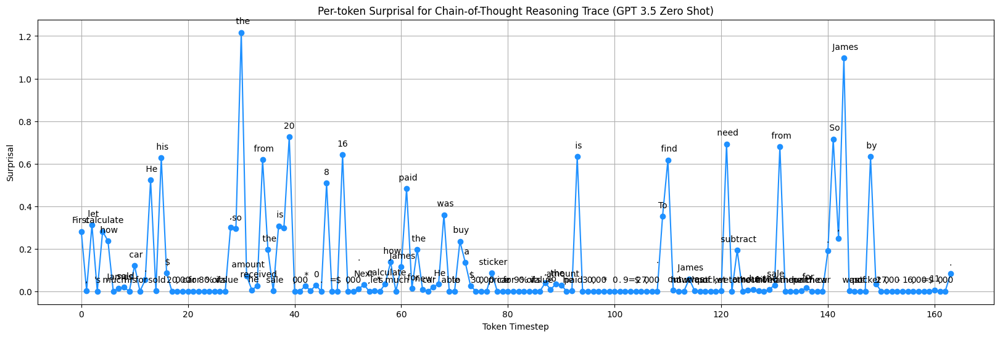

108


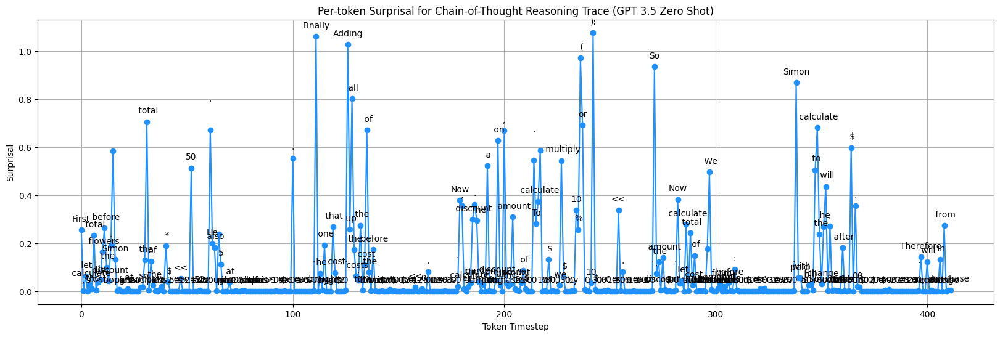

109


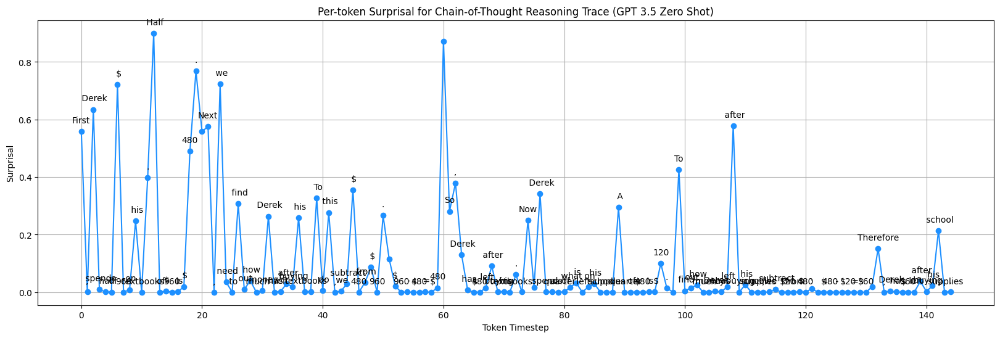

110


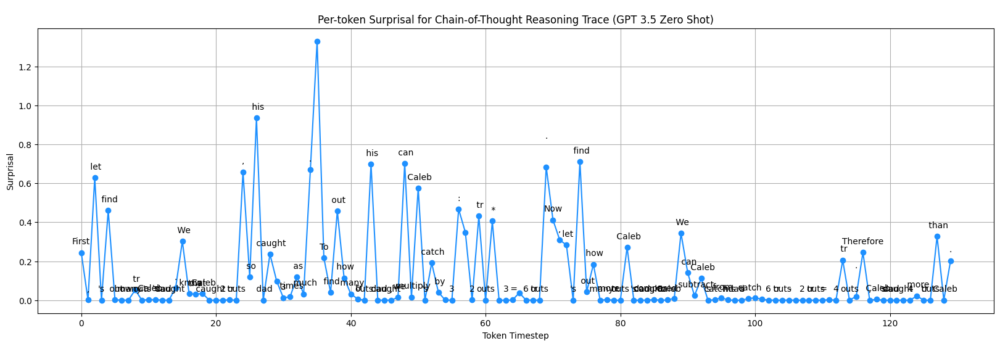

111


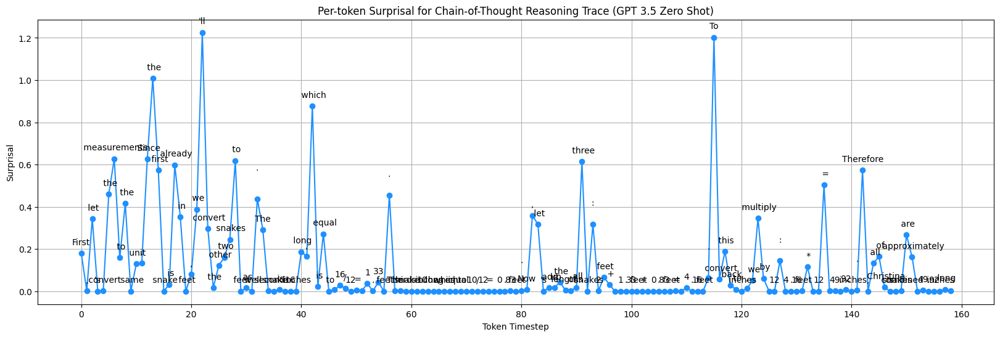

112


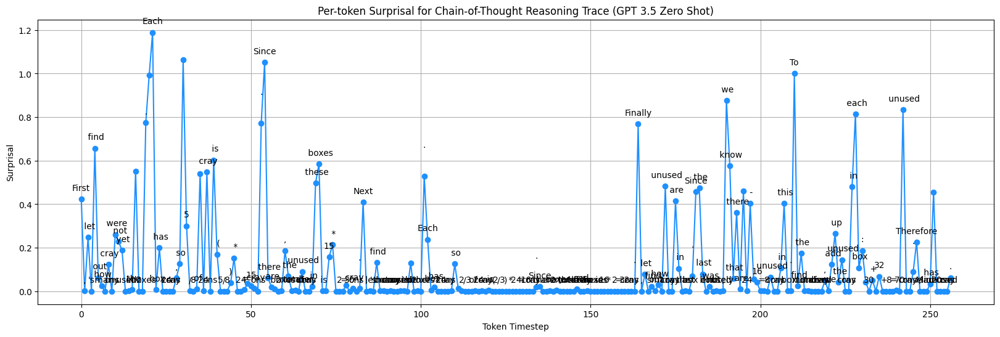

In [56]:
for i in range(len(df)):
    print(i)
    plot_tokenLevelLogProbs(df['logprobs'].tolist()[i], df['tokens'].tolist()[i])

Direct Answering

In [83]:
def get_direct_response_info(row):
    prompt = f"{row['Question']}"
    message = [
        {"role": "system", "content": "You are a helpful assistant."},
        {"role": "user", "content": f"{prompt}"}
    ]
    response = client.chat.completions.create(
        model="gpt-3.5-turbo-0613",
        messages = message,
        max_tokens=1024,
        temperature=0.0,
        n=1,
        stop=None,
        logprobs=True,
        top_logprobs=5
    )
    logprobs = [entry.logprob for entry in response.choices[0].logprobs.content]
    tokens = [entry.token for entry in response.choices[0].logprobs.content]
    response_text = response.choices[0].message.content
    return response_text, logprobs, tokens, response


In [98]:
# df['Direct Response'] = None
# df['direct_logprobs'] = None
# df['direct_tokens'] = None
# df['direct_api_response'] = None

for idx, row in df.iterrows():
    print(idx)
    try:
        response_text, logprobs, tokens, response = get_direct_response_info(row)
    except:
        "error at iteration ", idx
        break
    print(response_text)
    df.at[idx, 'Direct Response'] = response_text
    df.at[idx, 'direct_logprobs'] = logprobs
    df.at[idx, 'direct_tokens'] = tokens
    df.at[idx, 'direct_api_response'] = response

0


One Sentence prompt

In [3]:
df.columns

Index(['Problem Number', 'Question', 'Answer', 'CoT Response', 'CoT Sentences',
       'CoT Steps', 'split', 'Paraphrased Question', 'Paraphrased CoT Steps',
       'True Answer', 'Final Score', 'CoT Response 2', 'logprobs', 'tokens',
       'api_response'],
      dtype='object')

In [7]:
import ast

df = pd.read_csv('data/112_gsm8k_gpt35_cot_responses_logprobs.csv')
df['logprobs'] = df['logprobs'].apply(ast.literal_eval)
df['tokens'] = df['tokens'].apply(ast.literal_eval)
# df['api_response'] = df['api_response'].apply(ast.literal_eval)

In [8]:
def get_onesent_response_info(row):
    prompt = f"{row['Question']} Answer in one sentence."
    message = [
        {"role": "system", "content": "You are a helpful assistant."},
        {"role": "user", "content": f"{prompt}"}
    ]
    response = client.chat.completions.create(
        model="gpt-3.5-turbo-0613",
        messages = message,
        max_tokens=1024,
        temperature=0.0,
        n=1,
        stop=None,
        logprobs=True,
        top_logprobs=5
    )
    logprobs = [entry.logprob for entry in response.choices[0].logprobs.content]
    tokens = [entry.token for entry in response.choices[0].logprobs.content]
    response_text = response.choices[0].message.content
    return response_text, logprobs, tokens, response


In [ ]:
p18_response.choices[0].logprobs.content[135].top_logprobs


In [47]:
yum = pd.read_csv('data/new_gpt_responses')

In [27]:
# df['One Sentence Response'] = None
# df['onesent_logprobs'] = None
# df['onesent_tokens'] = None
# # df['onesent_api_response'] = None
# df['onesent_api_top_logprobs'] = None

# for idx, row in df[:2].iterrows():
#     print(idx)
#     try:
#         response_text, logprobs, tokens, response = get_onesent_response_info(row)
#     except Exception as e:
#         print(f"Error at iteration {idx}: {str(e)}")
#         break
#     print(response_text)
#     df.at[idx, 'One Sentence Response'] = response_text
#     df.at[idx, 'onesent_logprobs'] = logprobs
#     df.at[idx, 'onesent_tokens'] = tokens
#     # df.at[idx, 'onesent_api_response'] = response
#     df.at[idx, 'onesent_api_top_logprobs'] = [[(entry.token, entry.logprob) for entry in response.choices[0].logprobs.content[i].top_logprobs] for i in range(len(response.choices[0].logprobs.content))]

0
Natalia sold a total of 72 clips in April and May.
1
Weng earned $10 for 50 minutes of babysitting.


In [69]:
onesent_df = pd.read_csv('data/new_gpt_responses.csv')
onesent_df['logprobs'] = onesent_df['logprobs'].apply(ast.literal_eval)
onesent_df['tokens'] = onesent_df['tokens'].apply(ast.literal_eval)
# onesent_df['onesent_api_top_logprobs'] = onesent_df['onesent_api_top_logprobs'].apply(ast.literal_eval)
onesent_df['onesent_logprobs'] = onesent_df['onesent_logprobs'].apply(ast.literal_eval)
onesent_df['onesent_tokens'] = onesent_df['onesent_tokens'].apply(ast.literal_eval)
onesent_df['onesent_api_top_logprobs'] = onesent_df['onesent_api_top_logprobs'].apply(ast.literal_eval)

In [70]:
onesent_df.head(2)

,Problem Number,Question,Answer,CoT Response,CoT Sentences,CoT Steps,split,Paraphrased Question,Paraphrased CoT Steps,True Answer,Final Score,CoT Response 2,logprobs,tokens,api_response,One Sentence Response,onesent_logprobs,onesent_tokens,onesent_api_top_logprobs
0,0,Natalia sold clips to 48 of her friends in Apr...,Natalia sold 48/2 = <<48/2=24>>24 clips in May...,"First, let's find out how many clips Natalia s...","**\nFirst, let's find out how many clips Natal...","[""First, let's find out how many clips Natalia...",train,Derek collected seashells from 48 of his frien...,"['First, we need to figure out the number of s...",72,1,"In April, Natalia sold clips to 48 friends. \n...","[-0.1291976, -0.00031806578, -0.000602715, -0....","[In, April, ,, Natal, ia, sold, clips, to...",ChatCompletion(id='chatcmpl-91nJqookKzsoRSnZIN...,Natalia sold a total of 72 clips in April and ...,"[-0.0030397435, -3.0545007e-06, -8.657073e-06,...","[N, atal, ia, sold, a, total, of, , 72, ...","[[(N, -0.0030397435), (In, -5.8738513), (Al, -..."
1,1,Weng earns $12 an hour for babysitting. Yester...,Weng earns 12/60 = $<<12/60=0.2>>0.2 per minut...,"To find out how much Weng earned, we need to c...","**\nTo find out how much Weng earned, we need ...","['To find out how much Weng earned, we need to...",train,Liam makes $12 per hour tutoring. He tutored f...,"[""First, we need to figure out Liam's earnings...",10,1,"First, we need to convert the 50 minutes into ...","[-0.35689792, -0.0009994634, -0.37169525, -0.0...","[First, ,, we, need, to, convert, the, ,...",ChatCompletion(id='chatcmpl-91nJtqHb47BwX4XQfg...,Weng earned $10 for 50 minutes of babysitting.,"[-0.020672215, -0.00012916465, -0.0022319749, ...","[W, eng, earned, $, 10, for, , 50, minute...","[[(W, -0.020672215), (She, -4.367806), (Yester..."


Problem Number:  0
GPT One Sentence Answer:  Natalia sold a total of 72 clips in April and May.
-------------------------------
GPT CoT Answer:  In April, Natalia sold clips to 48 friends. 
In May, she sold half as many clips as in April. 
So, in May, she sold 48/2 = 24 clips. 
To find the total number of clips sold in April and May, we add the number of clips sold in each month: 
48 + 24 = 72. 
Therefore, Natalia sold a total of 72 clips in April and May.
-------------------------------
Correct Answer:  Natalia sold 48/2 = <<48/2=24>>24 clips in May.
Natalia sold 48+24 = <<48+24=72>>72 clips altogether in April and May.
#### 72


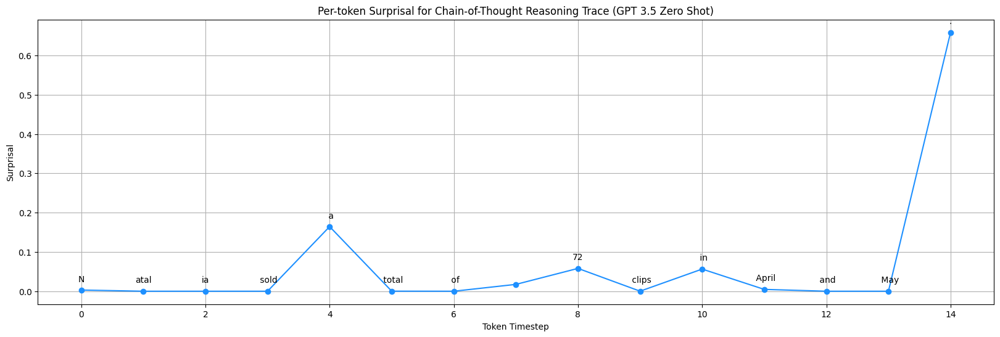

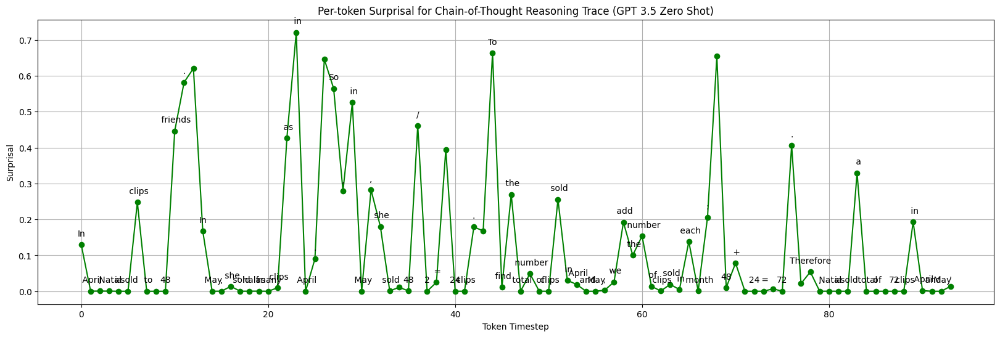

Problem Number:  1
GPT One Sentence Answer:  Weng earned $10 for 50 minutes of babysitting.
-------------------------------
GPT CoT Answer:  First, we need to convert the 50 minutes into hours. Since there are 60 minutes in an hour, we divide 50 by 60 to get 0.83 hours.

Next, we multiply the number of hours (0.83) by the hourly rate ($12) to find the total earnings. 

0.83 hours * $12/hour = $9.96

Therefore, Weng earned $9.96 for 50 minutes of babysitting.
-------------------------------
Correct Answer:  Weng earns 12/60 = $<<12/60=0.2>>0.2 per minute.
Working 50 minutes, she earned 0.2 x 50 = $<<0.2*50=10>>10.
#### 10


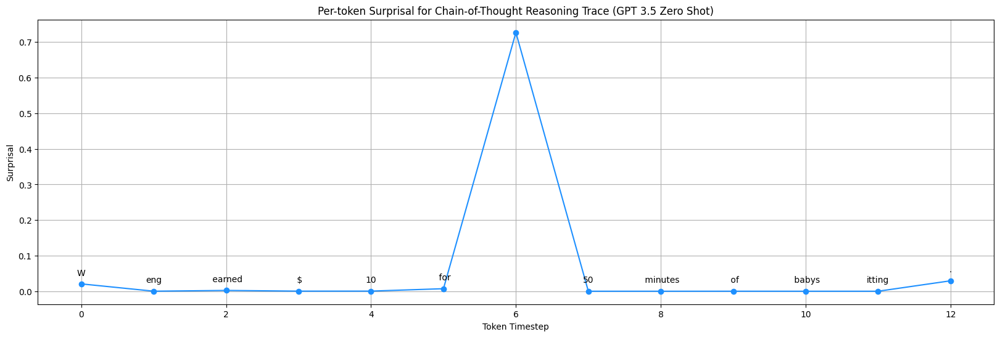

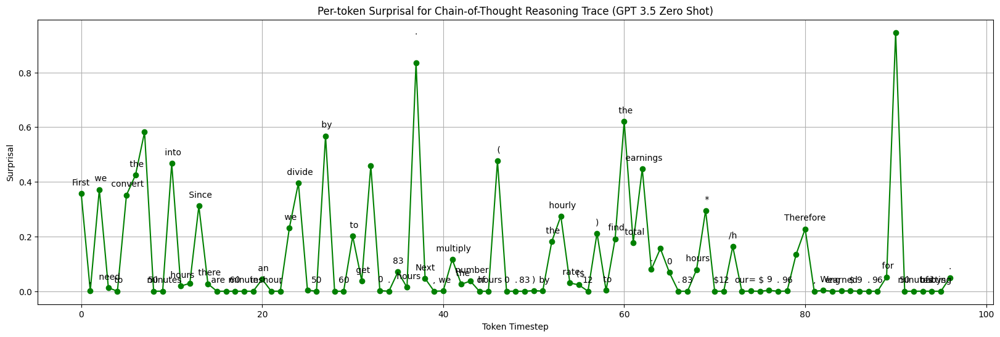

Problem Number:  2
GPT One Sentence Answer:  Betty still needs $35 more to buy the wallet.
-------------------------------
GPT CoT Answer:  First, let's calculate how much money Betty has saved so far. We know that she has only half of the money she needs, so half of $100 is $50.

Next, let's calculate how much money Betty's grandparents gave her. We know that her grandparents gave her twice as much as her parents, so $15 x 2 = $30.

Now, let's add up all the money Betty has saved. Betty has $50 + $15 + $30 = $95.

Finally, let's calculate how much more money Betty needs to buy the wallet. The wallet costs $100 and Betty has saved $95, so $100 - $95 = $5.

Therefore, Betty needs $5 more to buy the wallet.
-------------------------------
Correct Answer:  In the beginning, Betty has only 100 / 2 = $<<100/2=50>>50.
Betty's grandparents gave her 15 * 2 = $<<15*2=30>>30.
This means, Betty needs 100 - 50 - 30 - 15 = $<<100-50-30-15=5>>5 more.
#### 5


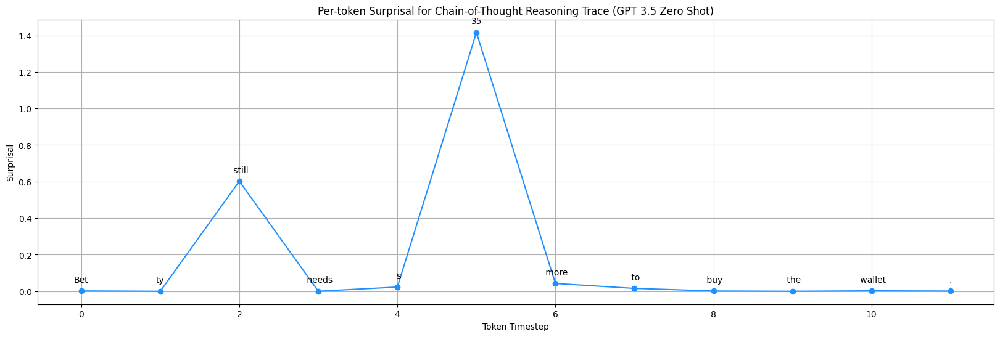

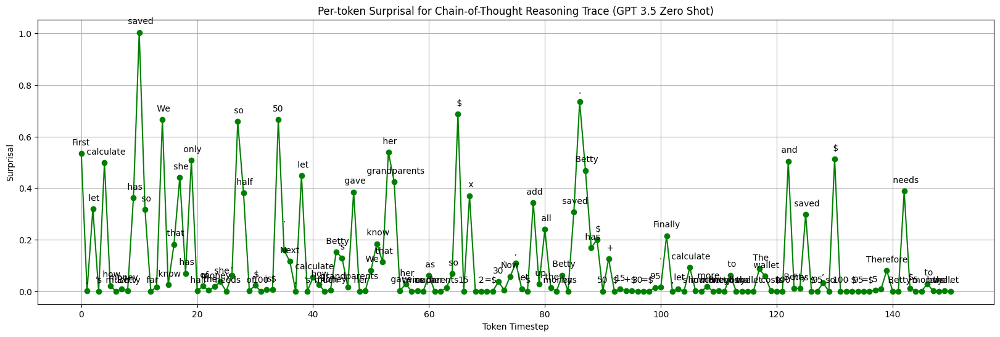

Problem Number:  3
GPT One Sentence Answer:  Julie should read 48 pages tomorrow.
-------------------------------
GPT CoT Answer:  Yesterday, Julie read 12 pages. Today, she read twice as many pages as yesterday, so she read 12 x 2 = <<12*2=24>>24 pages today.
So far, Julie has read a total of 12 + 24 = <<12+24=36>>36 pages.
The remaining pages in the book are 120 - 36 = <<120-36=84>>84 pages.
Julie wants to read half of the remaining pages tomorrow, so she should read 84 / 2 = <<84/2=42>>42 pages.
-------------------------------
Correct Answer:  Maila read 12 x 2 = <<12*2=24>>24 pages today.
So she was able to read a total of 12 + 24 = <<12+24=36>>36 pages since yesterday.
There are 120 - 36 = <<120-36=84>>84 pages left to be read.
Since she wants to read half of the remaining pages tomorrow, then she should read 84/2 = <<84/2=42>>42 pages.
#### 42


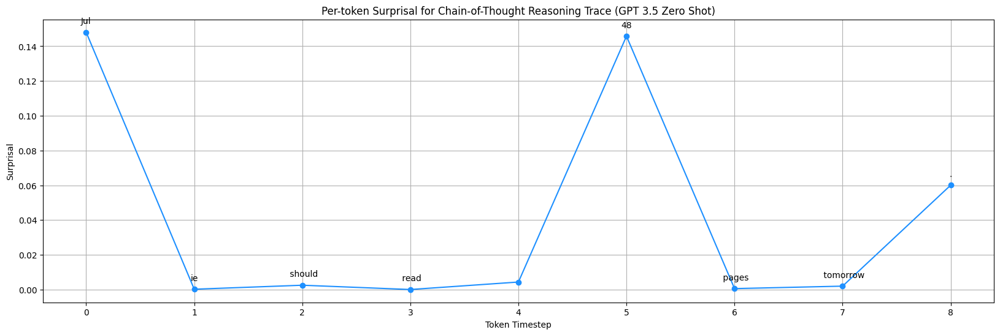

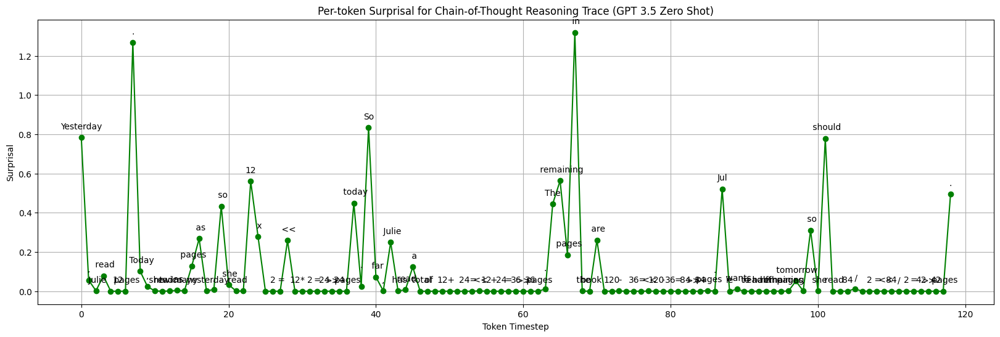

Problem Number:  4
GPT One Sentence Answer:  James writes a total of 624 pages in a year.
-------------------------------
GPT CoT Answer:  First, let's calculate how many pages James writes in a week. 

He writes a 3-page letter to 2 different friends twice a week, so he writes 3 x 2 = <<3*2=6>>6 pages in a week.

Next, let's calculate how many pages James writes in a year. 

There are 52 weeks in a year, so he writes 6 x 52 = <<6*52=312>>312 pages in a year.

Therefore, James writes 312 pages in a year.
-------------------------------
Correct Answer:  He writes each friend 3*2=<<3*2=6>>6 pages a week
So he writes 6*2=<<6*2=12>>12 pages every week
That means he writes 12*52=<<12*52=624>>624 pages a year
#### 624


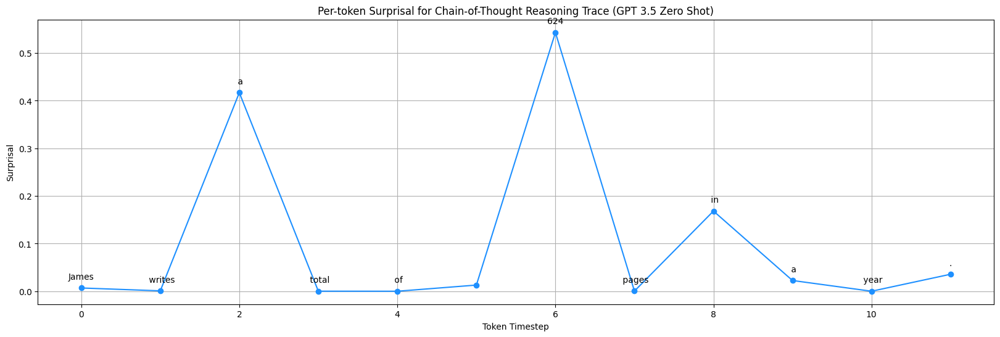

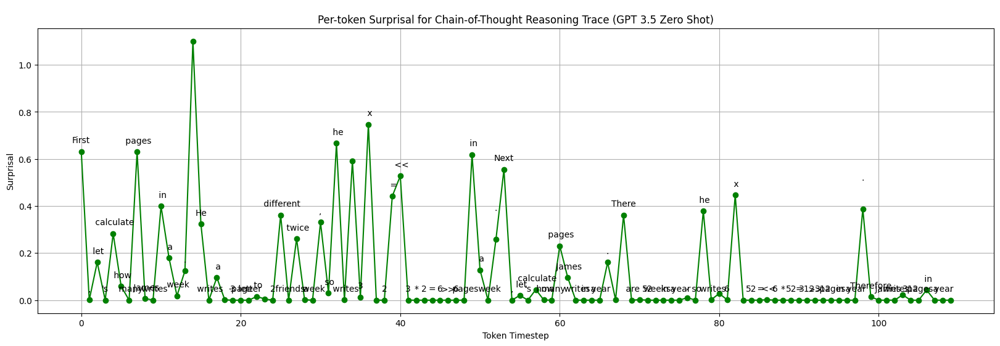

In [91]:
for idx, row in onesent_df[:5].iterrows():
    print("Problem Number: ", row['Problem Number'])
    print("GPT One Sentence Answer: ", row['One Sentence Response'])
    print("-------------------------------")
    print("GPT CoT Answer: ", row['CoT Response 2'])
    print("-------------------------------")
    print("Correct Answer: ", row['Answer'])
    plot_tokenLevelLogProbs(row['onesent_logprobs'], row['onesent_tokens'])
    plot_tokenLevelLogProbs(row['logprobs'], row['tokens'], color='green')

0


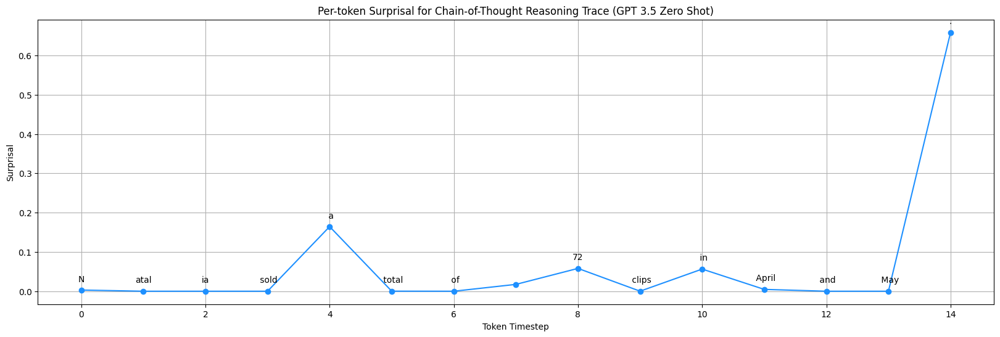

1


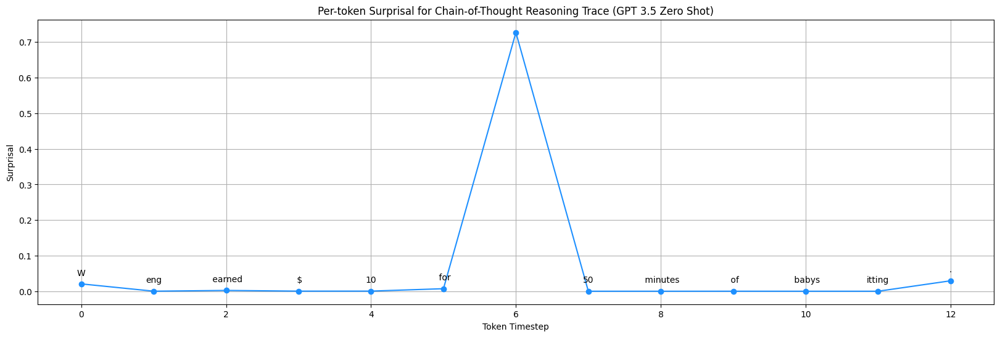

2


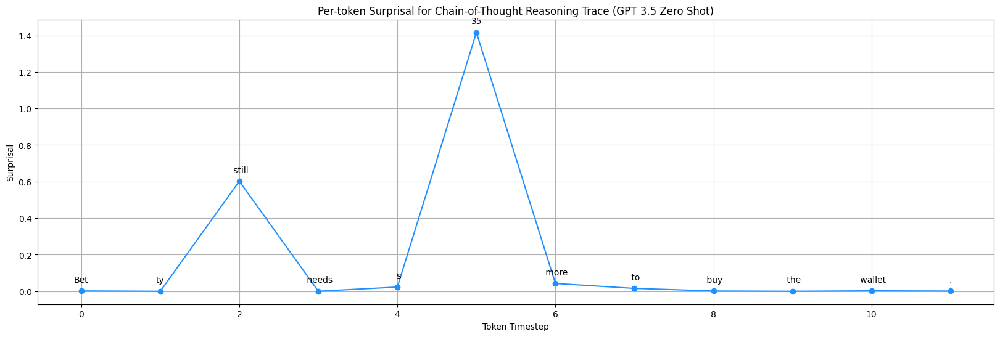

3


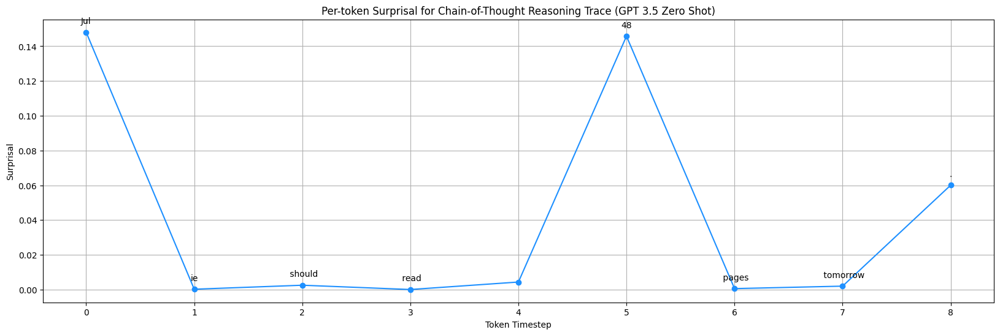

4


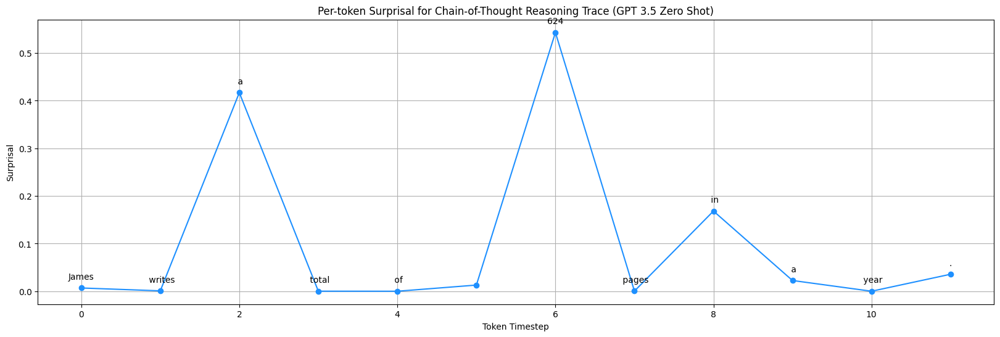

5


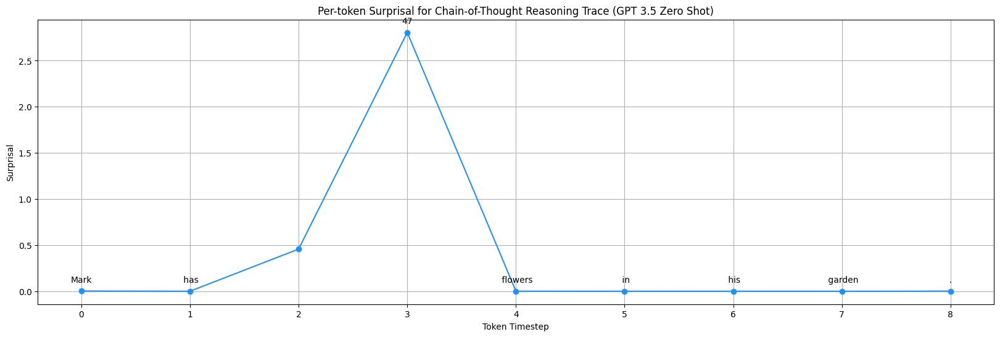

6


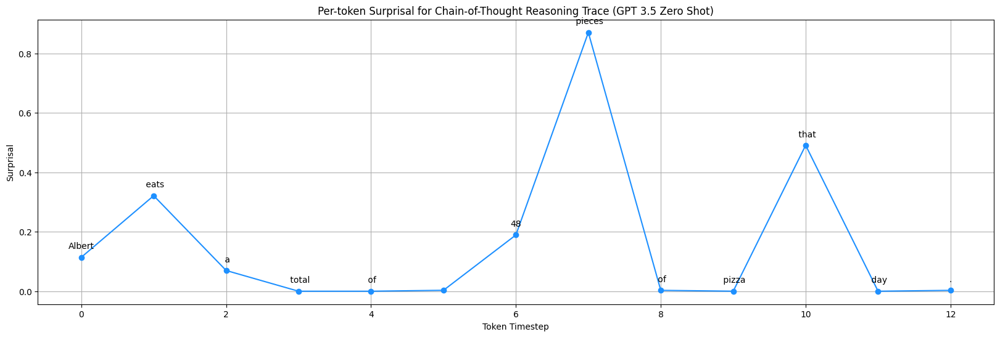

7


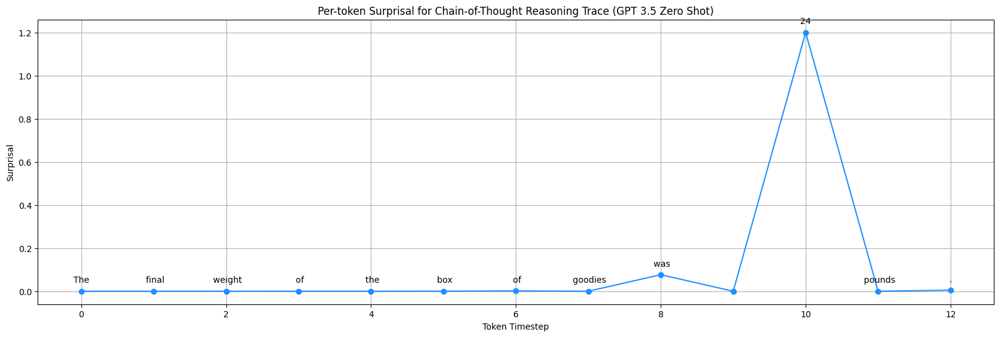

8


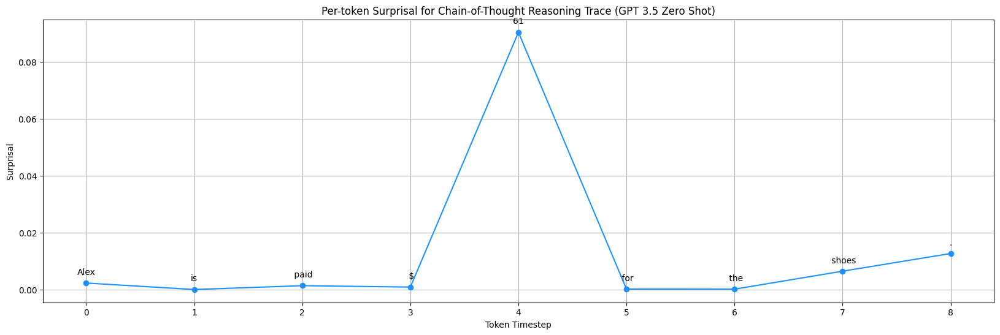

9


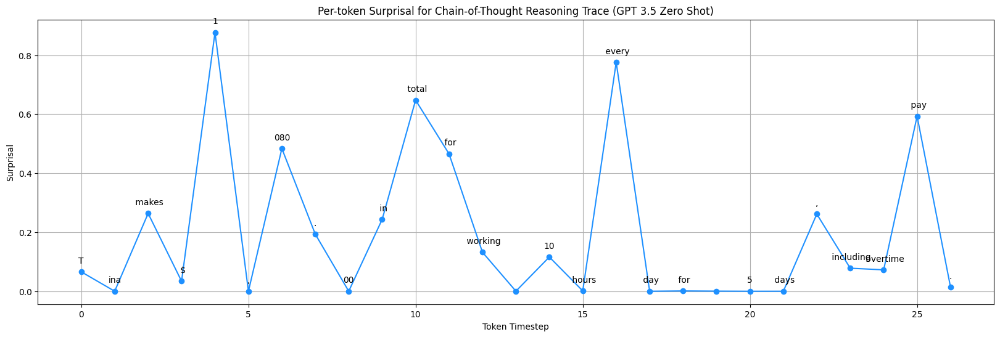

10


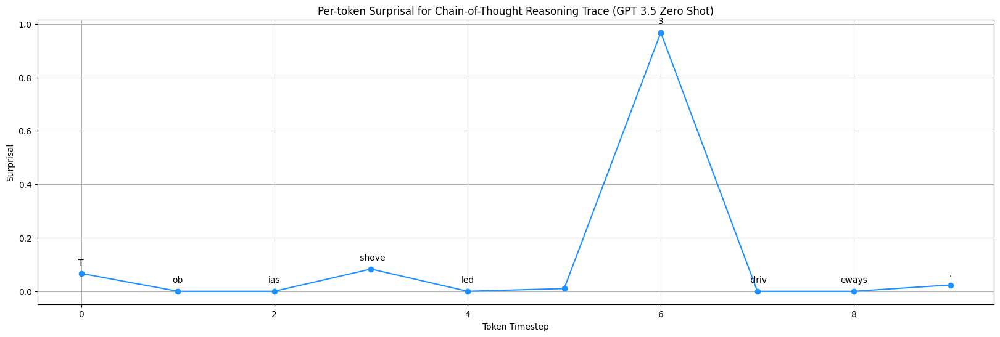

11


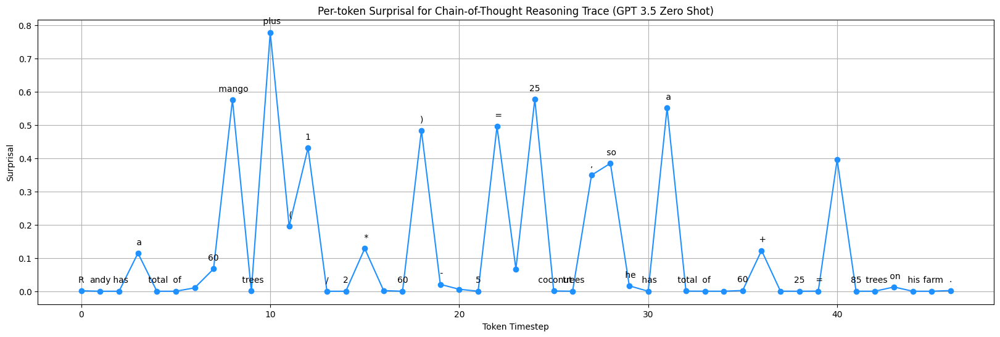

12


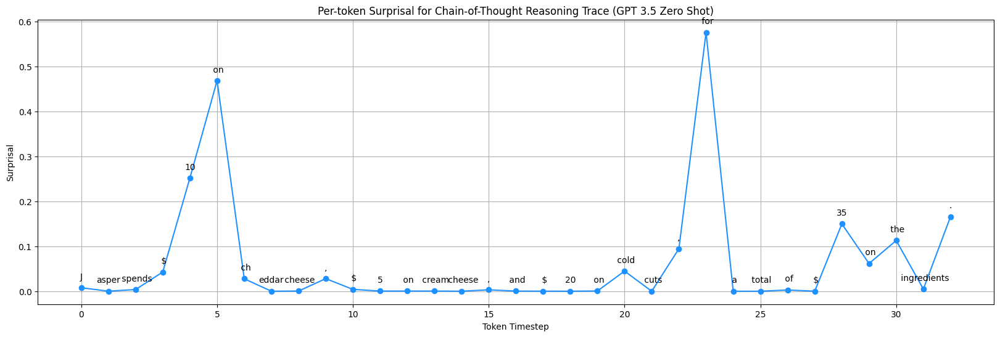

13


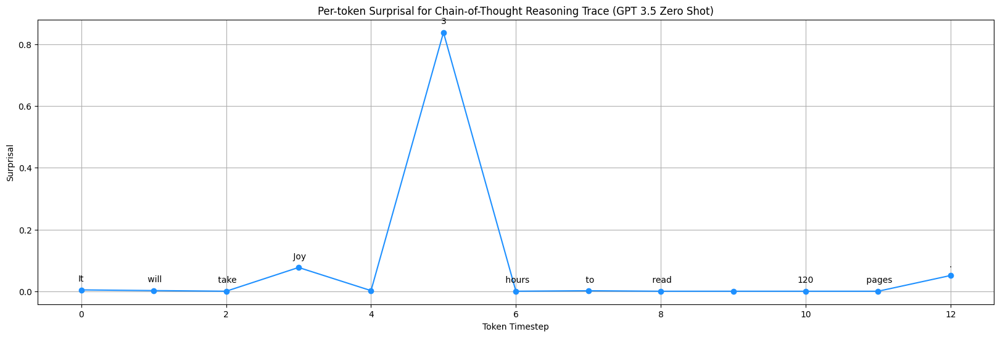

14


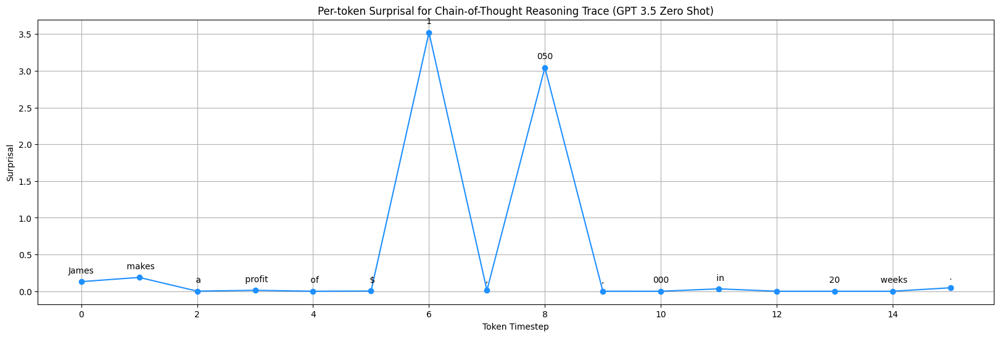

15


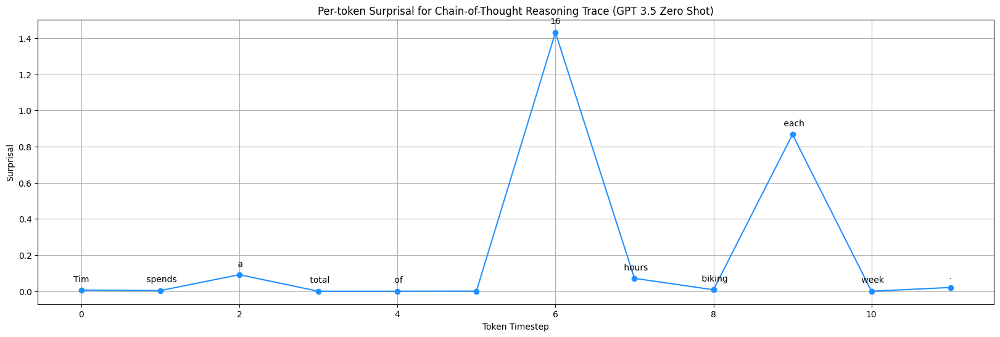

16


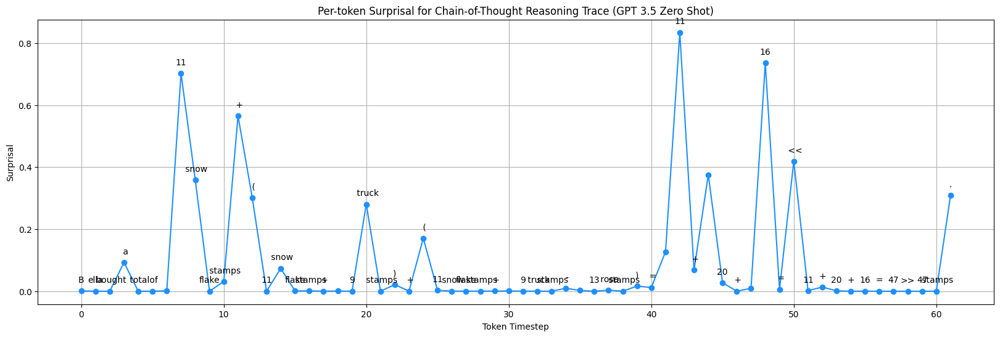

17


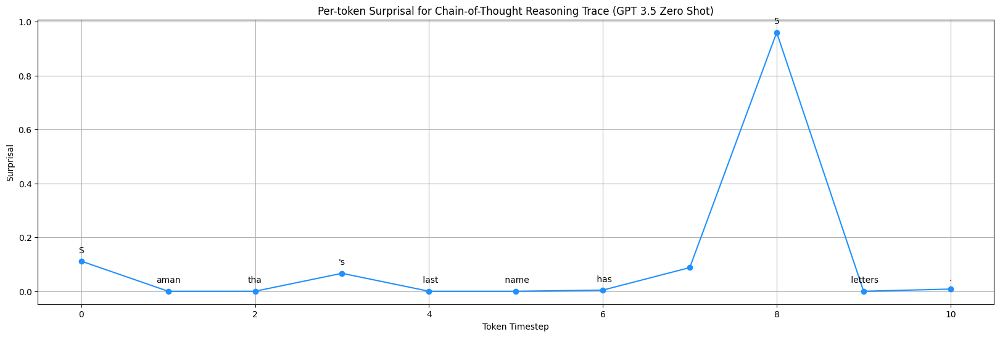

18


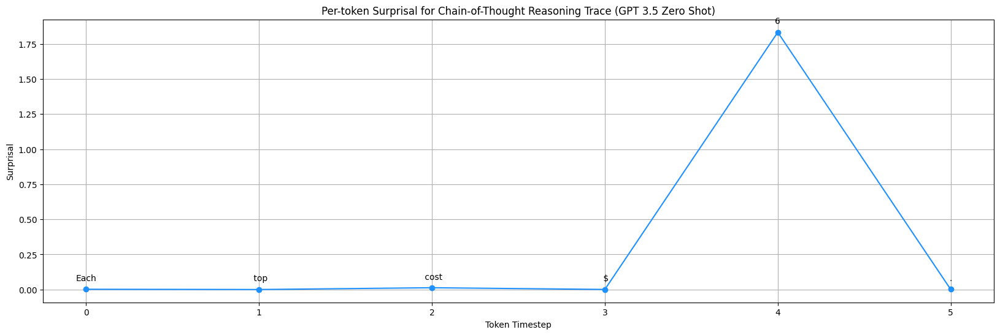

19


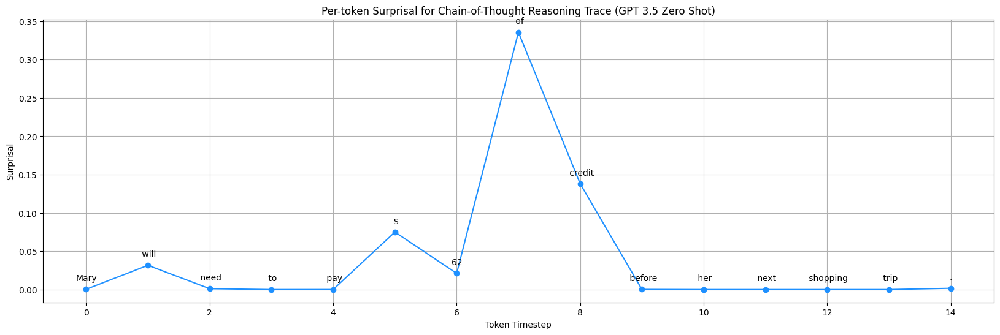

20


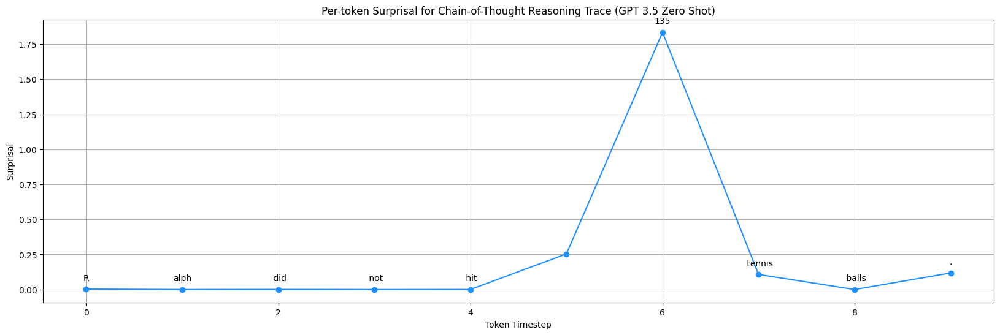

21


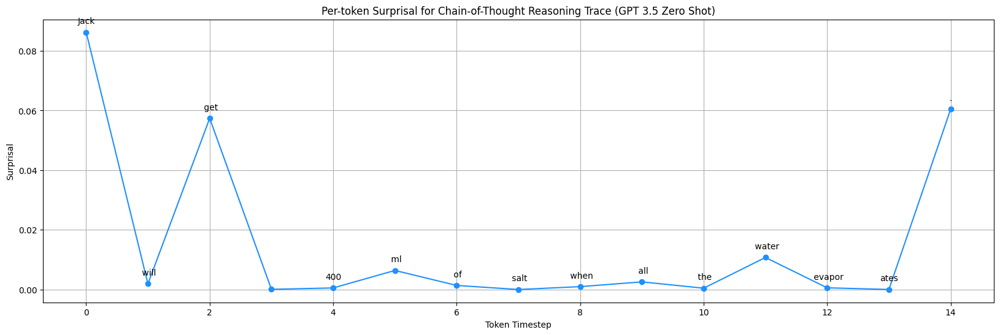

22


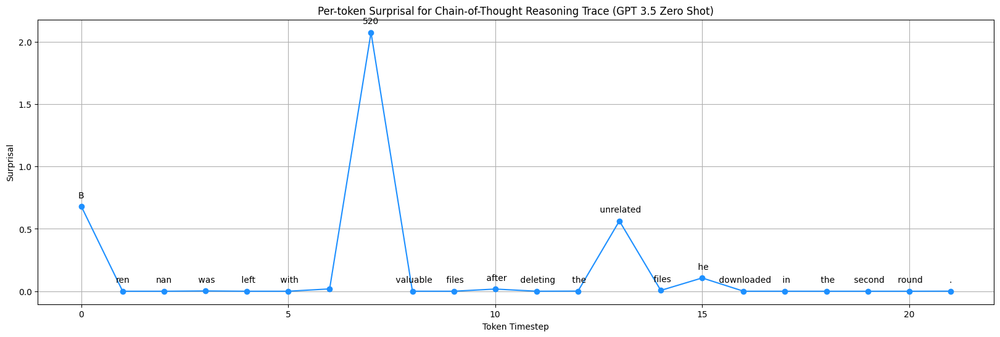

23


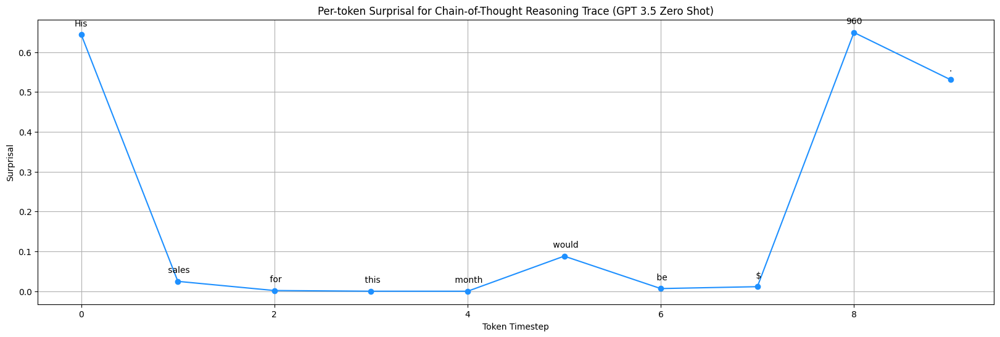

24


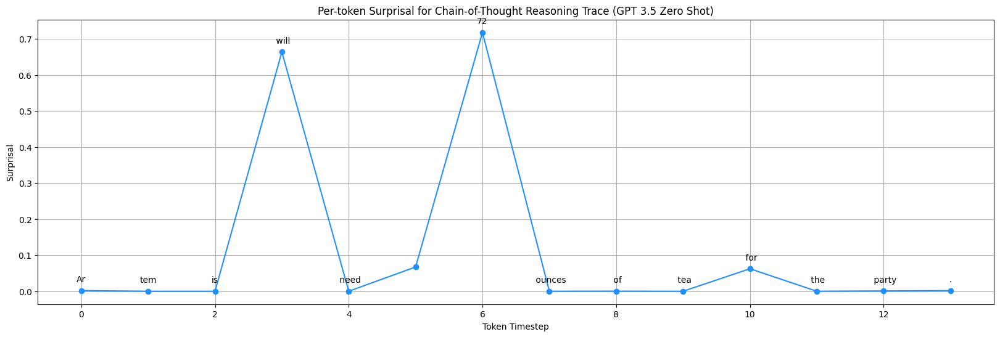

25


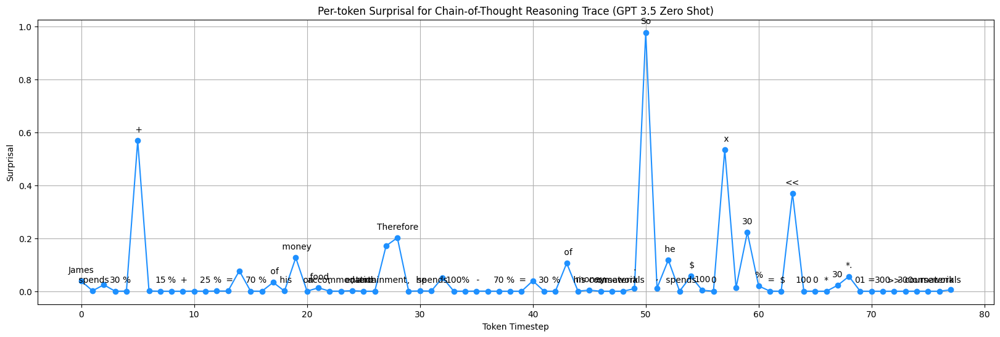

26


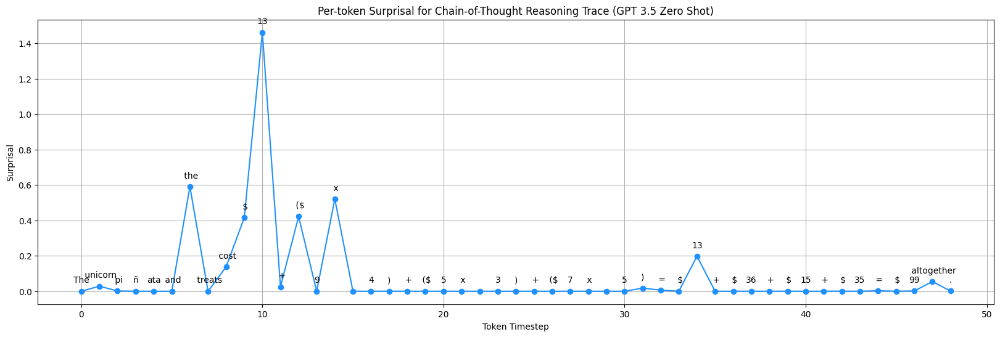

27


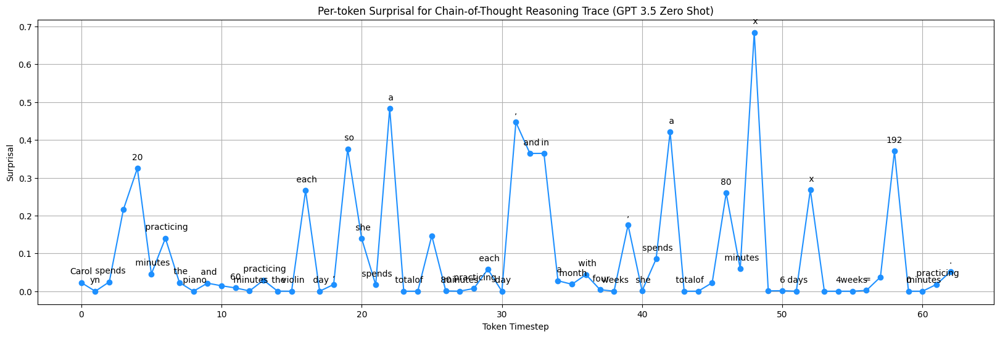

28


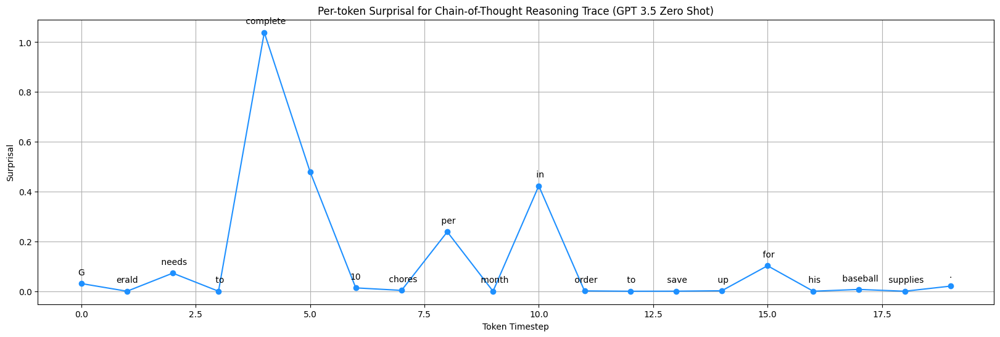

29


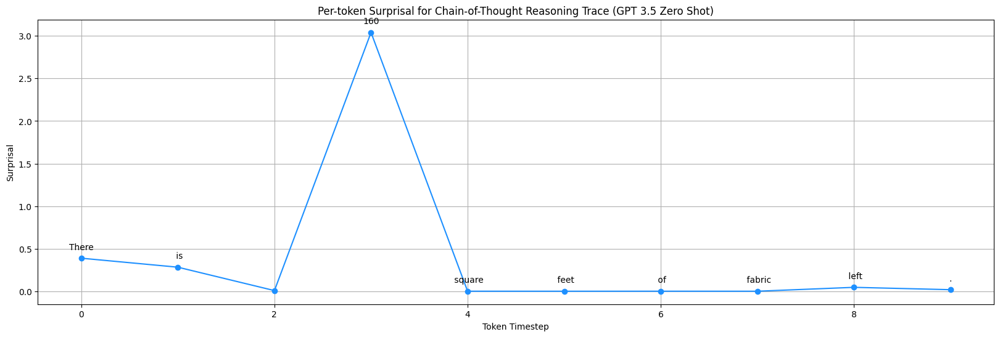

30


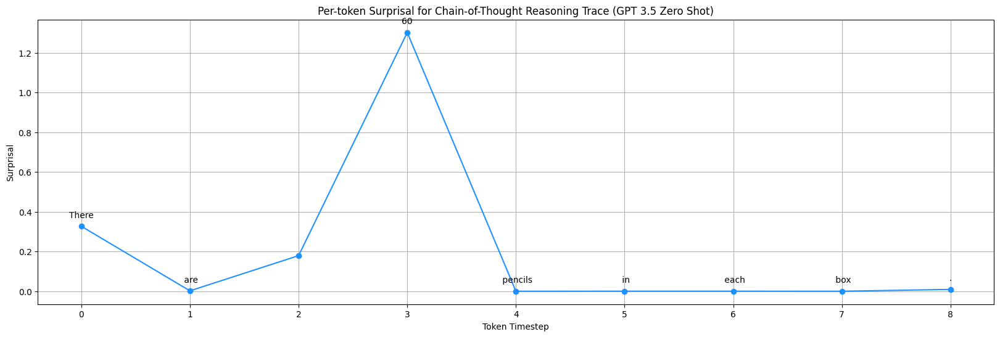

31


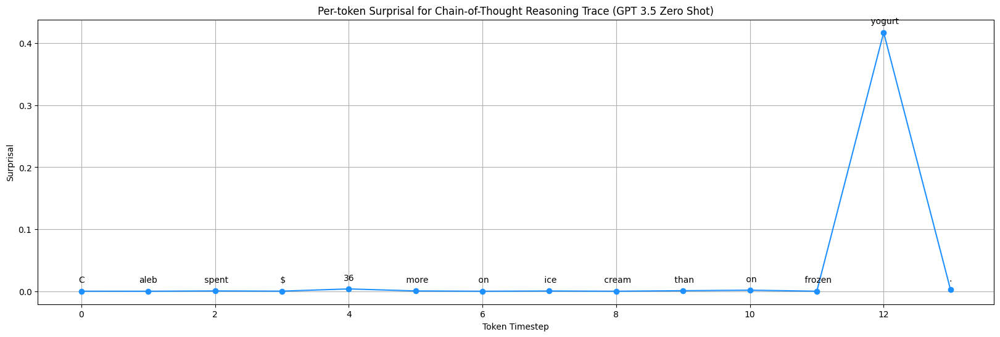

32


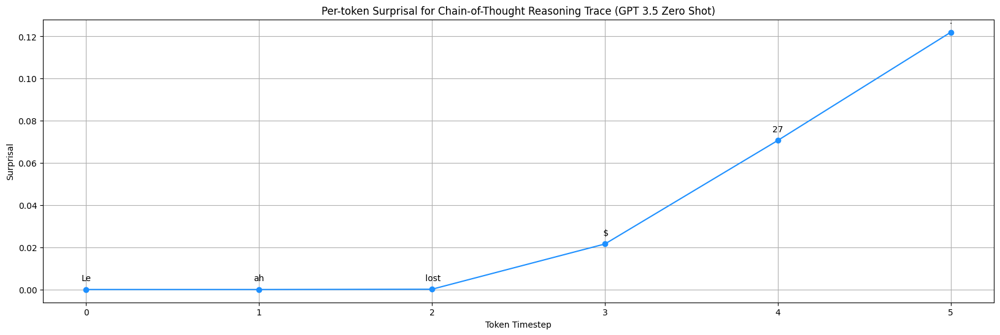

33


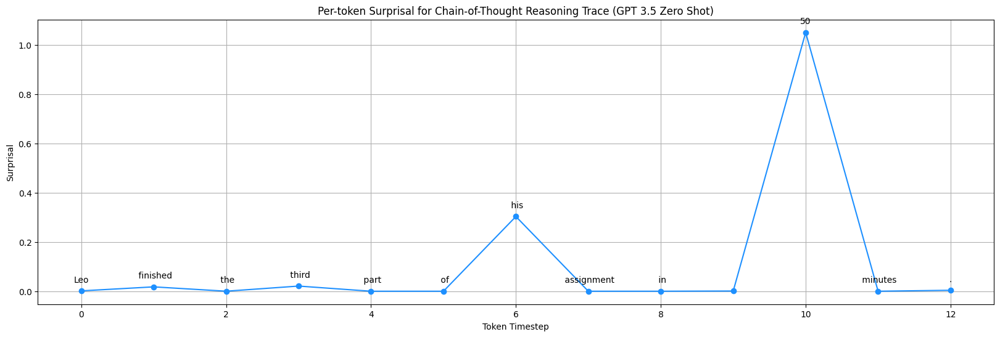

34


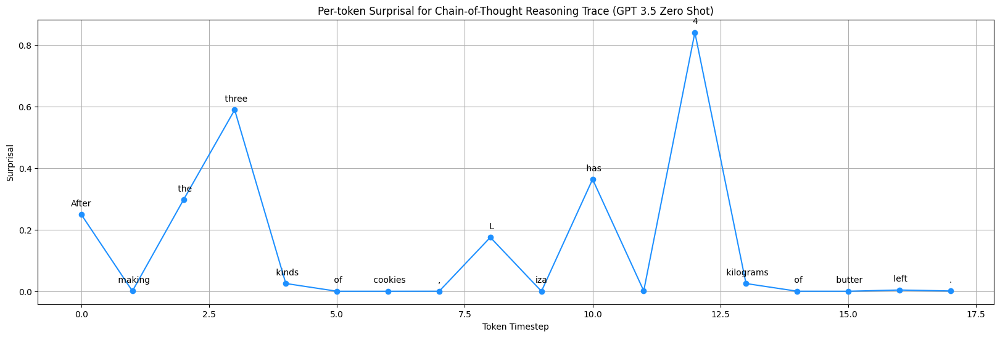

35


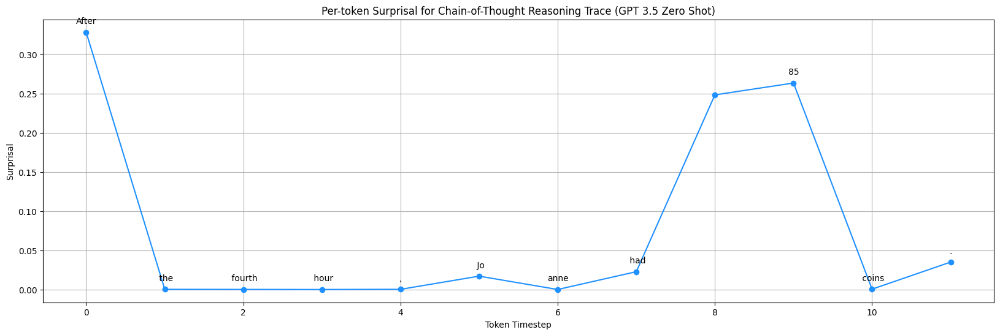

36


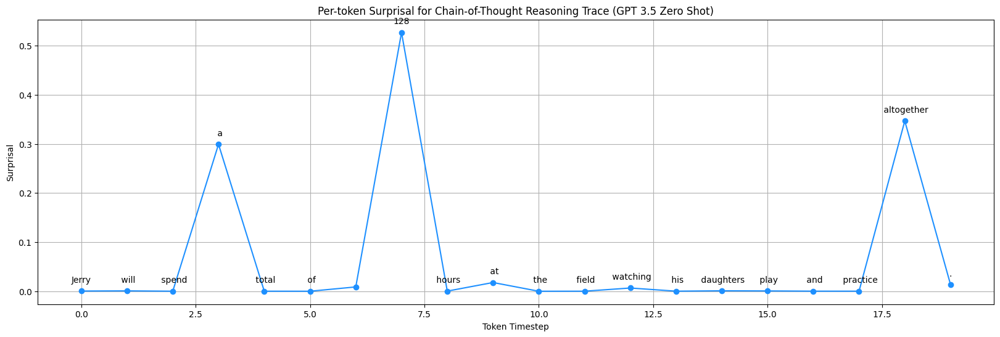

37


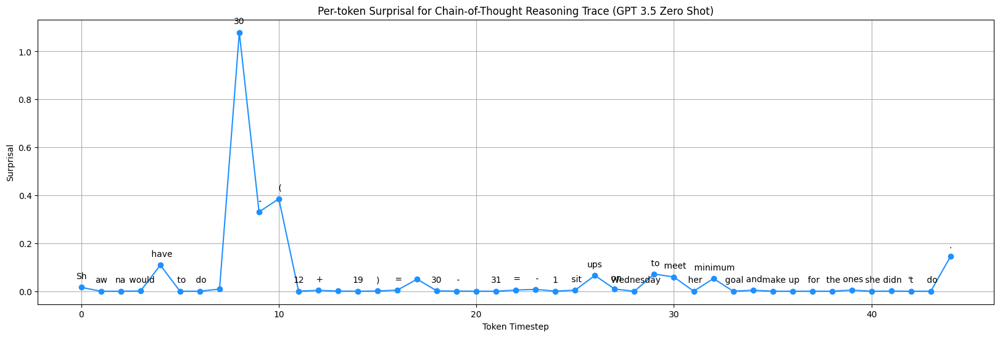

38


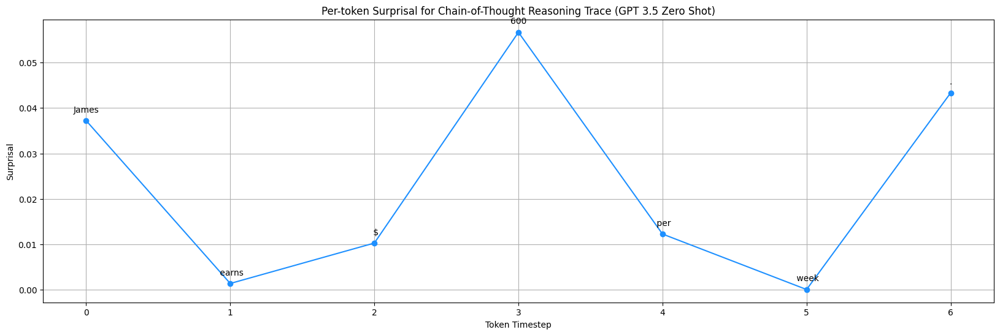

39


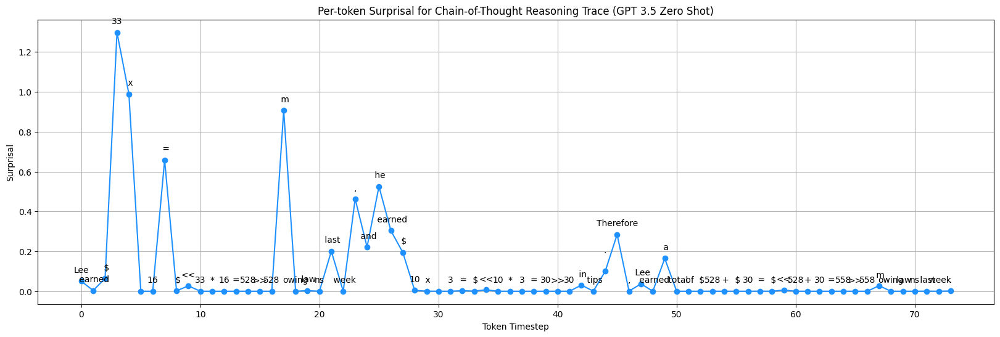

40


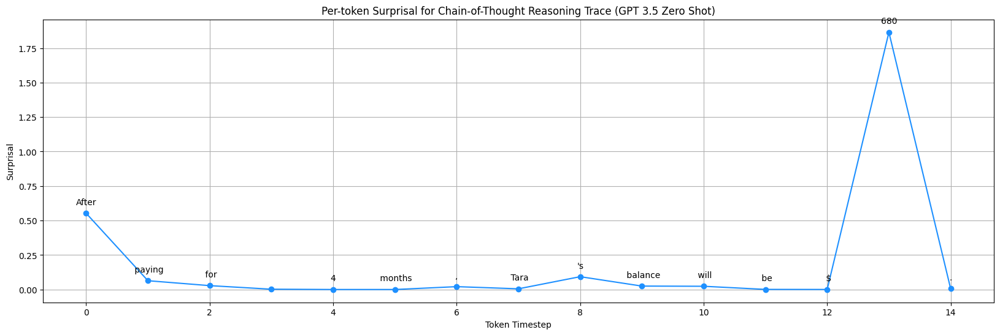

41


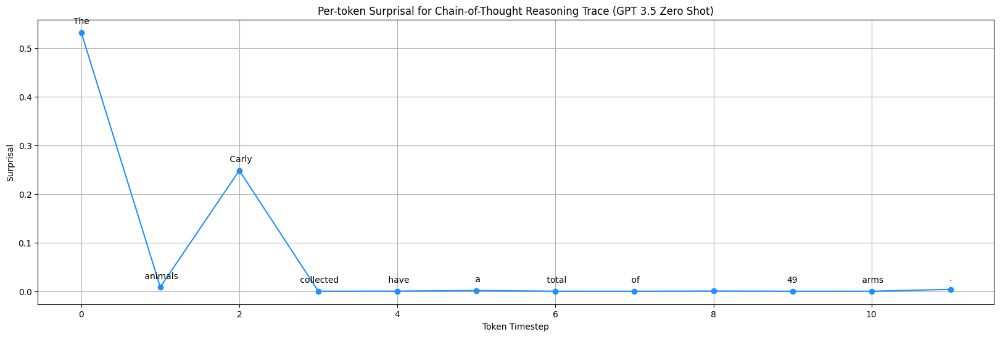

42


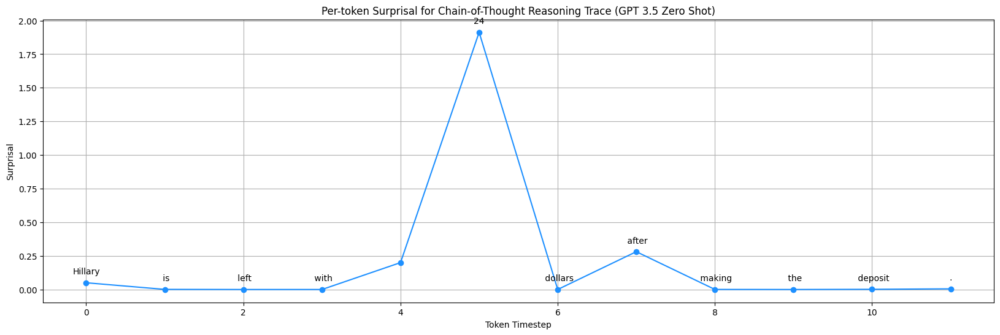

43


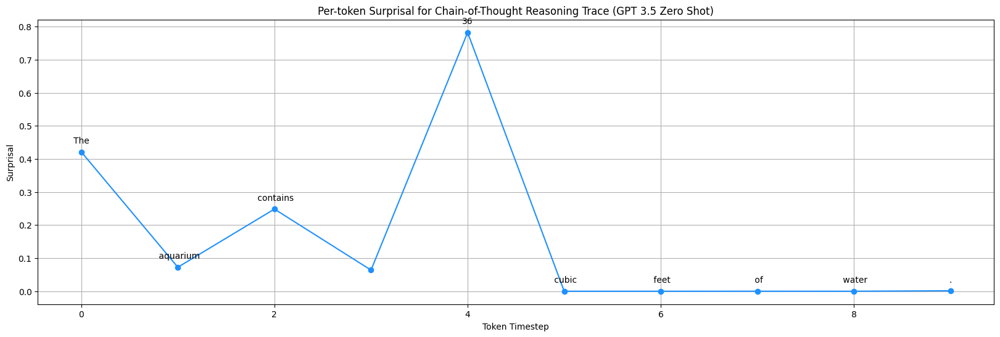

44


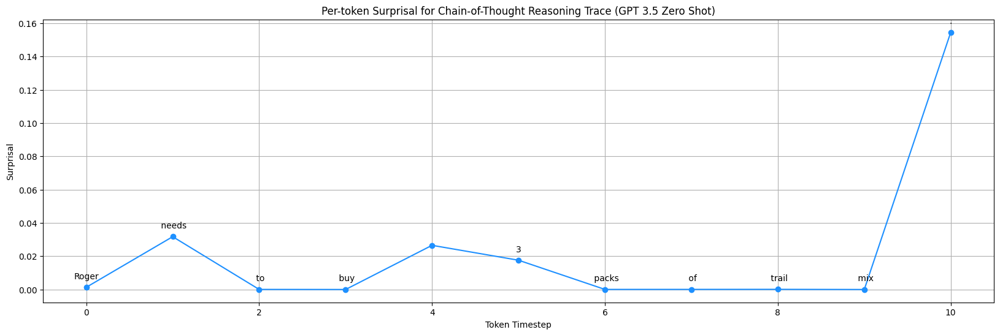

45


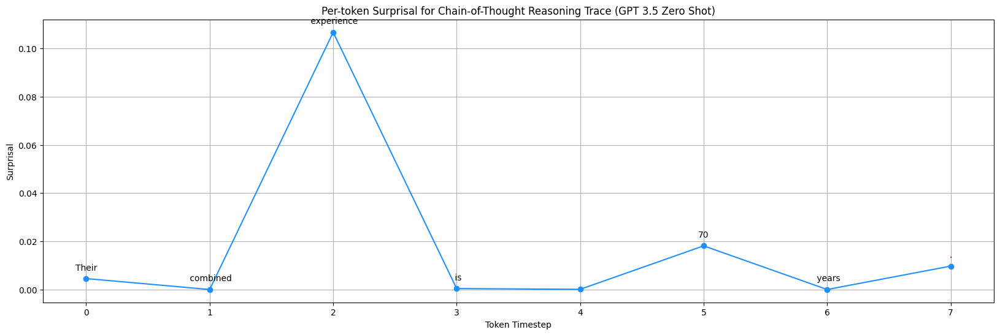

46


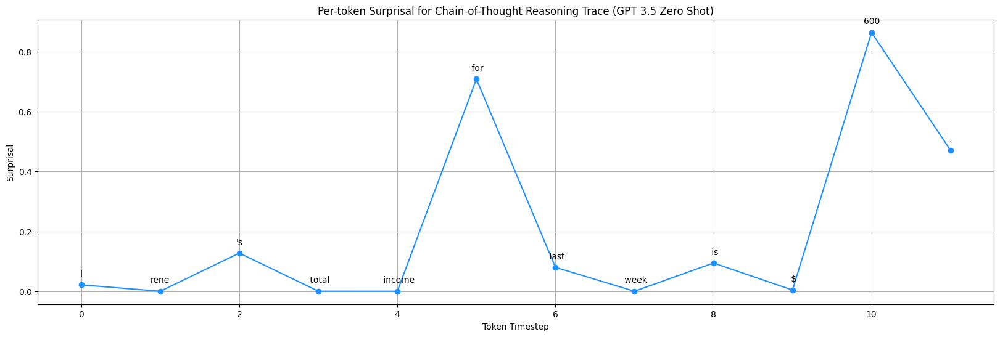

47


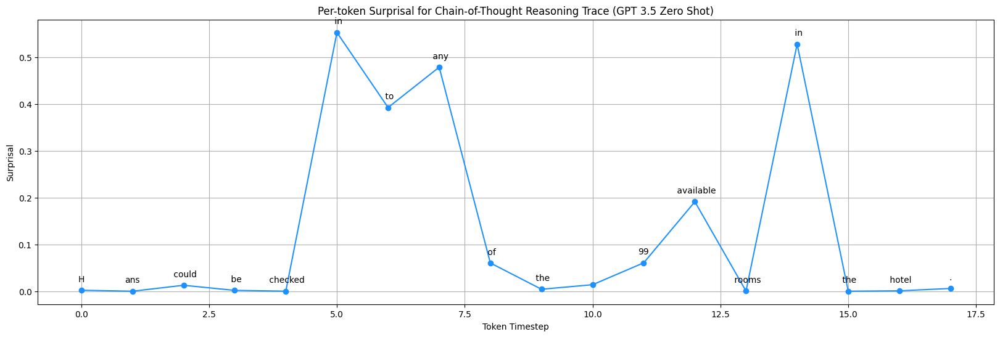

48


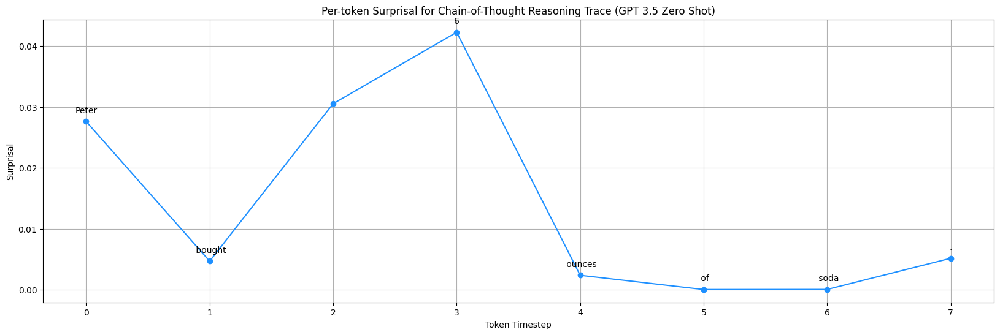

49


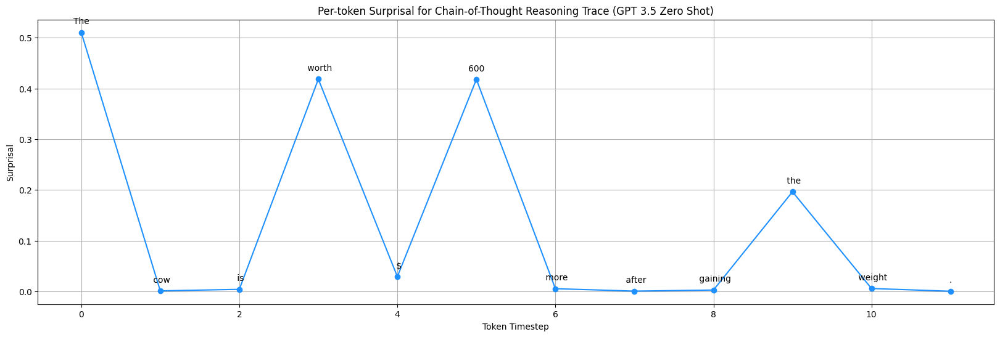

50


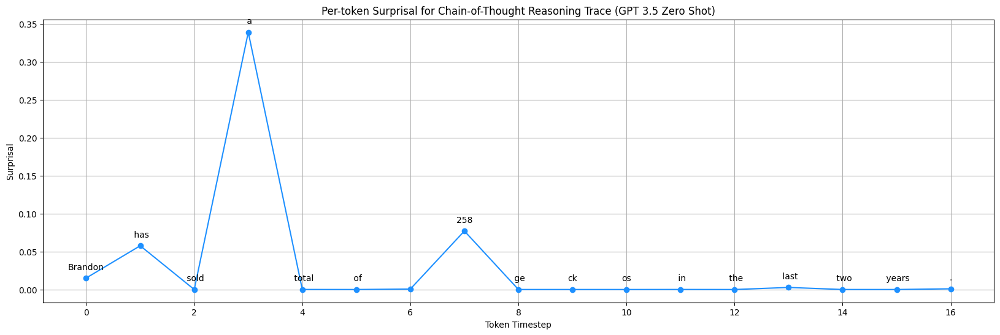

51


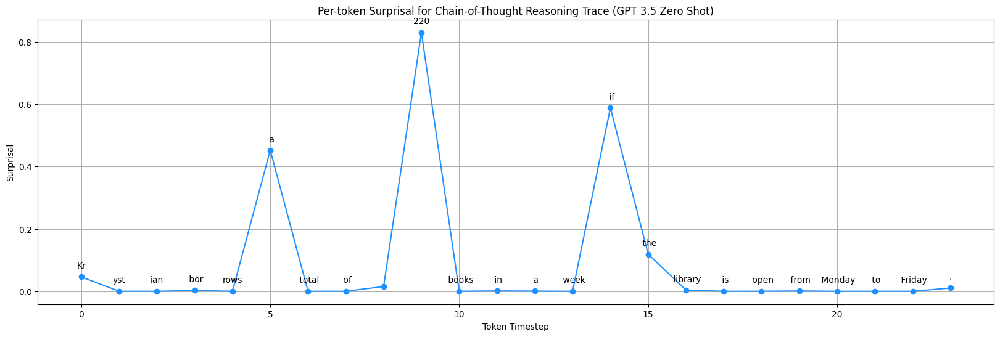

52


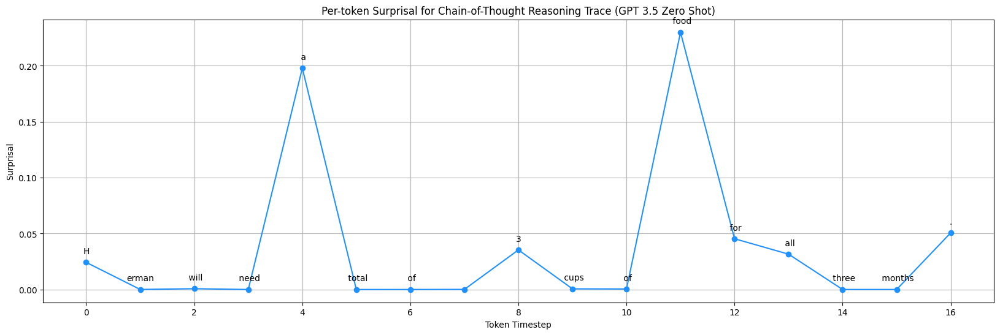

53


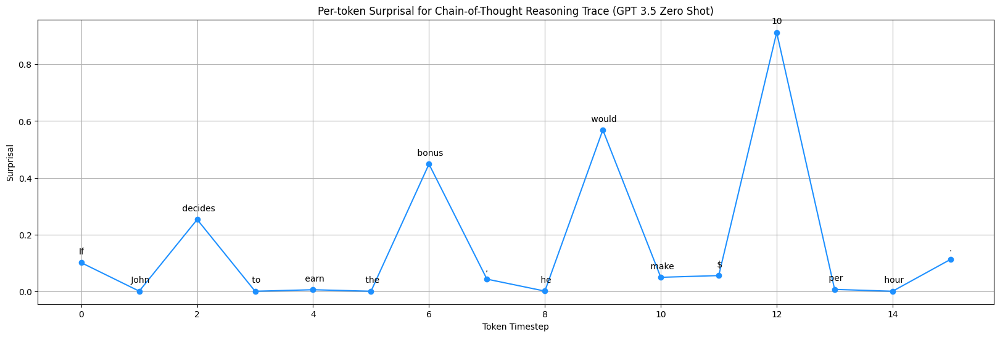

54


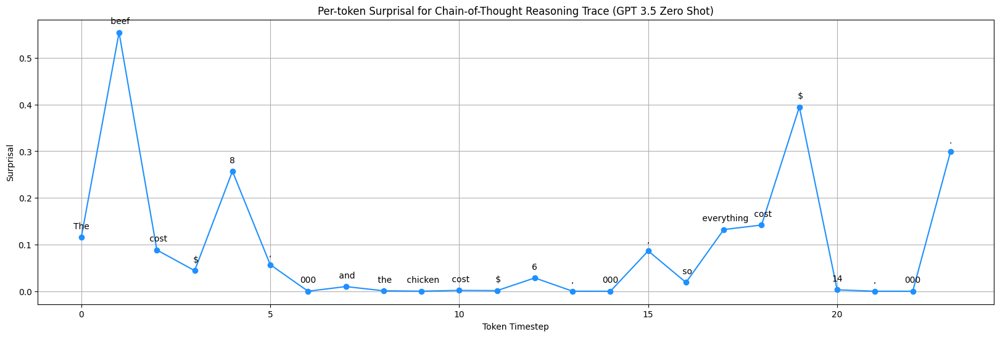

55


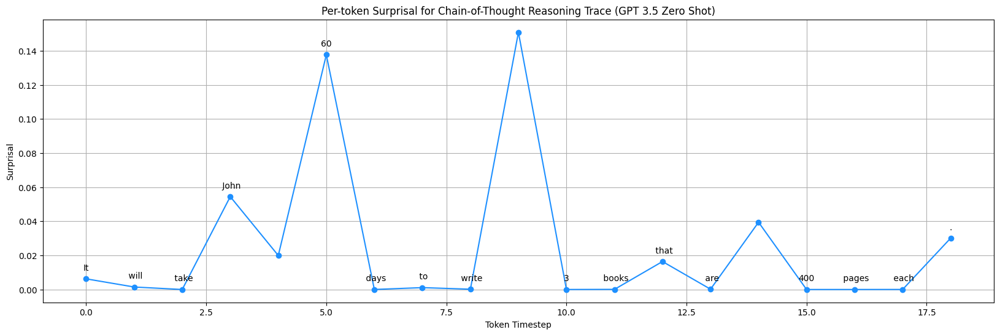

56


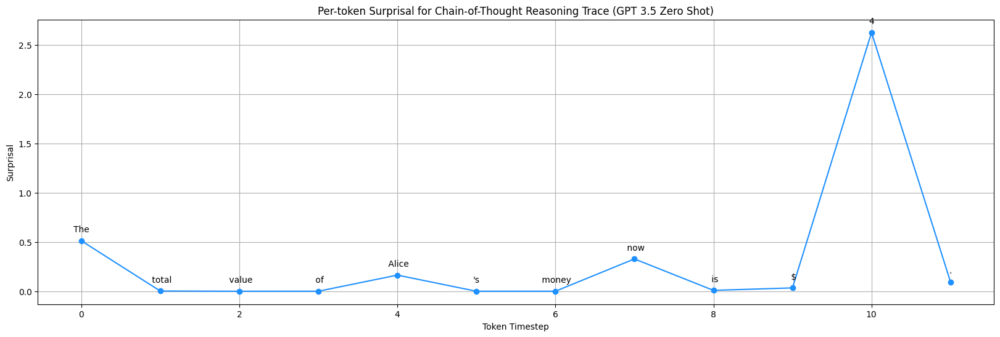

57


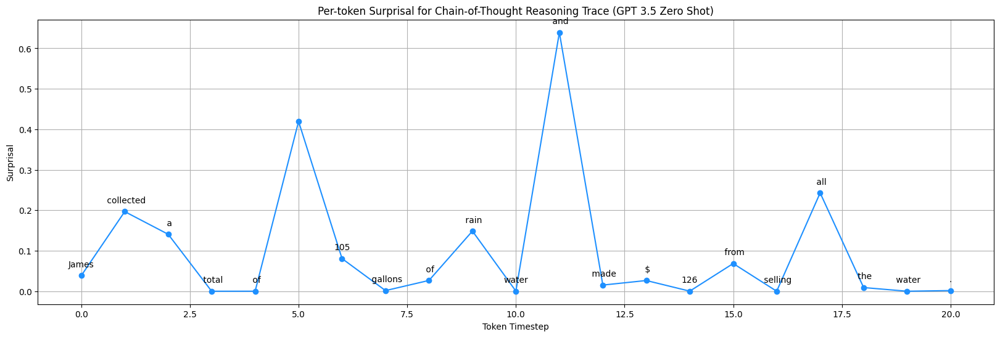

58


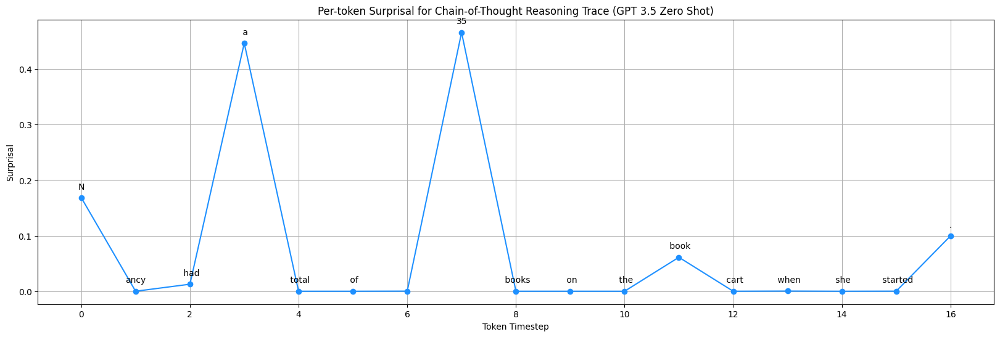

59


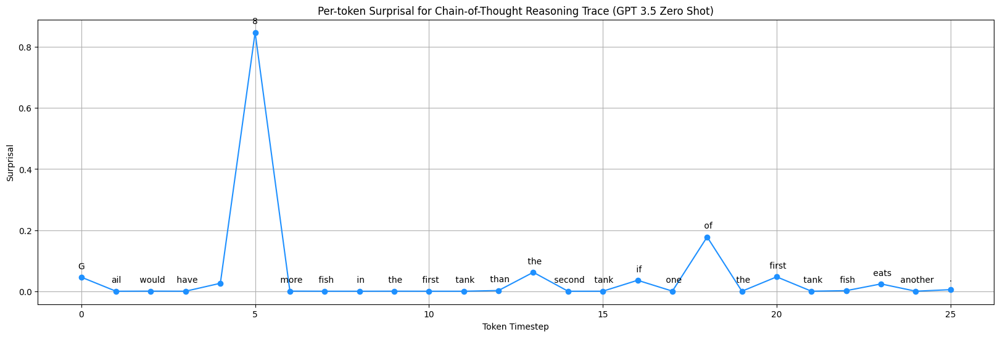

60


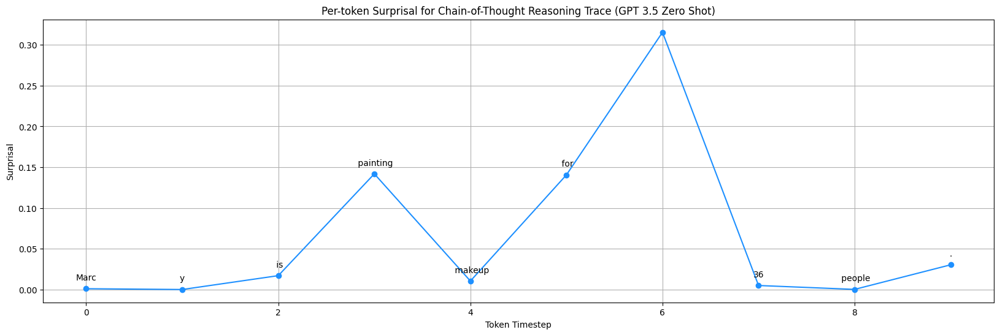

61


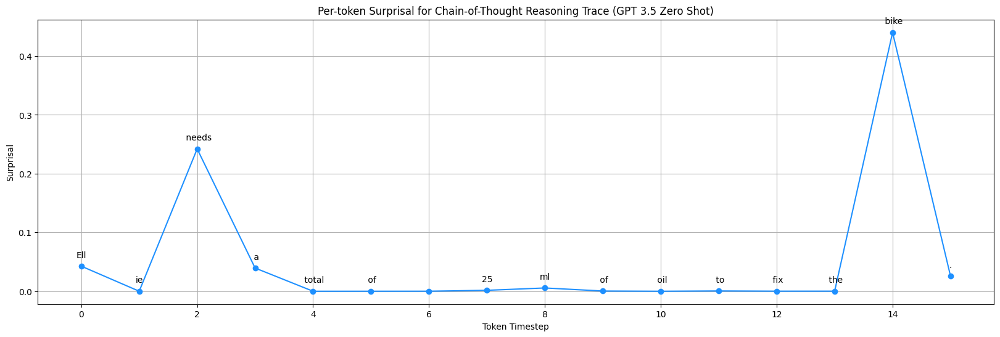

62


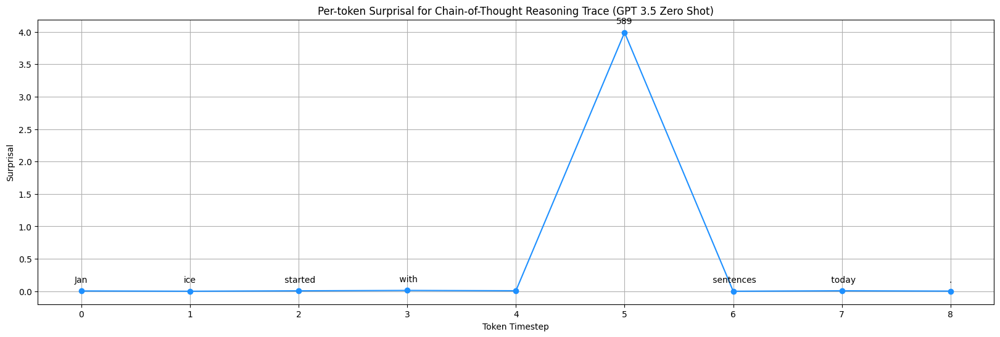

63


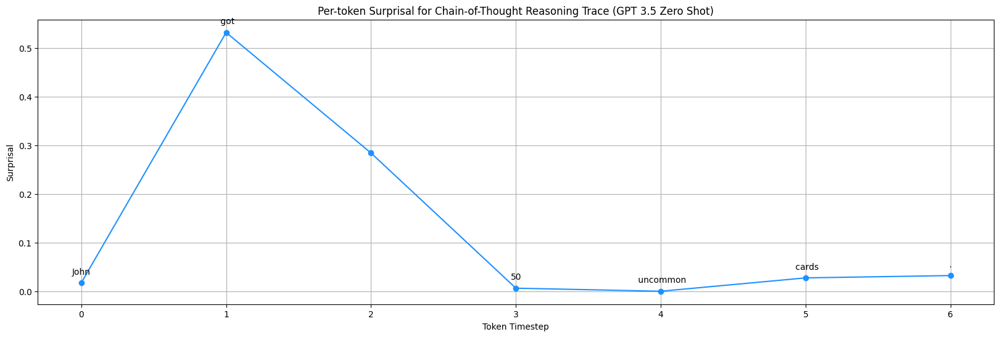

64


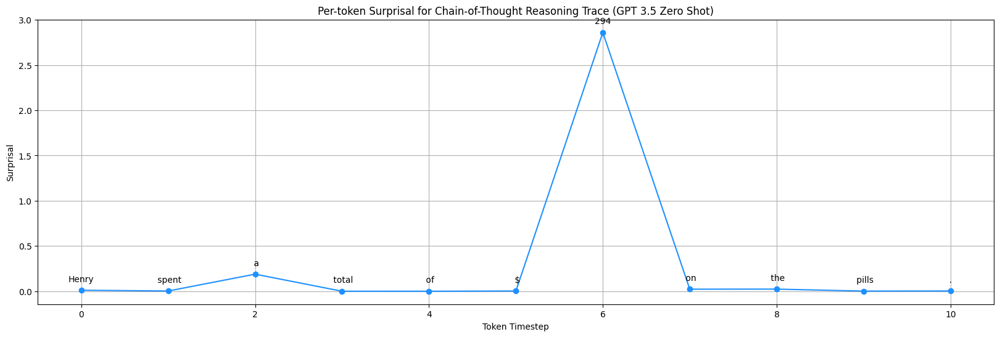

65


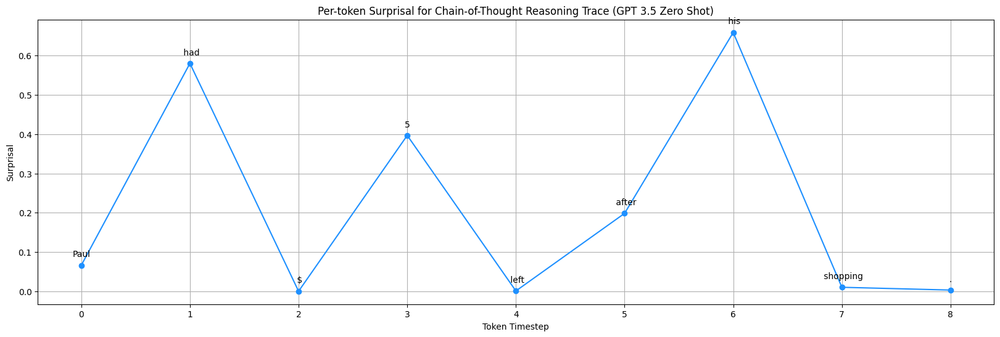

66


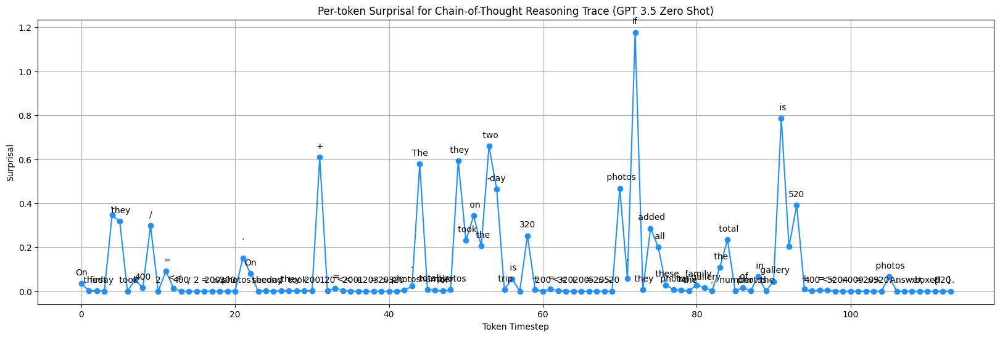

67


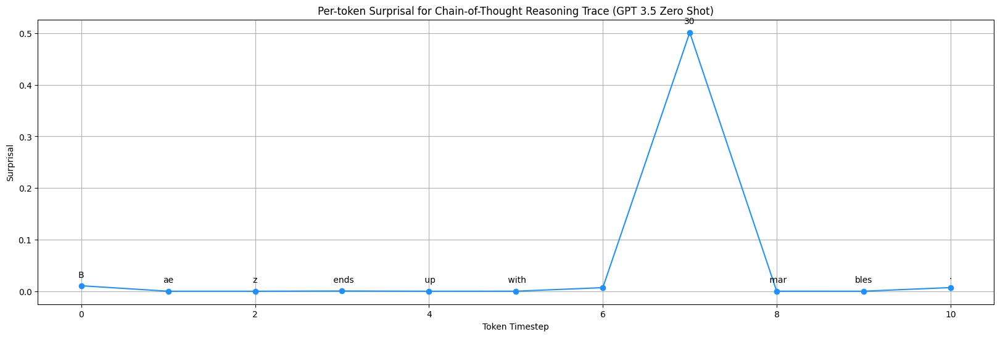

68


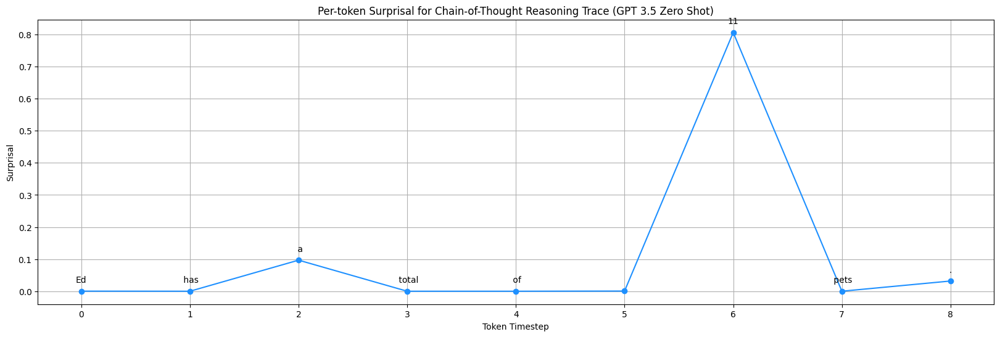

69


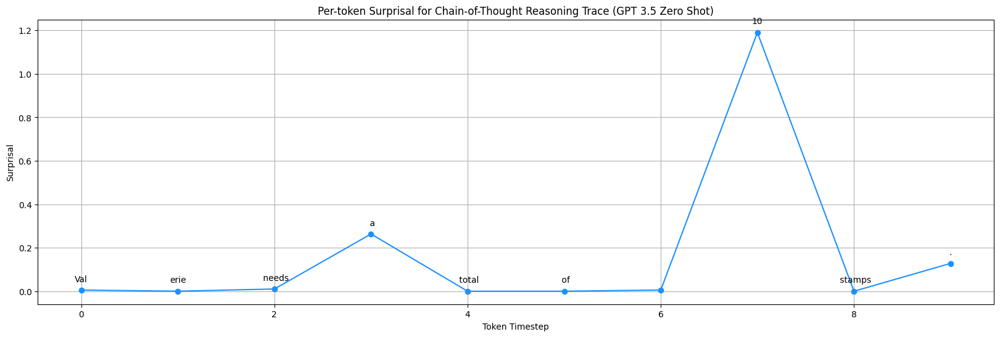

70


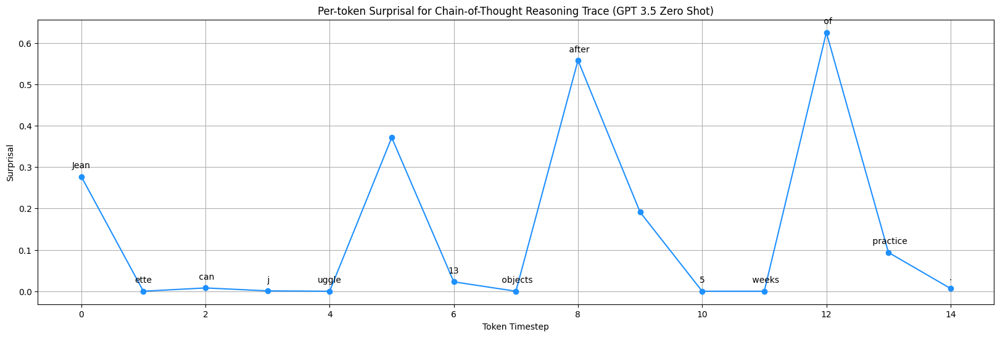

71


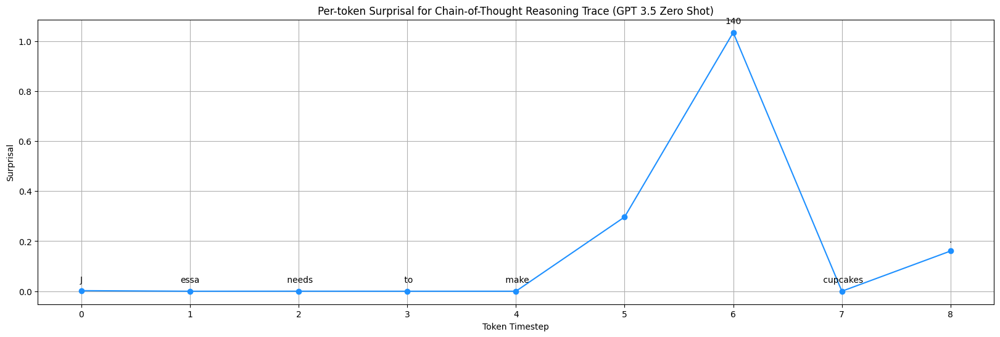

72


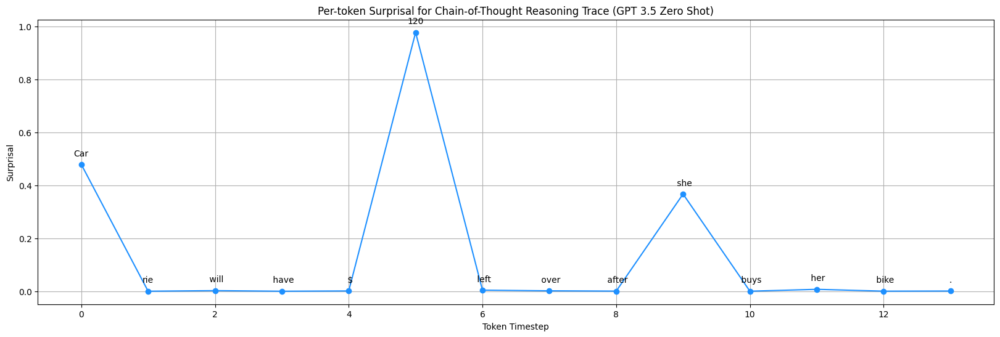

73


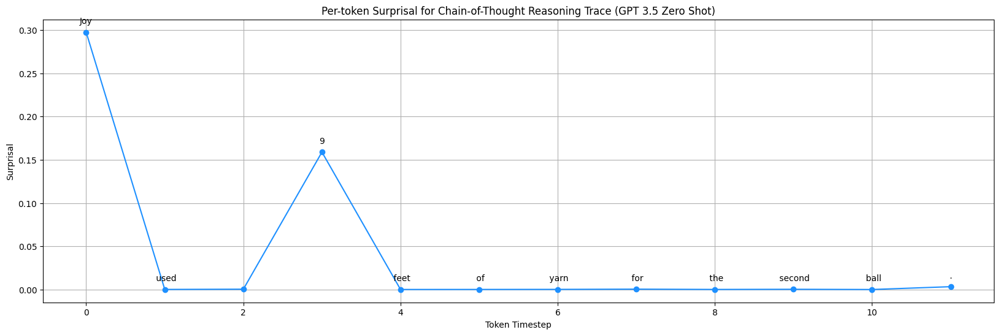

74


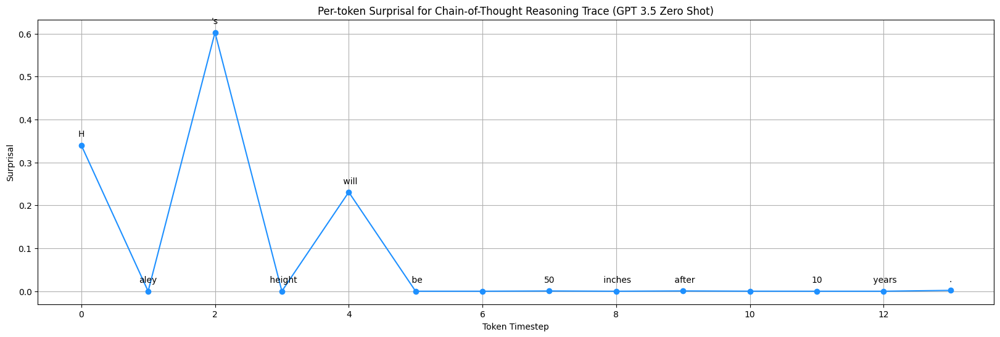

75


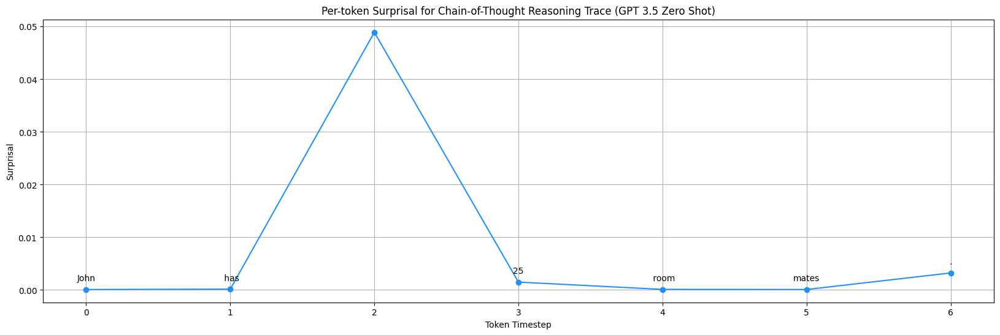

76


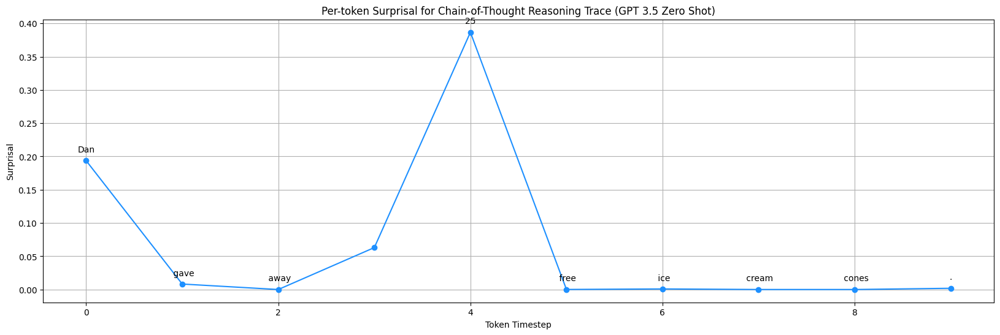

77


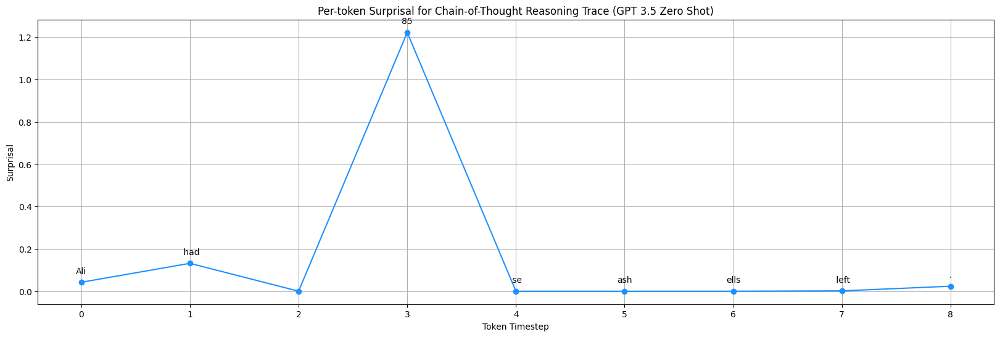

78


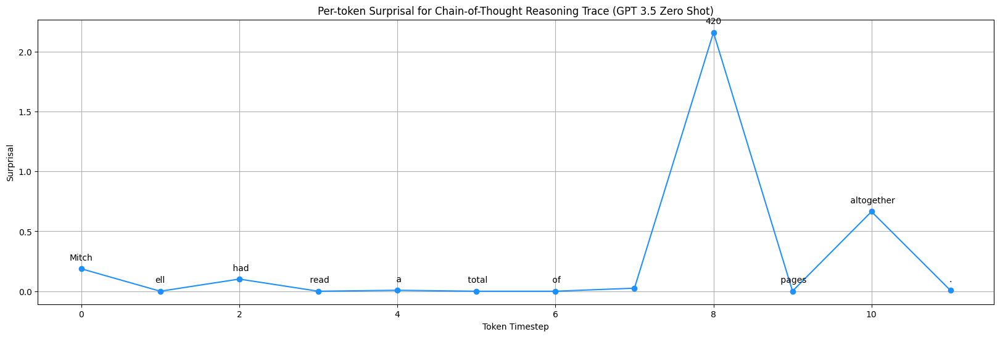

79


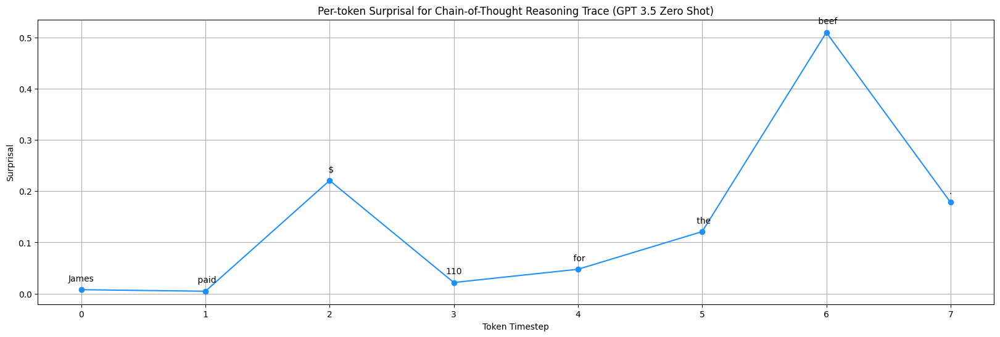

80


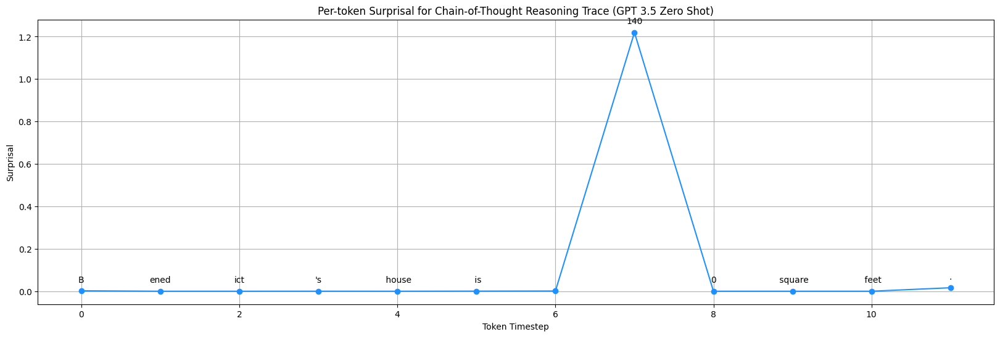

81


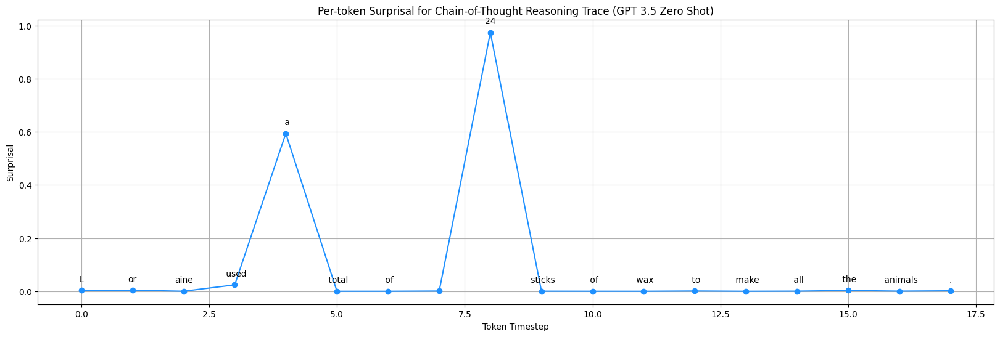

82


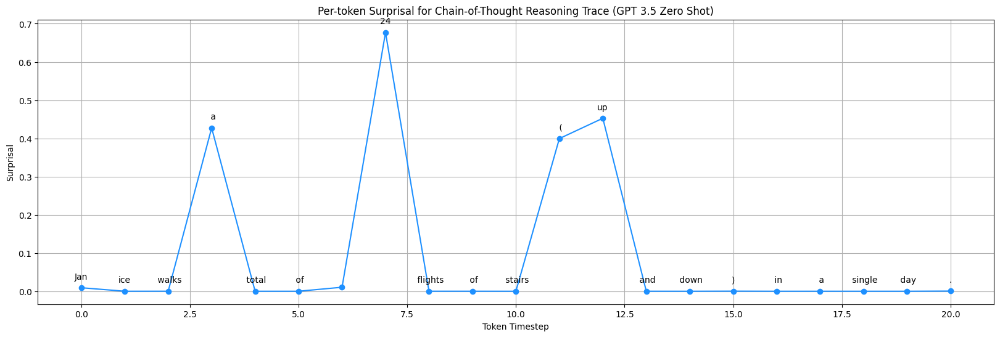

83


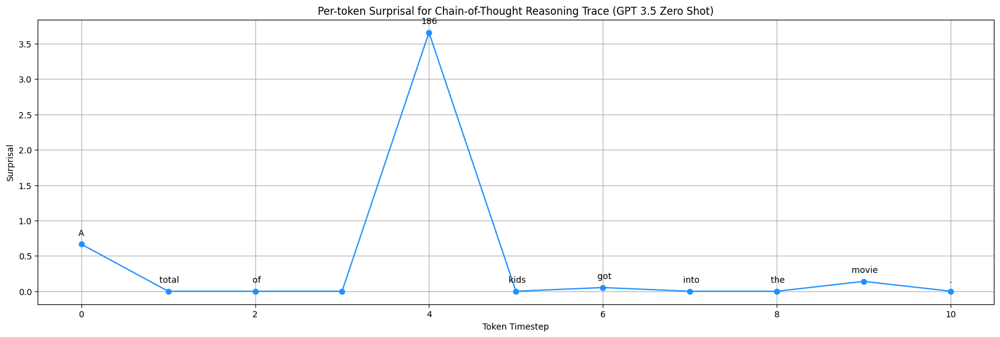

84


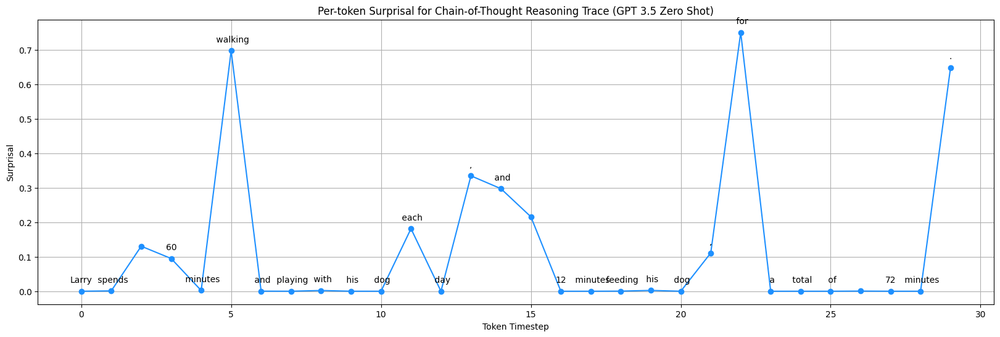

85


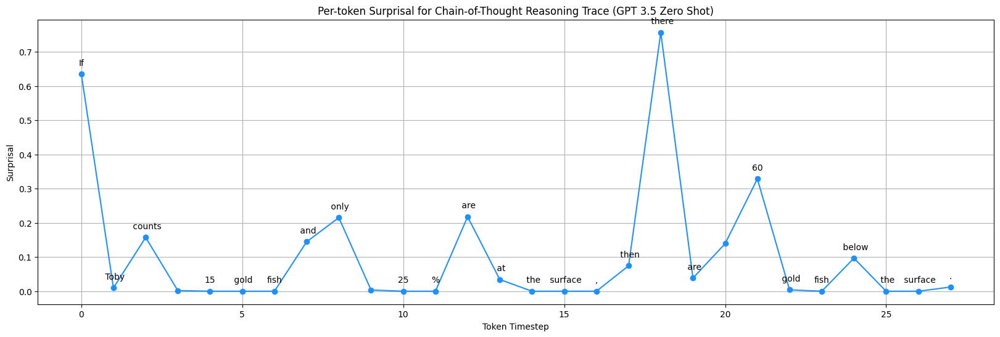

86


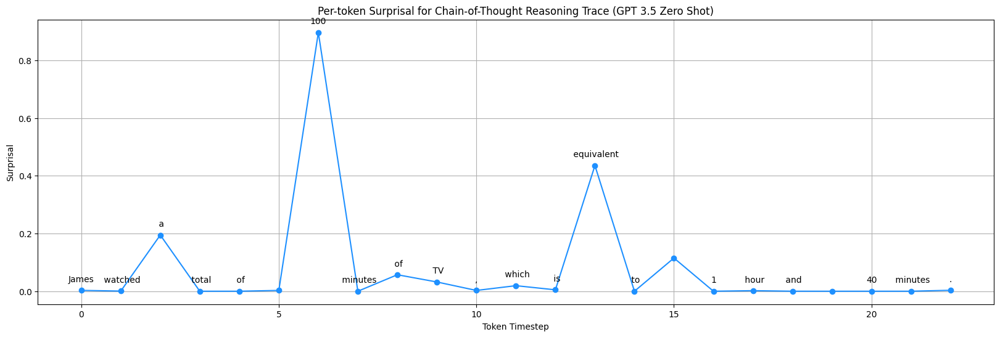

87


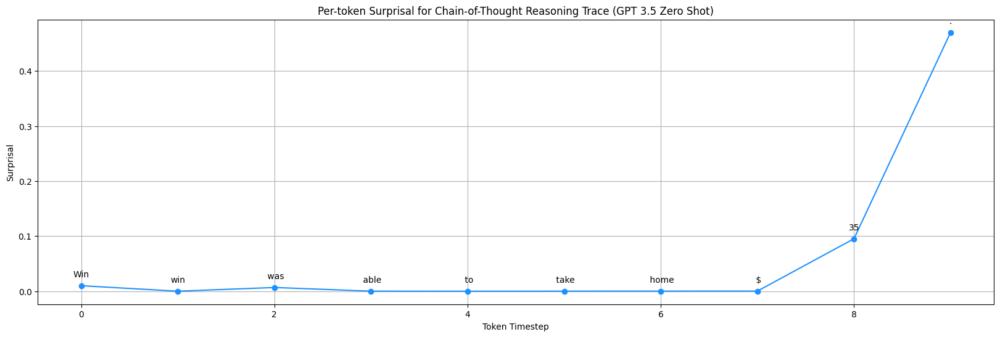

88


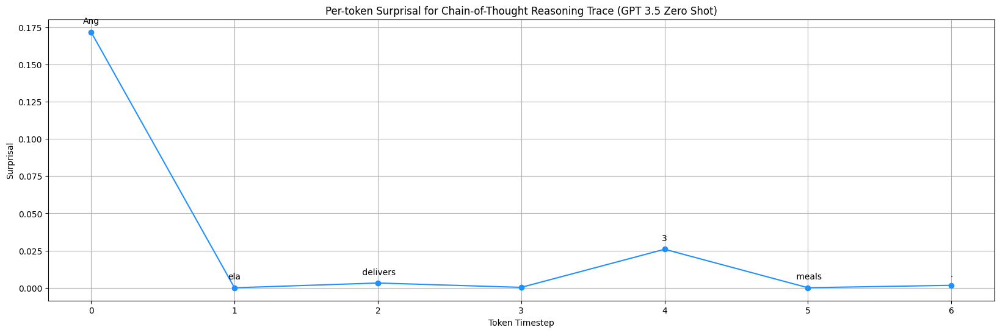

89


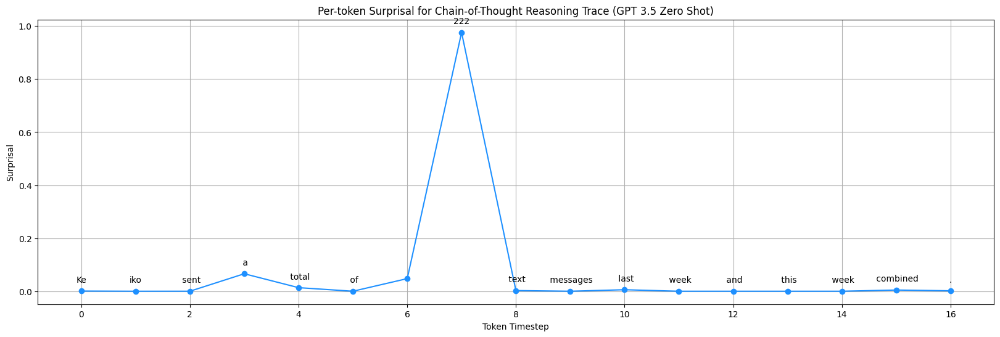

90


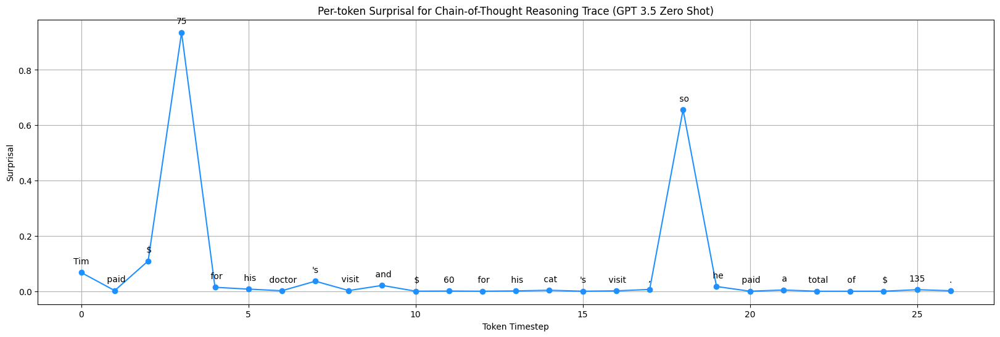

91


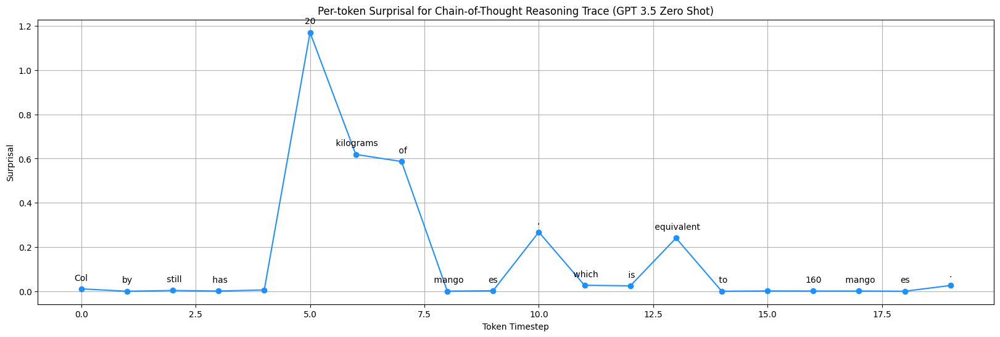

92


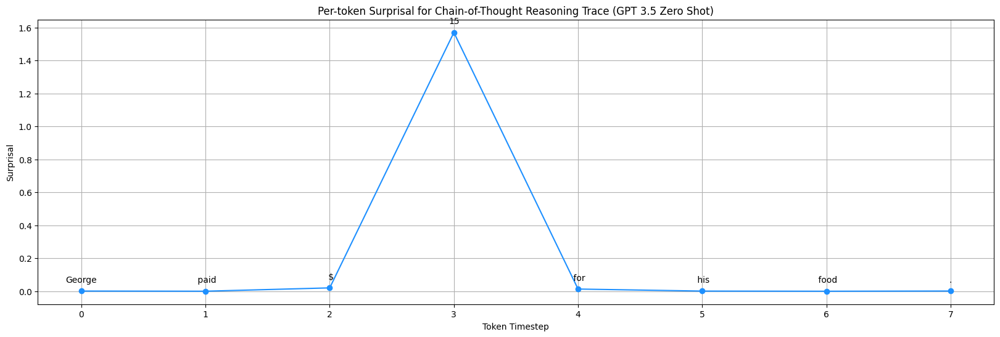

93


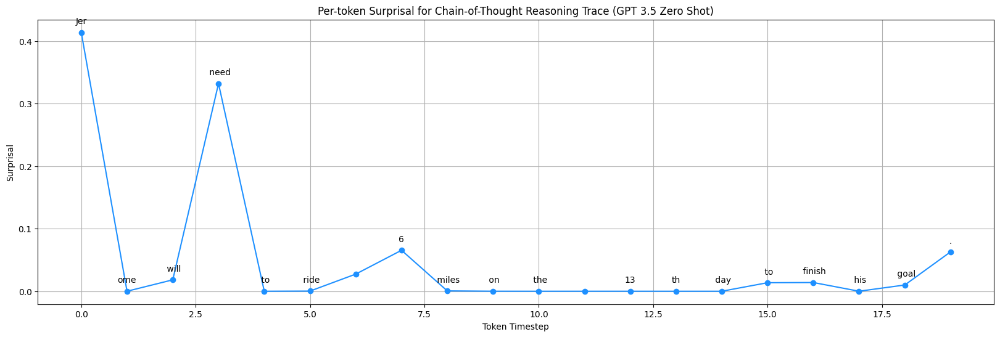

94


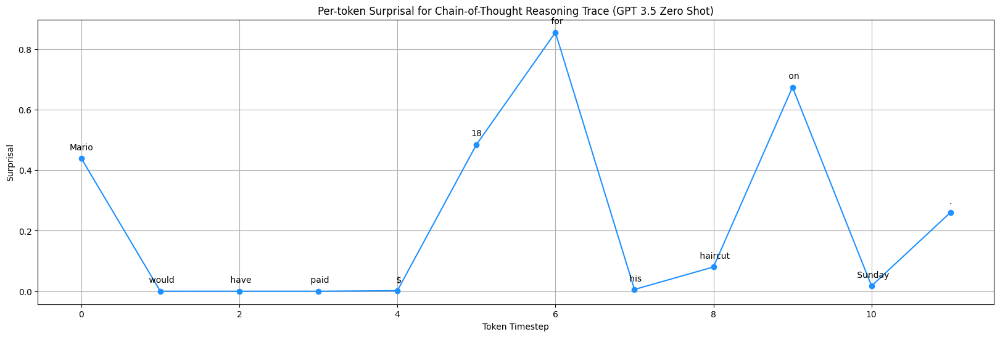

95


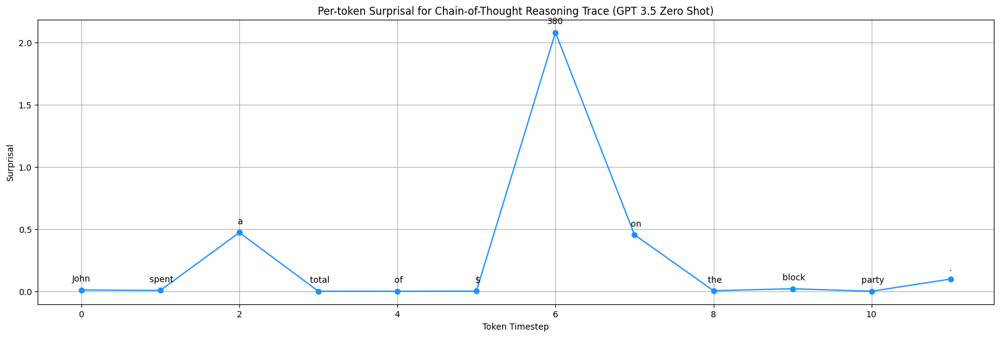

96


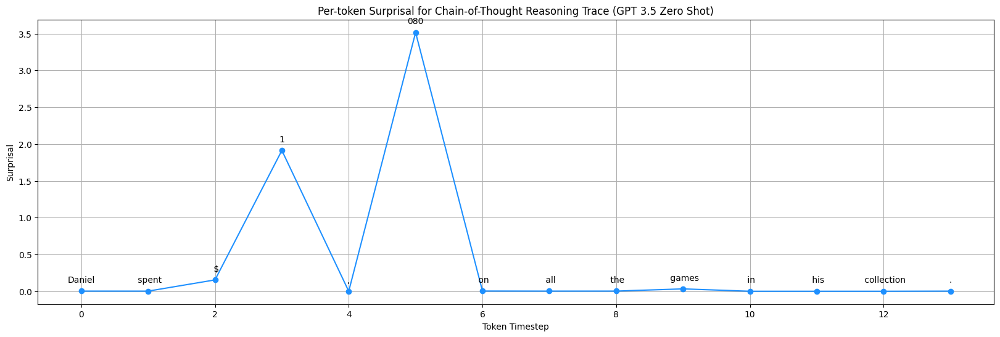

97


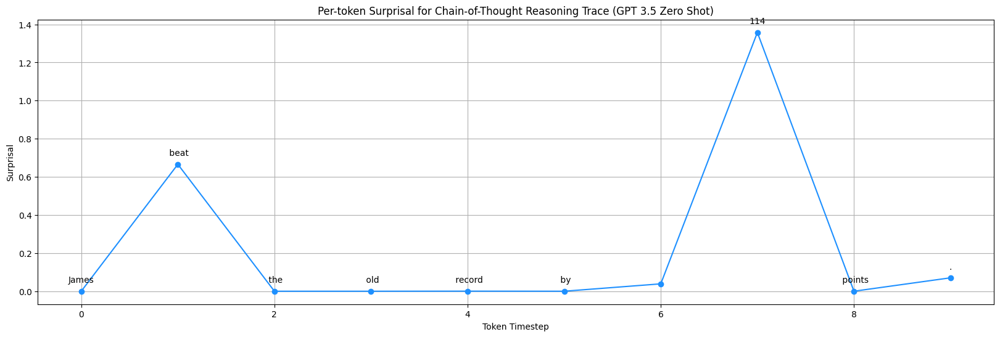

98


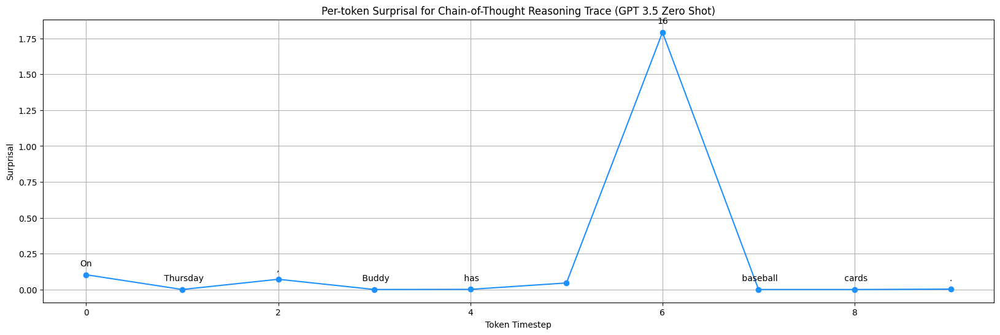

99


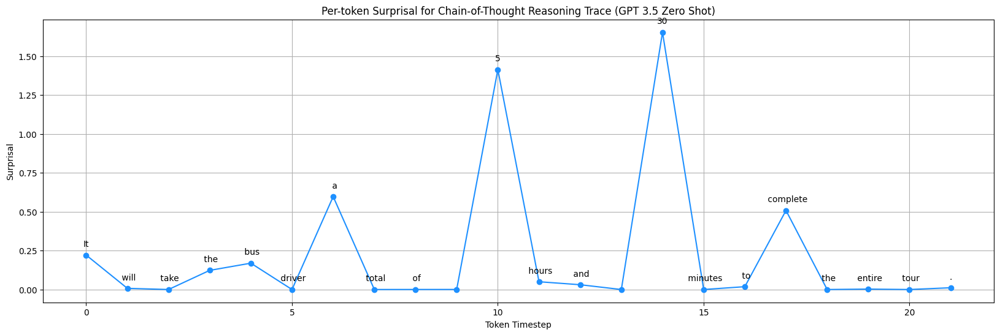

100


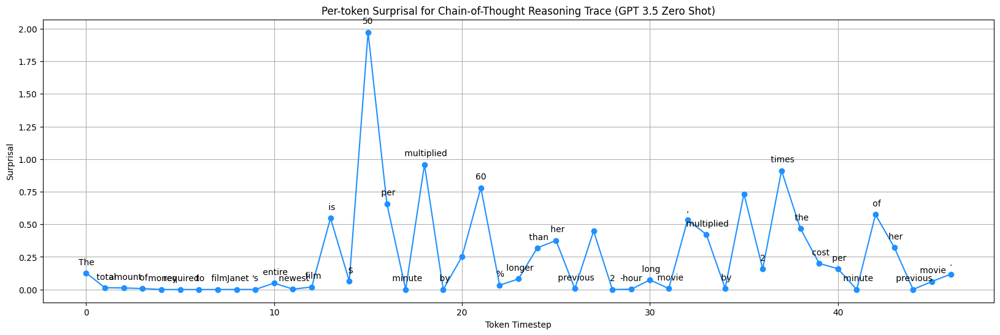

101


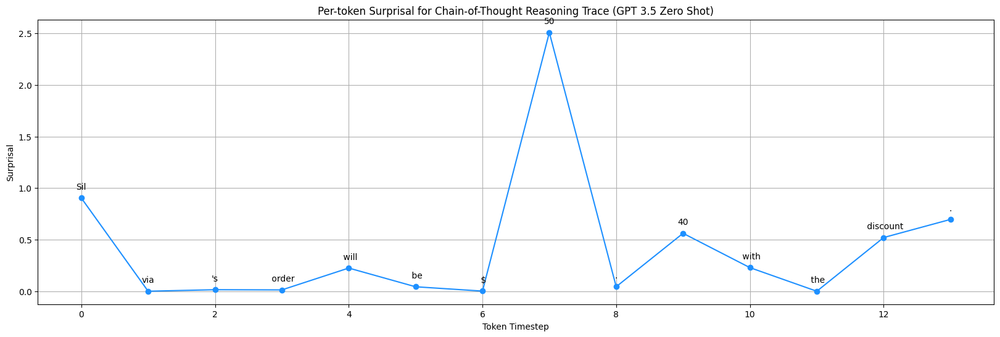

102


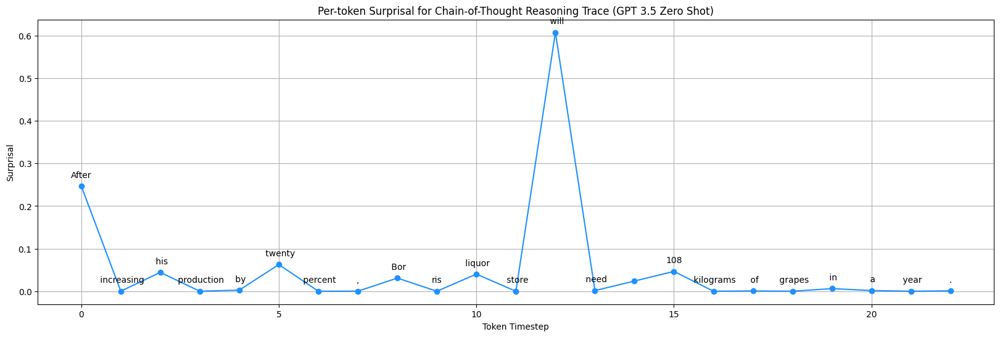

103


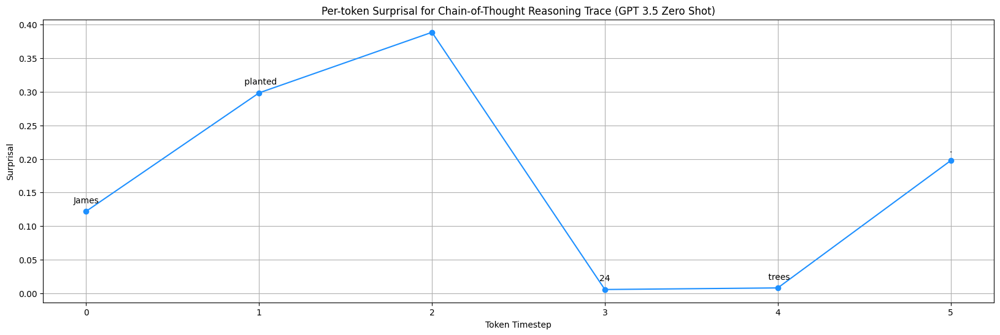

104


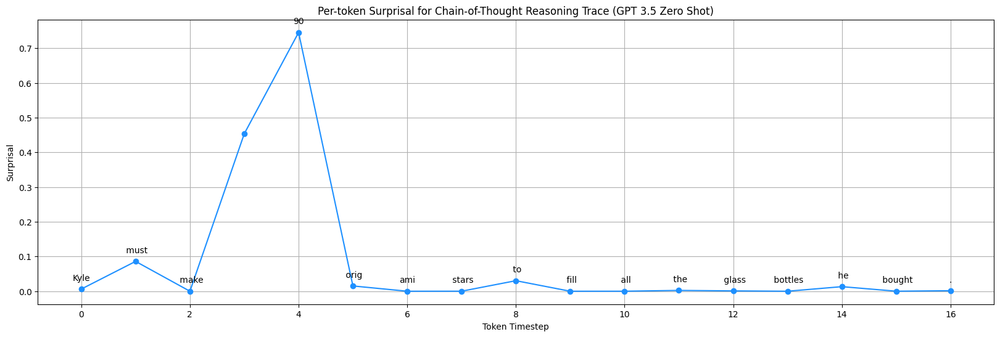

105


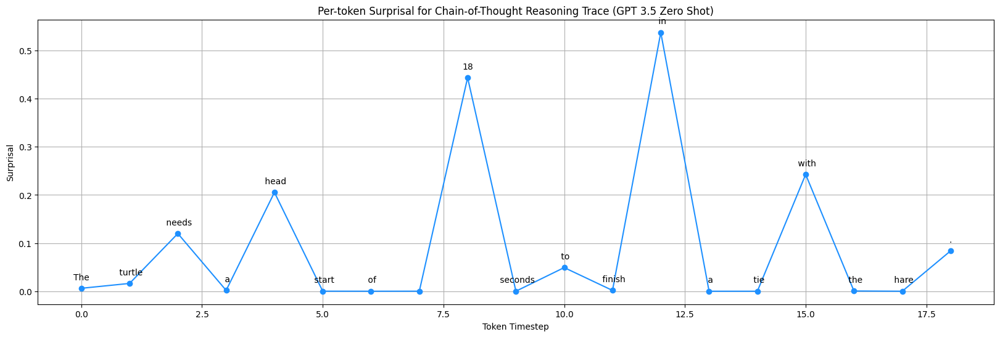

106


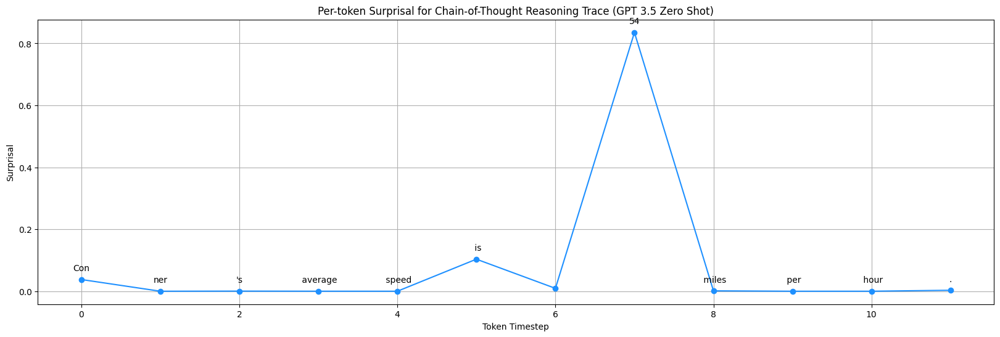

107


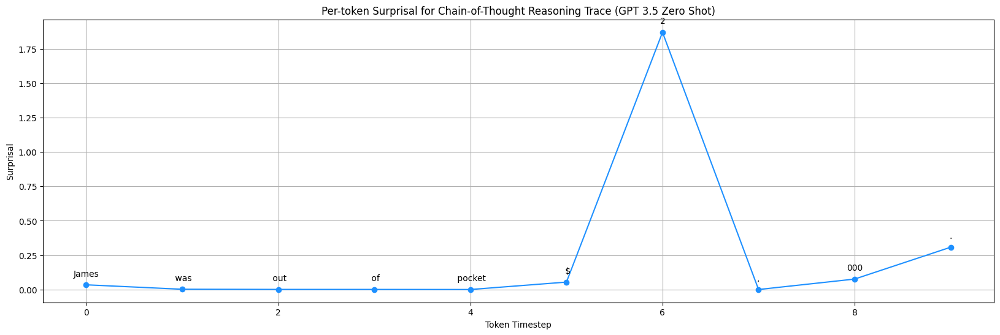

108


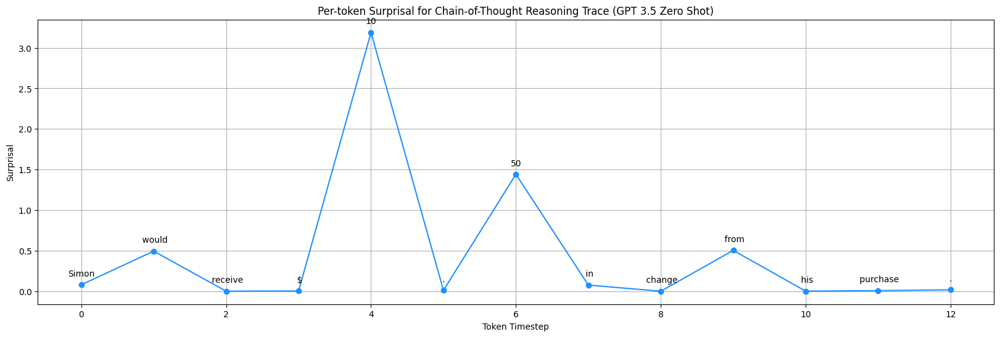

109


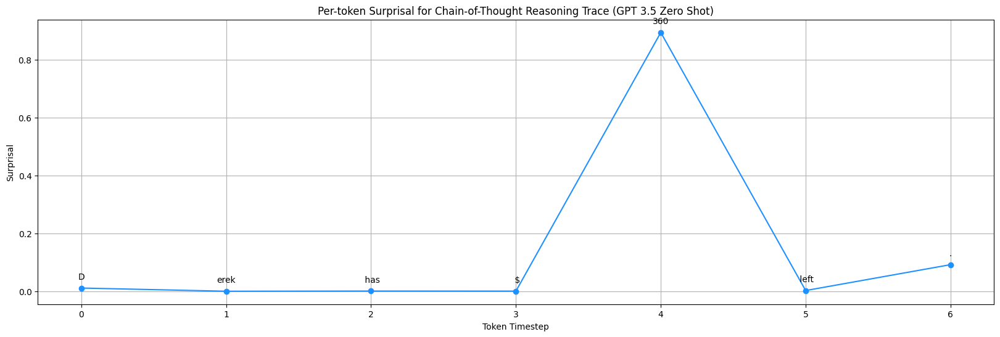

110


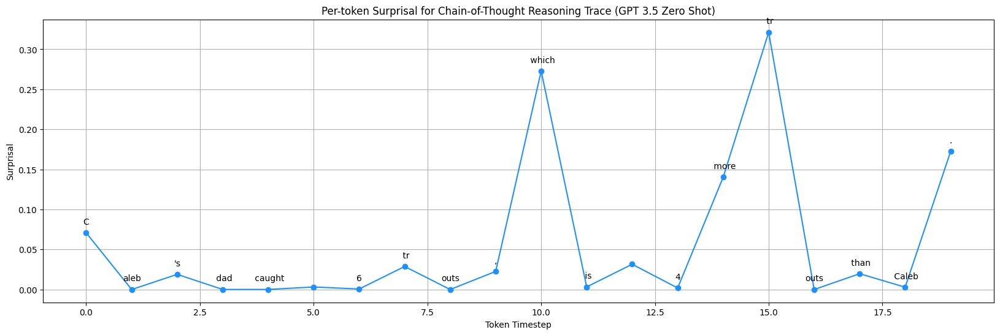

111


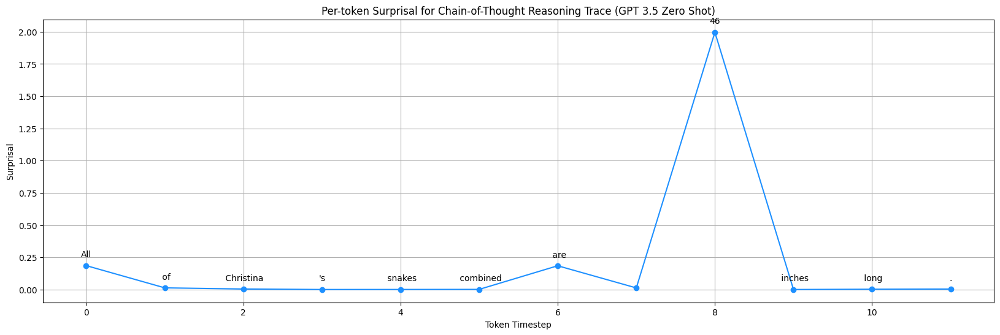

112


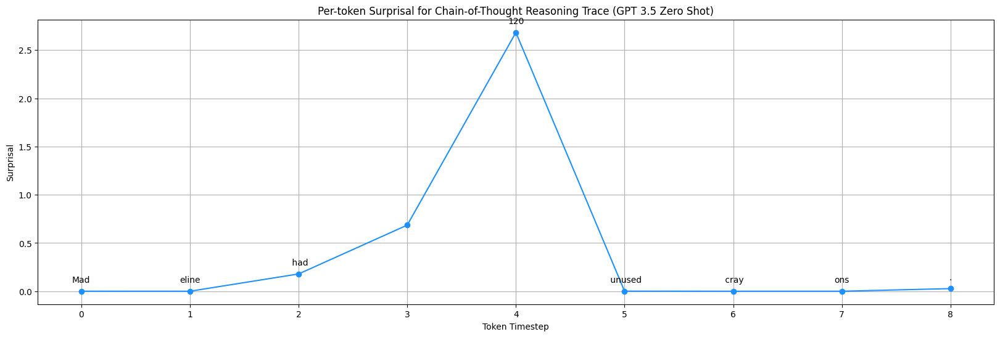

In [65]:
for i in range(len(onesent_df[:10])):
    print(i)
    plot_tokenLevelLogProbs(onesent_df['onesent_logprobs'].tolist()[i], onesent_df['onesent_tokens'].tolist()[i])

In [74]:
# def plot_last_sentence_comparison(cot_logprobs, cot_tokens, onesent_logprobs, onesent_tokens, color_cot='green', color_onesent='dodgerblue'):
#     # Extract the last sentence for CoT Response
#     last_cot_sentence_tokens = cot_tokens[-1].split()  # Assuming the last element in cot_tokens is the last sentence
#     last_cot_sentence_logprobs = cot_logprobs[-len(last_cot_sentence_tokens):]
    
#     # Convert log probabilities to negative for surprisal
#     negative_cot_logprobs = [-x for x in last_cot_sentence_logprobs]
#     negative_onesent_logprobs = [-x for x in onesent_logprobs]
    
#     # Plot settings
#     plt.figure(figsize=(10, 6))
    
#     # Plot for the last sentence of CoT Response
#     plt.plot(negative_cot_logprobs, marker='o', linestyle='-', color=color_cot, label='Last Sentence of CoT Response')
    
#     # Plot for the One Sentence Response
#     plt.plot(negative_onesent_logprobs, marker='o', linestyle='-', color=color_onesent, label='One Sentence Response')
    
#     plt.xlabel("Token Timestep")
#     plt.ylabel("Surprisal")
#     plt.title("Comparison of Last Sentence of CoT Response and One Sentence Response")
#     plt.legend()
#     plt.grid(True)
#     plt.show()

# # Example usage
# i = 0  # Index of the row you want to visualize
# cot_response = onesent_df['CoT Response 2'].tolist()[i]
# onesent_response = onesent_df['One Sentence Response'].tolist()[i]

# # Assuming the last sentence is the last element after splitting by period or newline
# last_sentence_cot = cot_response.split('.')[-1] if '.' in cot_response else cot_response.split('\n')[-1]
# last_sentence_cot = last_sentence_cot.strip()

# # Tokenize and get log probabilities for the last sentence of CoT Response
# # This is a simplified approach; you might need to adjust based on how you stored tokens and logprobs
# last_sentence_cot_tokens = last_sentence_cot.split()  # Simplified tokenization
# last_sentence_cot_logprobs = onesent_df['logprobs'].tolist()[i][-len(last_sentence_cot_tokens):]  # Assuming the logprobs are aligned with tokens

# # Get tokens and log probabilities for the One Sentence Response
# onesent_tokens = onesent_df['onesent_tokens'].tolist()[i]
# onesent_logprobs = onesent_df['onesent_logprobs'].tolist()[i]

# # Plot
# plot_last_sentence_comparison(last_sentence_cot_logprobs, last_sentence_cot_tokens, onesent_logprobs, onesent_tokens)

IndexError: list index out of range

In [76]:
def plot_tokenLevelLogProbs_comparison(logProbs_list, tokens_list, labels, colors, stepIndices=None):
    width = 20
    plt.figure(figsize=(width, 6))

    for logProbs, tokens, label, color in zip(logProbs_list, tokens_list, labels, colors):
        negativeLogProbs = [-x for x in logProbs]
        plt.plot(negativeLogProbs, marker='o', linestyle='-', color=color, label=label)

        for i, token in enumerate(tokens):
            plt.annotate(token, (i, negativeLogProbs[i]), textcoords="offset points", xytext=(0, 10), ha='center')

    if stepIndices is not None:
        for index in stepIndices:
            plt.axvline(x=index, color='r', linestyle=':')

    plt.xlabel("Token Timestep")
    plt.ylabel("Surprisal")
    plt.title("Per-token Surprisal for One Sentence and Last Sentence of CoT")
    plt.grid(True)
    plt.legend()
    plt.show()

In [79]:
onesent_df['CoT Response 2'].tolist()[:3]

['In April, Natalia sold clips to 48 friends. \nIn May, she sold half as many clips as in April. \nSo, in May, she sold 48/2 = 24 clips. \nTo find the total number of clips sold in April and May, we add the number of clips sold in each month: \n48 + 24 = 72. \nTherefore, Natalia sold a total of 72 clips in April and May.',
 'First, we need to convert the 50 minutes into hours. Since there are 60 minutes in an hour, we divide 50 by 60 to get 0.83 hours.\n\nNext, we multiply the number of hours (0.83) by the hourly rate ($12) to find the total earnings. \n\n0.83 hours * $12/hour = $9.96\n\nTherefore, Weng earned $9.96 for 50 minutes of babysitting.',
 "First, let's calculate how much money Betty has saved so far. We know that she has only half of the money she needs, so half of $100 is $50.\n\nNext, let's calculate how much money Betty's grandparents gave her. We know that her grandparents gave her twice as much as her parents, so $15 x 2 = $30.\n\nNow, let's add up all the money Betty h

In [84]:
onesent_df['tokens'].tolist()[0]

['In',
 ' April',
 ',',
 ' Natal',
 'ia',
 ' sold',
 ' clips',
 ' to',
 ' ',
 '48',
 ' friends',
 '.',
 ' \n',
 'In',
 ' May',
 ',',
 ' she',
 ' sold',
 ' half',
 ' as',
 ' many',
 ' clips',
 ' as',
 ' in',
 ' April',
 '.',
 ' \n',
 'So',
 ',',
 ' in',
 ' May',
 ',',
 ' she',
 ' sold',
 ' ',
 '48',
 '/',
 '2',
 ' =',
 ' ',
 '24',
 ' clips',
 '.',
 ' \n',
 'To',
 ' find',
 ' the',
 ' total',
 ' number',
 ' of',
 ' clips',
 ' sold',
 ' in',
 ' April',
 ' and',
 ' May',
 ',',
 ' we',
 ' add',
 ' the',
 ' number',
 ' of',
 ' clips',
 ' sold',
 ' in',
 ' each',
 ' month',
 ':',
 ' \n',
 '48',
 ' +',
 ' ',
 '24',
 ' =',
 ' ',
 '72',
 '.',
 ' \n',
 'Therefore',
 ',',
 ' Natal',
 'ia',
 ' sold',
 ' a',
 ' total',
 ' of',
 ' ',
 '72',
 ' clips',
 ' in',
 ' April',
 ' and',
 ' May',
 '.']

Problem Number:  13
GPT One Sentence Answer:  It will take Joy 3 hours to read 120 pages.
-------------------------------
GPT CoT Answer:  First ,  let 's  find  out  how  many  pages  Joy  can  read  in   1  minute .  We  can  do  this  by  dividing  the  number  of  pages  she  can  read  in   20  minutes  by   20 .  So ,   8  pages  /   20  minutes  =   0 . 4  pages  per  minute .

 Next ,  let 's  find  out  how  many  minutes  it  will  take  Joy  to  read   120  pages .  We  can  do  this  by  dividing   120  pages  by   0 . 4  pages  per  minute .  So ,   120  pages  /   0 . 4  pages  per  minute  =   300  minutes .

 Finally ,  let 's  convert  the  minutes  to  hours .  There  are   60  minutes  in   1  hour ,  so   300  minutes  /   60  minutes  per  hour  =   5  hours .

 Therefore ,  it  will  take  Joy   5  hours  to  read   120  pages .
-------------------------------
Correct Answer:  In one hour, there are 3 sets of 20 minutes.
So, Joy can read 8 x 3 = <<8*3=24>>24 pages

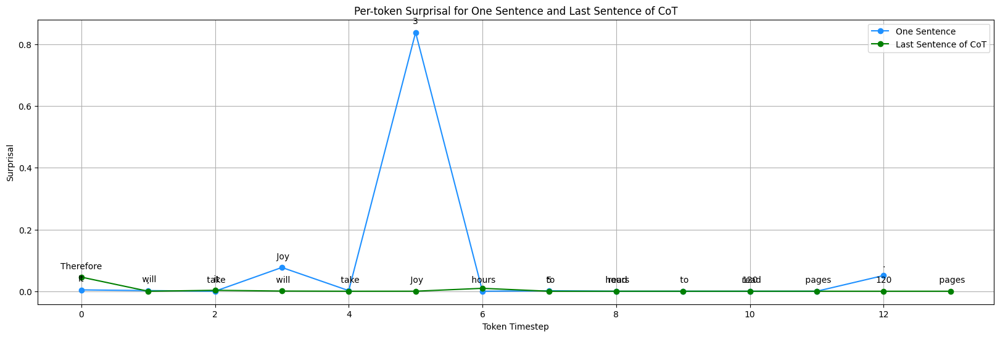

Problem Number:  12
GPT One Sentence Answer:  Jasper spends $10 on cheddar cheese, $5 on cream cheese, and $20 on cold cuts, for a total of $35 on the ingredients.
-------------------------------
GPT CoT Answer:  First ,  let 's  calculate  the  cost  of  the  cream  cheese .  Since  it  costs  half  the  price  of  the  ch eddar  cheese ,  it  would  be  $ 10  /   2  =  $ << 10 / 2 = 5 >> 5 .

 Next ,  let 's  calculate  the  cost  of  the  cold  cuts .  Since  it  costs  twice  the  price  of  the  ch eddar  cheese ,  it  would  be  $ 10  x   2  =  $ << 10 * 2 = 20 >> 20 .

 Now ,  let 's  add  up  the  cost  of  all  the  ingredients .  The  ch eddar  cheese  costs  $ 10 ,  the  cream  cheese  costs  $ 5 ,  and  the  cold  cuts  cost  $ 20 .  So ,  Jasper  spends  a  total  of  $ 10  +  $ 5  +  $ 20  =  $ << 10 + 5 + 20 = 35 >> 35  on  the  ingredients .
-------------------------------
Correct Answer:  A pound of cream cheese cost $10 / 2 = $<<10/2=5>>5.
A pack of cold cuts cost $10

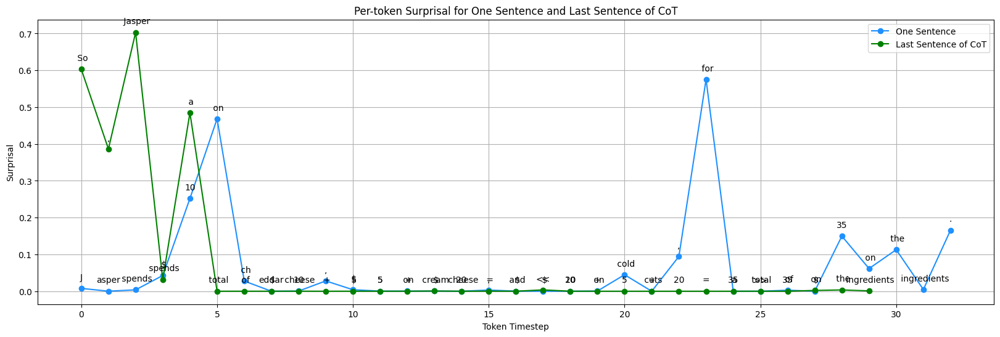

Problem Number:  62
GPT One Sentence Answer:  Janice started with 589 sentences today.
-------------------------------
GPT CoT Answer:  First ,  let 's  calculate  how  many  sentences  Jan ice  typed  in  the  first   20  minutes .  Since  she  can  type   6  sentences  per  minute ,  in   20  minutes  she  typed   20  *   6  =   120  sentences .

 Next ,  let 's  calculate  how  many  sentences  Jan ice  typed  in  the  additional   15  minutes .  Again ,  since  she  can  type   6  sentences  per  minute ,  in   15  minutes  she  typed   15  *   6  =   90  sentences .

 Now ,  let 's  subtract  the   40  sentences  she  had  to  erase .  After  er asing ,  she  had   120  +   90  -   40  =   170  sentences .

 After  the  meeting ,  she  typed  for  an  additional   18  minutes ,  so  she  typed   18  *   6  =   108  sentences .

 In  total ,  by  the  end  of  today ,  she  had   170  +   108  =   278  sentences .

 Since  the  paper  had   536  sentences  by  the  end  of  today ,

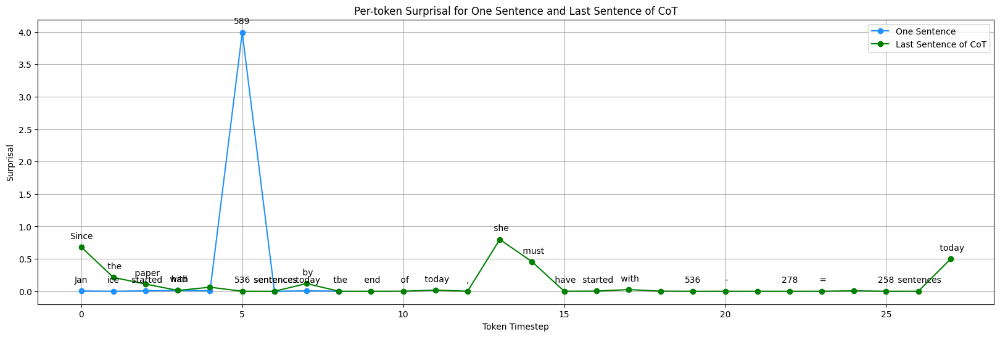

Problem Number:  83
GPT One Sentence Answer:  A total of 186 kids got into the movie.
-------------------------------
GPT CoT Answer:  First ,  let 's  calculate  how  many  kids  from  Riverside  High  were  denied  entry .  We  can  do  this  by  multiplying  the  total  number  of  kids  from  Riverside  High  ( 120 )  by  the  percentage  denied  ( 20 % ):

 120  *   0 . 20  =   24 

 So ,   24  kids  from  Riverside  High  were  denied  entry .

 Next ,  let 's  calculate  how  many  kids  from  West  Side  High  were  denied  entry .  We  can  do  this  by  multiplying  the  total  number  of  kids  from  West  Side  High  ( 90 )  by  the  percentage  denied  ( 70 % ):

 90  *   0 . 70  =   63 

 So ,   63  kids  from  West  Side  High  were  denied  entry .

 Finally ,  let 's  calculate  how  many  kids  from  Mount aint op  High  were  denied  entry .  We  can  do  this  by  multiplying  the  total  number  of  kids  from  Mount aint op  High  ( 50 )  by  the  percentage  deni

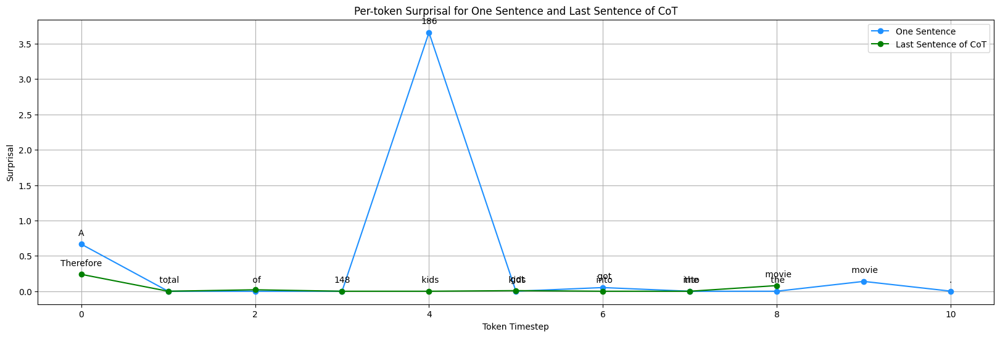

Problem Number:  45
GPT One Sentence Answer:  Their combined experience is 70 years.
-------------------------------
GPT CoT Answer:  First ,  we  need  to  find  out  how  long  James '  partner  has  been  teaching .  We  know  that  James  has  been  teaching  for   40  years .  So ,  if  his  partner  has  been  teaching  for   10  years  less ,  then  their  combined  experience  would  be   40  -   10  =   30  years .
-------------------------------
Correct Answer:  His partner has been teaching for 40-10=<<40-10=30>>30 years
So together they have 40+30=<<40+30=70>>70 years of experience
#### 70
Last sentence end index: 27


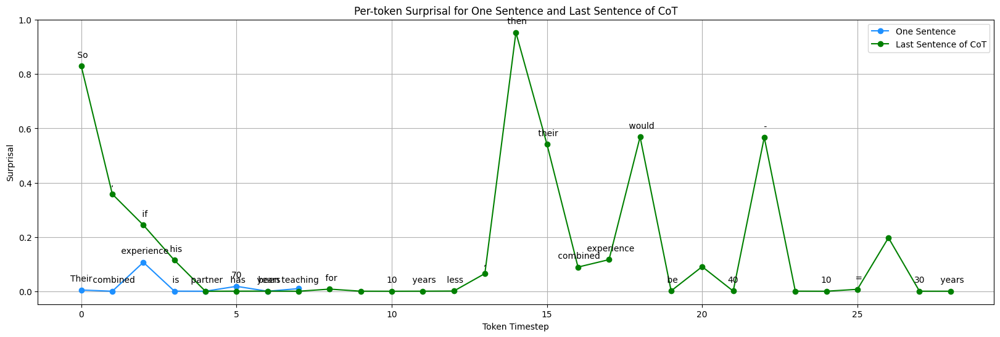

Problem Number:  107
GPT One Sentence Answer:  James was out of pocket $2,000.
-------------------------------
GPT CoT Answer:  First ,  let 's  calculate  how  much  James  sold  his  car  for .  He  sold  his  $ 20 , 000  car  for   80 %  of  its  value ,  so  the  amount  he  received  from  the  sale  is   20 , 000  *   0 . 8  =  $ 16 , 000 .

 Next ,  let 's  calculate  how  much  James  paid  for  the  new  car .  He  was  able  to  buy  a  $ 30 , 000  sticker  price  car  for   90 %  of  its  value ,  so  the  amount  he  paid  is   30 , 000  *   0 . 9  =  $ 27 , 000 .

 To  find  out  how  much  James  was  out  of  pocket ,  we  need  to  subtract  the  amount  he  received  from  the  sale  from  the  amount  he  paid  for  the  new  car .  So ,  James  was  out  of  pocket  by   27 , 000  -   16 , 000  =  $ 11 , 000 .
-------------------------------
Correct Answer:  He sold his car for 20000*.8=$<<20000*.8=16000>>16,000
He bought the new car for 30,000*.9=$<<30000*.9=27000>>

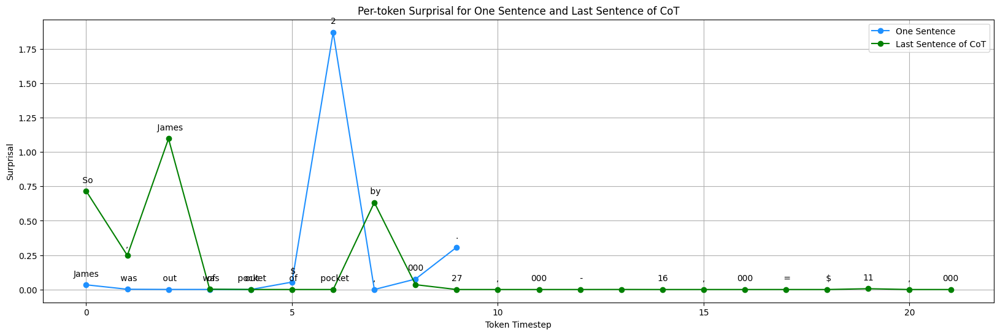

Problem Number:  26
GPT One Sentence Answer:  The unicorn piñata and the treats cost $13 + ($9 x 4) + ($5 x 3) + ($7 x 5) = $13 + $36 + $15 + $35 = $99 altogether.
-------------------------------
GPT CoT Answer:  First ,  let 's  calculate  the  cost  of  the  Reese 's  bags .  They  bought   4  bags  at  $ 9  per  bag ,  so  the  total  cost  of  the  Reese 's  bags  is   4  *  $ 9  =  $ << 4 * 9 = 36 >> 36 .
 Next ,  let 's  calculate  the  cost  of  the  Sn ickers  bags .  They  bought   3  bags  at  $ 5  per  bag ,  so  the  total  cost  of  the  Sn ickers  bags  is   3  *  $ 5  =  $ << 3 * 5 = 15 >> 15 .
 Finally ,  let 's  calculate  the  cost  of  the  Sk itt les  bags .  They  bought   5  bags  at  $ 7  per  bag ,  so  the  total  cost  of  the  Sk itt les  bags  is   5  *  $ 7  =  $ << 5 * 7 = 35 >> 35 .
 Now ,  let 's  add  up  the  cost  of  the  unicorn  pi ñ ata  and  the  treats .  The  unicorn  pi ñ ata  cost  $ 13 ,  the  Reese 's  bags  cost  $ 36 ,  the  Sn ickers  ba

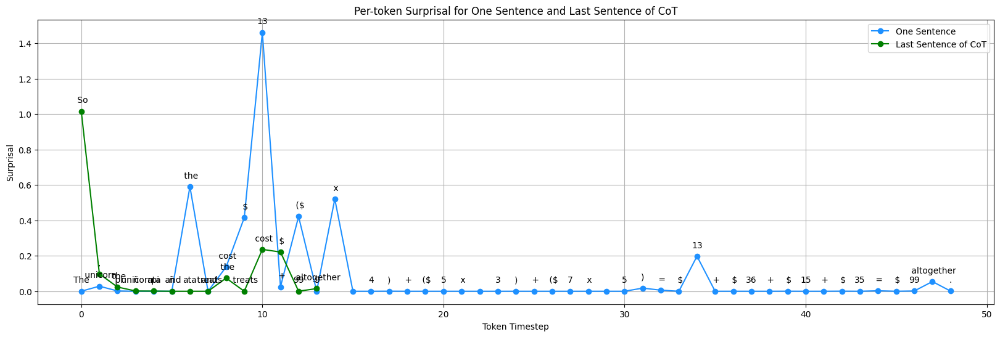

Problem Number:  41
GPT One Sentence Answer:  The animals Carly collected have a total of 49 arms.
-------------------------------
GPT CoT Answer:  First ,  let 's  calculate  the  total  number  of  arms  from  the  star fish .  Carly  collected   7  star fish  with   5  arms  each ,  so  the  total  number  of  arms  from  the  star fish  is   7  *   5  =   35  arms .

 Next ,  let 's  calculate  the  number  of  arms  from  the  se ast ar .  Carly  collected  one  se ast ar  with   14  arms .

 Finally ,  let 's  add  the  number  of  arms  from  the  star fish  and  the  se ast ar  together .   35  arms  +   14  arms  =   49  arms .

 Therefore ,  Carly  collected  a  total  of   49  arms  from  the  animals  she  collected .
-------------------------------
Correct Answer:  First find the total number of starfish arms: 7 starfish * 5 arms/starfish = <<7*5=35>>35 arms
Then add the number of seastar arms to find the total number of arms: 35 arms + 14 arms = <<35+14=49>>49 arms
#### 4

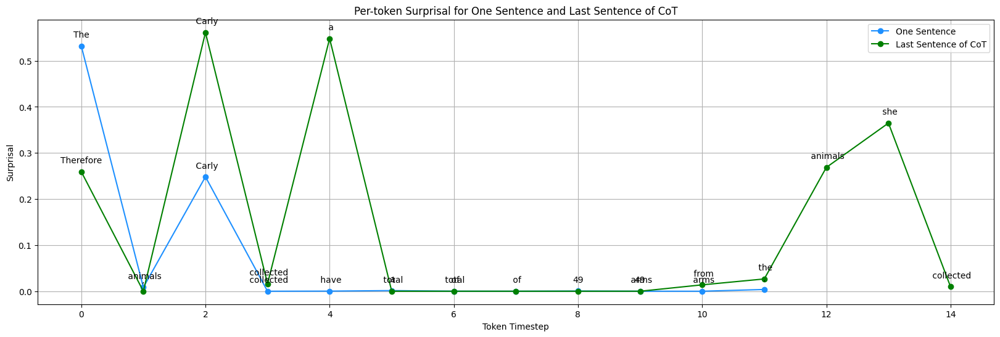

Problem Number:  5
GPT One Sentence Answer:  Mark has 47 flowers in his garden.
-------------------------------
GPT CoT Answer:  First ,  let 's  find  out  how  many  purple  flowers  Mark  has .  We  know  that  there  are   80 %  more  purple  flowers  than  yellow  flowers ,  so  we  can  calculate  this  by  multiplying  the  number  of  yellow  flowers  by   1 . 8 :   10  yellow  flowers  *   1 . 8  =   18  purple  flowers .

 Next ,  let 's  find  out  how  many  green  flowers  Mark  has .  We  know  that  there  are  only   25 %  as  many  green  flowers  as  there  are  yellow  and  purple  flowers ,  so  we  can  calculate  this  by  multiplying  the  total  number  of  yellow  and  purple  flowers  by   0 . 25 :  ( 10  yellow  flowers  +   18  purple  flowers )  *   0 . 25  =   7  green  flowers .

 Finally ,  let 's  calculate  the  total  number  of  flowers  in  Mark 's  garden  by  adding  up  the  number  of  yellow ,  purple ,  and  green  flowers :   10  yellow  flow

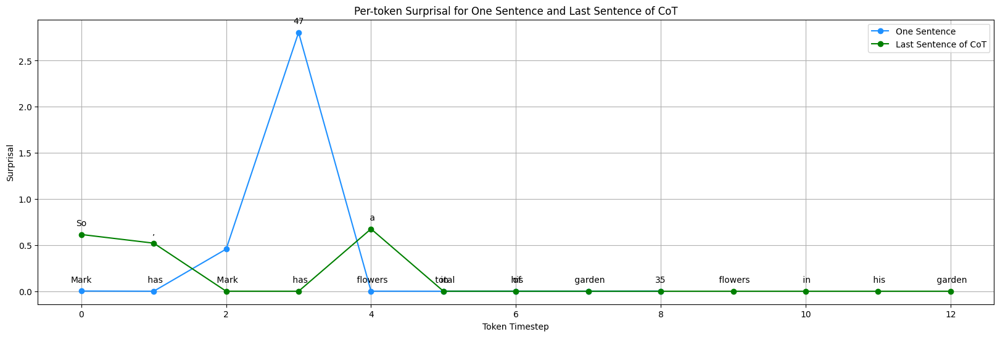

Problem Number:  35
GPT One Sentence Answer:  After the fourth hour, Joanne had 85 coins.
-------------------------------
GPT CoT Answer:  In  the  first  hour ,  Jo anne  collected   15  coins .
 In  the  next  two  hours ,  she  collected   35  coins  each ,  so  a  total  of   35  +   35  =   70  coins .
 In  the  fourth  hour ,  she  collected   50  coins  but  gave  away   15 ,  so  she  kept   50  -   15  =   35  coins .
 To  find  the  total  number  of  coins  she  had  after  the  fourth  hour ,  we  add  up  the  coins  from  each  hour :   15  +   70  +   35  =   120  coins .
 Therefore ,  Jo anne  had   120  coins  after  the  fourth  hour .
-------------------------------
Correct Answer:  15 coins collected in hour one
35 coins collected in hour two
35 coins collected in hour three
50 coins collected in hour four
Before giving her coworker some coins there were 15+35+35+50=<<15+35+35+50=135>>135 coins
The number of coins after given 15 to her coworker is 135-15=<<135-15=12

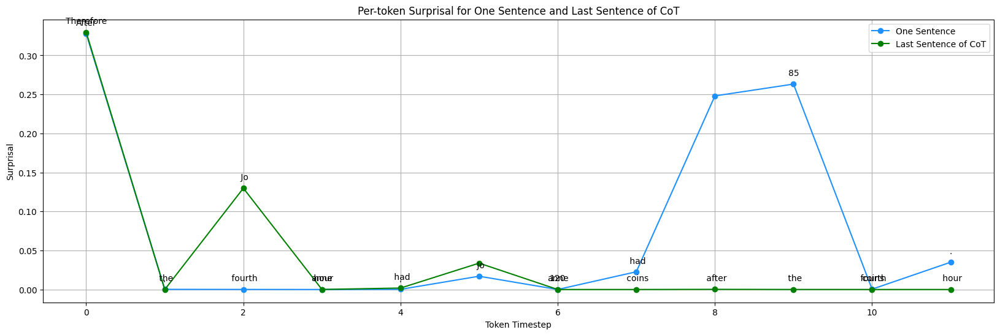

Problem Number:  42
GPT One Sentence Answer:  Hillary is left with 24 dollars after making the deposit.
-------------------------------
GPT CoT Answer:  First ,  let 's  calculate  how  much  money  Hillary  made  from  selling  crafts .  She  sold   3  crafts  for  $ 12  each ,  so  she  made   3  *  $ 12  =  $ << 3 * 12 = 36 >> 36  from  selling  crafts .

 Next ,  let 's  add  the  extra  $ 7  she  received  from  the  apprec iative  customer .  So  far ,  Hillary  has  $ 36  +  $ 7  =  $ << 36 + 7 = 43 >> 43 .

 Now ,  let 's  subtract  the  $ 18  she  deposited  into  her  bank  account .  Hillary  is  left  with  $ 43  -  $ 18  =  $ << 43 - 18 = 25 >> 25 .

 Therefore ,  Hillary  is  left  with  $ 25  after  making  the  deposit .
-------------------------------
Correct Answer:  Hillary sells 3 crafts for 12 dollars each, for a total of 3 crafts * $12/craft = $<<3*12=36>>36
She receives an extra 7 dollars from a customer, increasing the total to $36 + $7 = $<<36+7=43>>43
She then

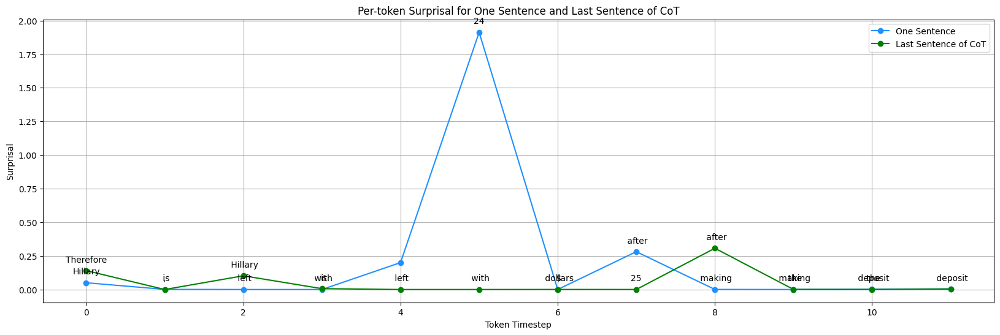

Problem Number:  97
GPT One Sentence Answer:  James beat the old record by 114 points.
-------------------------------
GPT CoT Answer:  First ,  let 's  calculate  the  number  of  points  James  scores  per  game .  He  scores   4  touchdowns  per  game ,  and  each  touchdown  is  worth   6  points ,  so  he  scores   4  *   6  =   24  points  per  game .

 Next ,  let 's  calculate  the  total  number  of  points  James  scores  in  the  season .  There  are   15  games  in  the  season ,  so  he  scores   15  *   24  =   360  points  from  touchdowns .

 In  addition  to  touchdowns ,  James  also  scores   2  point  conversions   6  times  during  the  season .  Each   2  point  conversion  is  worth   2  points ,  so  he  scores   6  *   2  =   12  points  from   2  point  conversions .

 Therefore ,  James  scores  a  total  of   360  +   12  =   372  points  in  the  season .

 Finally ,  let 's  calculate  how  many  points  James  beat  the  old  record  by .  The  old  recor

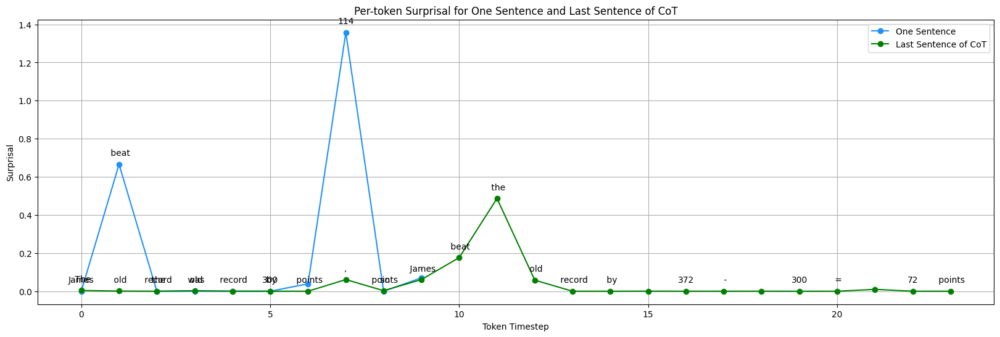

Problem Number:  84
GPT One Sentence Answer:  Larry spends 60 minutes walking and playing with his dog each day, and 12 minutes feeding his dog, for a total of 72 minutes.
-------------------------------
GPT CoT Answer:  First ,  let 's  calculate  how  many  minutes  Larry  spends  walking  and  playing  with  his  dog  each  day .  Since  he  spends  half  an  hour  twice  a  day ,  we  can  multiply  half  an  hour  by   2  to  get  the  total  time  spent  walking  and  playing :   0 . 5  hours  *   2  =   1  hour .

 Since  there  are   60  minutes  in  an  hour ,  Larry  spends   1  hour  *   60  minutes  =   60  minutes  walking  and  playing  with  his  dog  each  day .

 Next ,  let 's  calculate  how  many  minutes  Larry  spends  feeding  his  dog  each  day .  Since  he  spends  a  fifth  of  an  hour  feeding  his  dog ,  we  can  multiply  a  fifth  of  an  hour  by   60  minutes  to  get  the  total  time  spent  feeding :  ( 1 / 5 )  *   60  minutes  =   12  minutes .



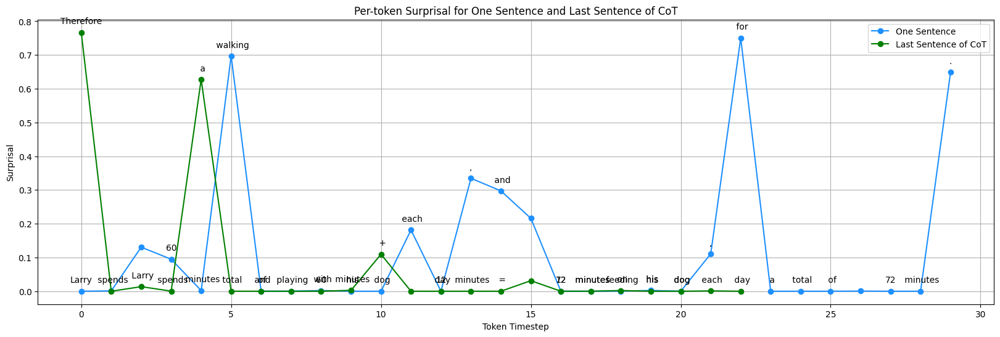

Problem Number:  54
GPT One Sentence Answer:  The beef cost $8,000 and the chicken cost $6,000, so everything cost $14,000.
-------------------------------
GPT CoT Answer:  First ,  let 's  calculate  the  cost  of  the  beef .  John  ordered   100 0  pounds  of  beef  at  $ 8  per  pound ,  so  the  cost  of  the  beef  is   100 0  *  $ 8  =  $ << 100 0 * 8 = 800 0 >> 800 0 .

 Next ,  let 's  calculate  the  cost  of  the  chicken .  John  ordered  twice  as  much  chicken  as  beef ,  so  he  ordered   2  *   100 0  =   200 0  pounds  of  chicken .
 The  cost  of  the  chicken  is   200 0  *  $ 3  =  $ << 200 0 * 3 = 600 0 >> 600 0 .

 Finally ,  let 's  calculate  the  total  cost .  The  cost  of  the  beef  is  $ 800 0  and  the  cost  of  the  chicken  is  $ 600 0 ,  so  the  total  cost  is  $ 800 0  +  $ 600 0  =  $ << 800 0 + 600 0 = 140 00 >> 140 00 .

 Therefore ,  everything  cost  $ 140 00 .
-------------------------------
Correct Answer:  The beef cost $8 * 1000 = $<<8*1

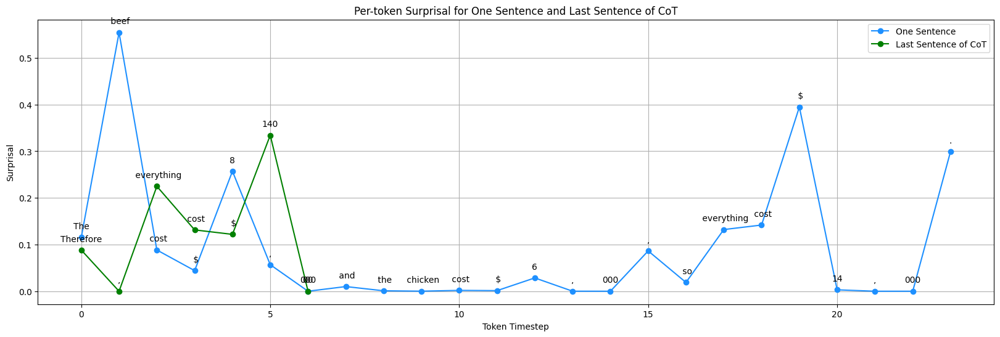

Problem Number:  25
GPT One Sentence Answer:  James spends 30% + 15% + 25% = 70% of his money on food, accommodation, and entertainment.
Therefore, he spends 100% - 70% = 30% of his money on coursework materials.
So, he spends $1000 x 30% = $<<1000*30*.01=300>>300 on coursework materials.
-------------------------------
GPT CoT Answer:  First ,  let 's  calculate  how  much  money  James  spends  on  food .   30 %  of  $ 100 0  is  ( 30 / 100 )  *  $ 100 0  =  $ 300 .

 Next ,  let 's  calculate  how  much  money  James  spends  on  accommodation .   15 %  of  $ 100 0  is  ( 15 / 100 )  *  $ 100 0  =  $ 150 .

 Then ,  let 's  calculate  how  much  money  James  spends  on  entertainment .   25 %  of  $ 100 0  is  ( 25 / 100 )  *  $ 100 0  =  $ 250 .

 Now ,  let 's  calculate  how  much  money  James  has  spent  so  far .  $ 300  +  $ 150  +  $ 250  =  $ 700 .

 Finally ,  let 's  calculate  how  much  money  James  spends  on  coursework  materials .  Since  he  has  a  budget  of  

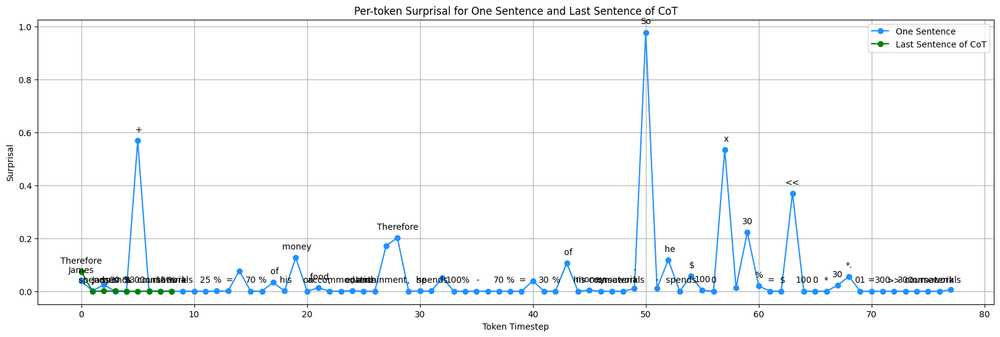

Problem Number:  16
GPT One Sentence Answer:  Bella bought a total of 11 snowflake stamps + (11 snowflake stamps + 9 truck stamps) + (11 snowflake stamps + 9 truck stamps - 13 rose stamps) = 11 + 20 + 16 = <<11+20+16=47>>47 stamps.
-------------------------------
GPT CoT Answer:  First ,  we  know  that  Bella  bought   11  snow flake  stamps .  

 Next ,  we  know  that  she  bought   9  more  truck  stamps  than  snow flake  stamps .  So ,  the  number  of  truck  stamps  she  bought  is   11  +   9  =   20 .

 Finally ,  we  know  that  she  bought   13  fewer  rose  stamps  than  truck  stamps .  So ,  the  number  of  rose  stamps  she  bought  is   20  -   13  =   7 .

 To  find  the  total  number  of  stamps  Bella  bought ,  we  add  up  the  number  of  snow flake ,  truck ,  and  rose  stamps :   11  +   20  +   7  =   38 .

 Therefore ,  Bella  bought  a  total  of   38  stamps .
-------------------------------
Correct Answer:  The number of truck stamps is 11 + 9 = <<11+9=

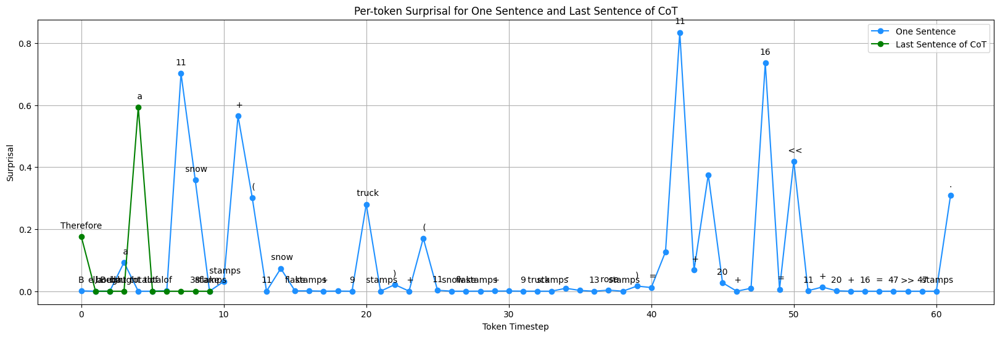

Problem Number:  87
GPT One Sentence Answer:  Winwin was able to take home $35.
-------------------------------
GPT CoT Answer:  First ,  let 's  calculate  the  amount  Win win  paid  for  the  tax .  To  find   20 %  of  $ 50 ,  we  multiply  $ 50  by   0 . 20 :

 $ 50  x   0 . 20  =  $ 10 

 So ,  Win win  paid  $ 10  for  the  tax .

 Next ,  let 's  calculate  the  total  deductions .  Win win  paid  $ 10  for  the  tax  and  $ 5  for  the  processing  fee :

 $ 10  +  $ 5  =  $ 15 

 Therefore ,  Win win 's  total  deductions  amount  to  $ 15 .

 To  find  out  how  much  she  was  able  to  take  home ,  we  subtract  the  total  deductions  from  the  original  amount  she  won :

 $ 50  -  $ 15  =  $ 35 

 So ,  Win win  was  able  to  take  home  $ 35 .
-------------------------------
Correct Answer:  Winwin paid $50 x 20/100 = $<<50*20/100=10>>10 for the tax.
So, she has $50 - $10 = <<50-10=40>>40 after paying the tax.
Therefore, Winwin was able to take home $40 - $5 = $<<4

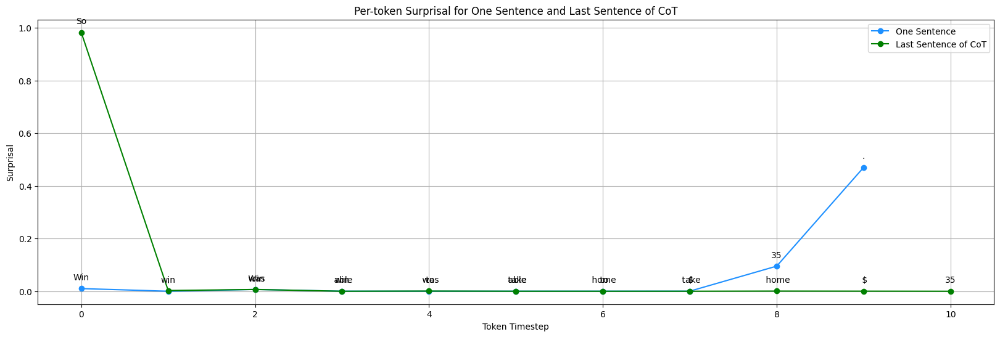

Problem Number:  67
GPT One Sentence Answer:  Baez ends up with 30 marbles.
-------------------------------
GPT CoT Answer:  First ,  let 's  calculate  how  many  mar bles  B ae z  loses .  She  has   25  mar bles ,  and  she  loses   20 %  of  them .  To  find  out  how  many  mar bles  she  loses ,  we  can  multiply   25  by   20 %  ( or   0 . 20 ).

 25  *   0 . 20  =   5 

 So  B ae z  loses   5  mar bles .

 Next ,  let 's  calculate  how  many  mar bles  B ae z  has  left  after  losing   5 .  We  can  subtract   5  from   25 .

 25  -   5  =   20 

 So  B ae z  has   20  mar bles  left .

 Finally ,  let 's  calculate  how  many  mar bles  B ae z  ends  up  with  after  her  friend  gives  her  double  the  amount  she  has  left .  Her  friend  gives  her   20  *   2  =   40  mar bles .

 So  B ae z  ends  up  with   20  +   40  =   60  mar bles .
-------------------------------
Correct Answer:  She loses 5 marbles because 25 x .2 = <<25*.2=5>>5
She has 20 marbles after this 

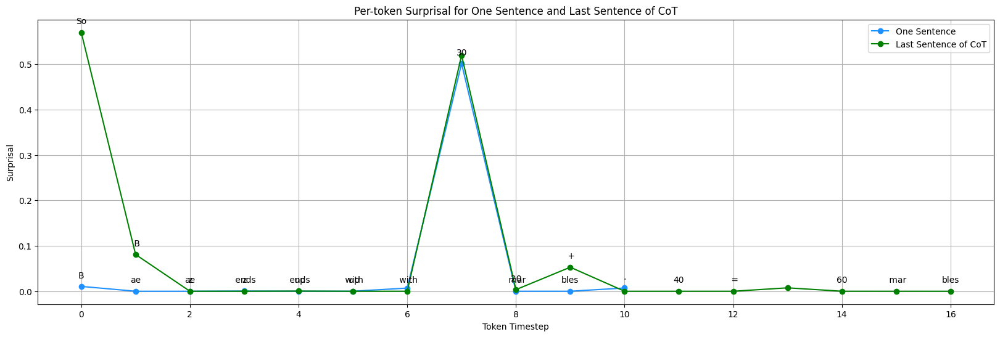

Problem Number:  66
GPT One Sentence Answer:  On the first day, they took 400/2 = <<400/2=200>>200 photos.
On the second day, they took 200+120 = <<200+120=320>>320 photos.
The total number of photos they took on the two-day trip is 320+200 = <<320+200=520>>520 photos.
If they added all these photos to the family gallery, the total number of photos in the gallery is 520+400 = <<520+400=920>>920 photos. Answer: \boxed{920}.
-------------------------------
GPT CoT Answer:  First ,  let 's  find  out  how  many  photos  they  took  on  the  first  day  of  their  trip .  We  know  that  they  took  half  as  many  photos  as  they  have  in  the  family  gallery ,  which  is   400  photos .  So ,  on  the  first  day ,  they  took   400  /   2  =   200  photos .

 Next ,  let 's  find  out  how  many  photos  they  took  on  the  second  day .  We  know  that  they  took   120  more  photos  than  they  took  on  the  first  day ,  which  is   200  photos .  So ,  on  the  second  day ,  

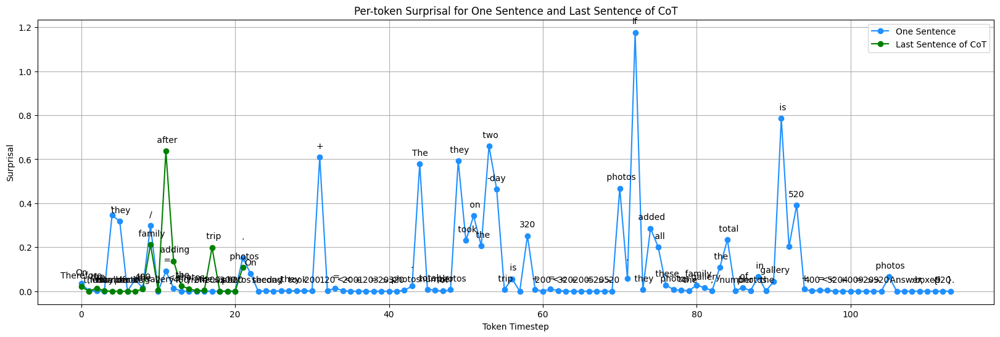

Problem Number:  64
GPT One Sentence Answer:  Henry spent a total of $294 on the pills.
-------------------------------
GPT CoT Answer:  First ,  let 's  calculate  the  cost  of  the   4  pills  that  cost  $ 1 . 50  each .  Since  he  took   9  pills  a  day  for   14  days ,  he  took  a  total  of   9  *   14  =   126  pills .
 Out  of  these   126  pills ,   4  pills  cost  $ 1 . 50  each ,  so  the  cost  of  these   4  pills  is   4  *  $ 1 . 50  =  $ << 4 * 1 . 50 = 6 >> 6 .

 Now ,  let 's  calculate  the  cost  of  the  remaining  pills .  Each  of  these  pills  costs  $ 5 . 50  more  than  the  $ 1 . 50  pills ,  so  each  of  these  pills  costs  $ 1 . 50  +  $ 5 . 50  =  $ << 1 . 50 + 5 . 50 = 7 >> 7 .

 The  number  of  these  remaining  pills  is   126  -   4  =   122 .

 Therefore ,  the  cost  of  these  remaining  pills  is   122  *  $ 7  =  $ << 122 * 7 = 854 >> 854 .

 Finally ,  let 's  calculate  the  total  cost  by  adding  the  cost  of  the  $ 1 . 50  pills  

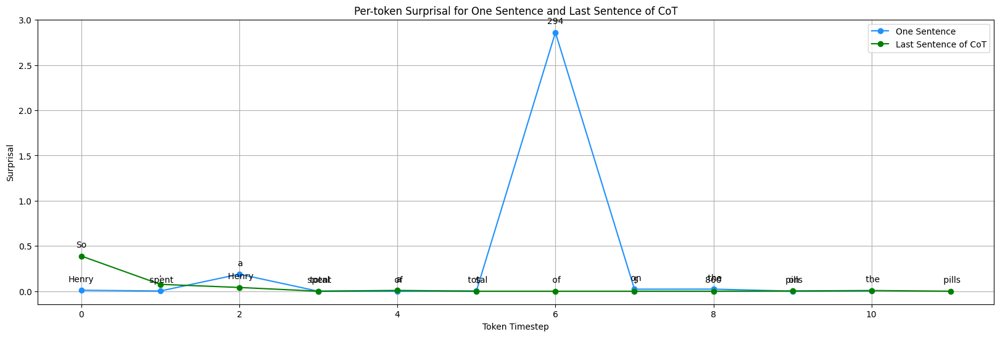

In [92]:
for idx, row in onesent_df.sample(20).iterrows():
    print("Problem Number: ", row['Problem Number'])
    print("GPT One Sentence Answer: ", row['One Sentence Response'])
    print("-------------------------------")
    print("GPT CoT Answer: ", ' '.join(row['tokens']))
    print("-------------------------------")
    print("Correct Answer: ", row['Answer'])

    # Find the index of the second-to-last period or newline token in the CoT Response 2 tokens
    period_indices = [i for i, x in enumerate(row['tokens']) if x == '.']
    newline_indices = [i for i, x in enumerate(row['tokens']) if '\n' in x]
    sentence_end_indices = sorted(period_indices + newline_indices, reverse=True)
    
    if len(sentence_end_indices) >= 2:
        last_sentence_end_index = sentence_end_indices[1]
    else:
        last_sentence_end_index = -1
    
    print("Last sentence end index:", last_sentence_end_index)

    # Extract the last sentence tokens and logprobs from CoT Response 2
    cot_last_sentence_tokens = row['tokens'][last_sentence_end_index + 1:-1]
    cot_last_sentence_logprobs = row['logprobs'][last_sentence_end_index + 1:-1]
    # print("Last sentence tokens:", cot_last_sentence_tokens)
    # print("Last sentence logprobs:", cot_last_sentence_logprobs)

    plot_tokenLevelLogProbs_comparison(
        [row['onesent_logprobs'], cot_last_sentence_logprobs],
        [row['onesent_tokens'], cot_last_sentence_tokens],
        labels=['One Sentence', 'Last Sentence of CoT'],
        colors=['dodgerblue', 'green']
    )